In [1]:
library(ggplot2)
library(scales)
library(dplyr)
library(tidyr)
library(DBI)
library(RSQLite)
library(outreg)

figsize <- function(width, height) {
  options(repr.plot.width=width, repr.plot.height=height)  
}

# change this to your own font if texts are not properly displayed
mytheme <- theme_bw() + 
  theme(
     strip.background=element_blank()
    #,strip.text=element_text(face="bold")
    #,panel.grid.major=element_blank()
    ,panel.grid.minor=element_blank()
    #,text=element_text(family=myfont)
  )
theme_set(mytheme)


ggshow <- function(g=last_plot(), dispwidth=600, dispheight=NULL, tmpdir="ggtmp", ...) {
  # show ggplot graph
  # a quick workaround to the issue where
  # Japanese texts are not displayed on the notebook
  if (!dir.exists(tmpdir)) {
    if (file.exists(tmpdir)) {
      stop(sprintf("'%s' already exists as a file.", tmpdir))
    }
    dir.create(tmpdir, recursive=TRUE)
  }
  
  tmpfile <- file.path(tmpdir, sprintf("%s.jpg", Sys.time() %>% as.integer()))
  message("saved to ", tmpfile)
  ggplot2::ggsave(tmpfile, g, ...)
  IRdisplay::display_jpeg(file=tmpfile, width=dispwidth, height=dispheight)
  #arg <- c(sprintf('src="%s"', tmpfile))
  #if (!is.null(dispwidth)) arg <- c(arg, sprintf('width="%s"', dispwidth))  
  #if (!is.null(dispheight)) arg <- c(arg, sprintf('height="%s"', dispheight))  
  #mddata <- sprintf('<img %s>', paste(arg, collapse=" "))
  #print(mddata)
  #IRdisplay::display_markdown(mddata)
}



query_getter <- function(dbfile) {
  function(query) {
    con <- dbConnect(SQLite(), dbfile)
    on.exit(dbDisconnect(con))
    dbGetQuery(con, query)
  }
}

mhlw <- query_getter("db/mhlw_prompt.db")
npa <- query_getter("db/npa_prompt.db")

if (!dir.exists("outputs")) dir.create("outputs")


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [2]:
# test
npa("select * from a5_age limit 3")
mhlw("select * from prompt limit 3")

time,geocode,geoname,geoname2,timedef,locdef,sex,age,n_suicide
<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>
2009-01,0,全国,NA,dead,residence,total,20歳未満,45
2009-01,1,NA,北海道,dead,residence,total,20歳未満,4
2009-01,2,NA,青森県,dead,residence,total,20歳未満,0


time,geocode,geoname,sex,cause,age,n_death
<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<dbl>
2016-01,NA,北海道,male,自殺,00-04,0
2016-01,NA,北海道,female,自殺,00-04,0
2016-01,NA,青森県,male,自殺,00-04,0


# Monthly trend

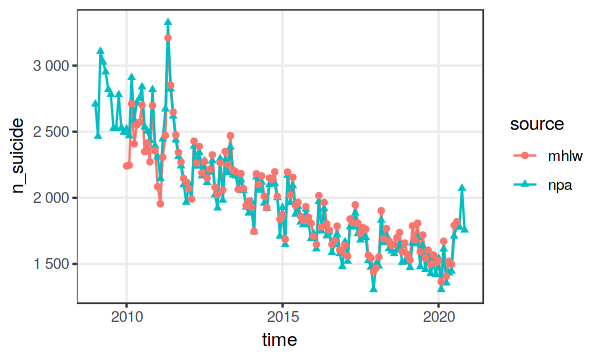

Warning message:
“Removed 15 rows containing missing values (geom_point).”

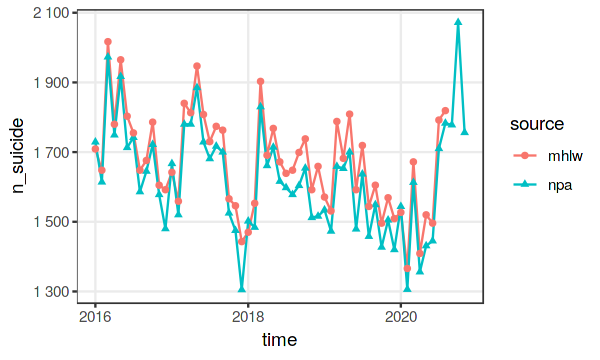

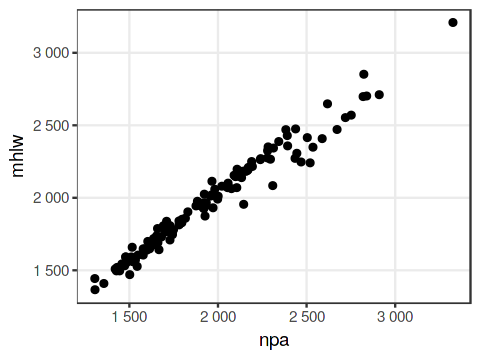

In [3]:
x <- npa("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time
  ,sum(n_suicide) as n_suicide
from
  a5_age
where 
  geocode=0 and sex='total'
  --and year > 2015
group by
  time
order by
  time
") %>%
  mutate(time=as.Date(paste0(time, "-01")))

y <- mhlw("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time
  ,sum(n_death) as n_suicide
from
  prompt
where
  substr(geoname, -1) not in ('部' , '市')
  --and year > 2015
group by
  time
order by
  time
") %>%
  mutate(time=as.Date(paste0(time, "-01")))

z <- rbind(mutate(x, source="npa"), mutate(y, source="mhlw"))

figsize(5, 3)
ggplot(z, aes(time, n_suicide, color=source, shape=source)) +
  geom_line() +
  geom_point() +
  scale_y_continuous(labels=number_format())

figsize(5, 3)
filter(z, year > 2015) %>%
ggplot(aes(time, n_suicide, color=source, shape=source)) +
  geom_line() +
  geom_point() +
  scale_y_continuous(labels=number_format())


figsize(4, 3)
pivot_wider(select(z, time, n_suicide, source),
            id_cols=time, names_from=source, values_from=n_suicide) %>%
ggplot(aes(npa, mhlw)) +
  geom_point() +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format())

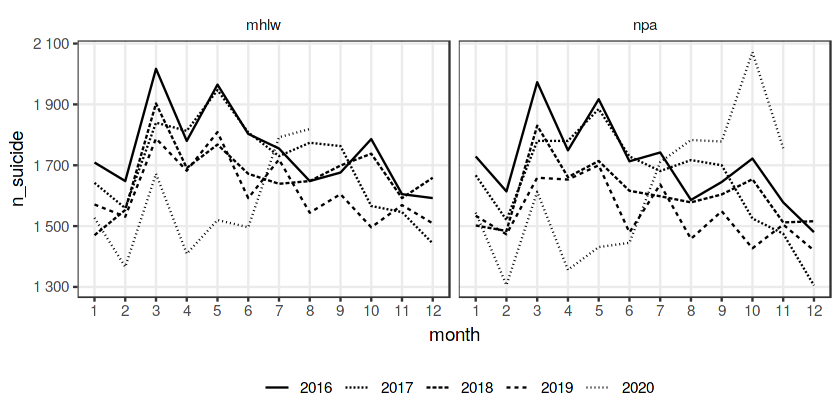

In [4]:
figsize(7, 3.5)
filter(z, year>2015) %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(source)) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())

## Vs average 2016-2019

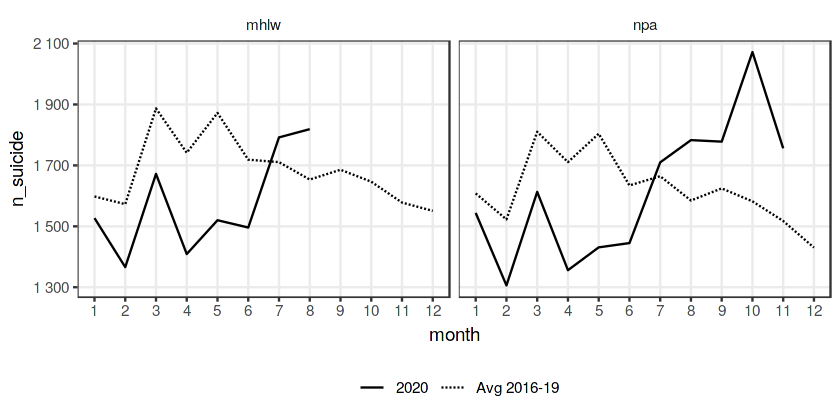

In [5]:
figsize(7, 3.5)
filter(z, year %in% 2016:2019) %>%
  group_by(month, source) %>%
  summarize(n_suicide=mean(n_suicide)) %>%
  mutate(year="Avg 2016-19") %>%
  select(year, month, n_suicide, source) %>%
  bind_rows(filter(z, year==2020) %>% mutate(year=as.character(year)) %>% select(year, month, n_suicide, source)) %>%
ggplot(aes(month, n_suicide, linetype=year)) +
  facet_wrap(vars(source)) +
  geom_line() +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())

このグラフだと、全体的な減少傾向を考慮に入れていないので2020年前半は改善しているようにも見える。この点、次の「予測値からの乖離」を見るほうが直感的だと思う。

## Vs prediction from the past

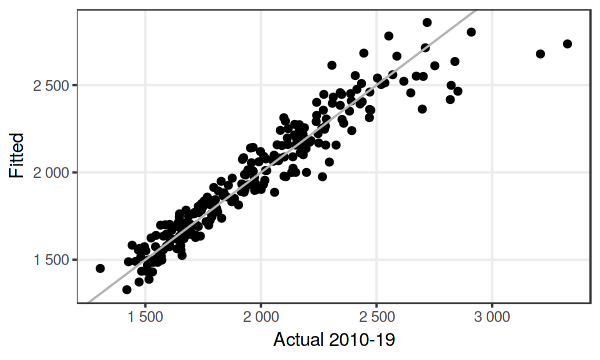

In [6]:
# 自殺者数の対数を予測する線形回帰モデル。
#  npa/mhlwで係数を完全に分離。
#  月次ダミーは年周期の季節性
#  timeは線形トレンド
#  yearは年間固定のトレンド。
traindata <- filter(z, year %in% 2010:2019)
model <- lm(log(n_suicide) ~ factor(month)*source + year*source + time*source,
            data=traindata)

figsize(5, 3)
qplot(traindata$n_suicide, exp(predict(model))) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")

In [7]:
outreg(model)

,.variable,.stat,Model 1
,<chr>,<chr>,<chr>
1,(Intercept),Estimate,-36544.370***
2,,Std Err,[12982.799]
5,factor(month)2,Estimate,1.533***
6,,Std Err,[0.560]
9,factor(month)3,Estimate,3.159***
10,,Std Err,[1.068]
13,factor(month)4,Estimate,4.678***
14,,Std Err,[1.628]
17,factor(month)5,Estimate,6.291***


係数の有意性をみると、`sourcenpa` との交差項はどれも有意ではないから、NPAとMHLWのデータはほぼ同じモデルで予測できるくらい似ていると考えられる。

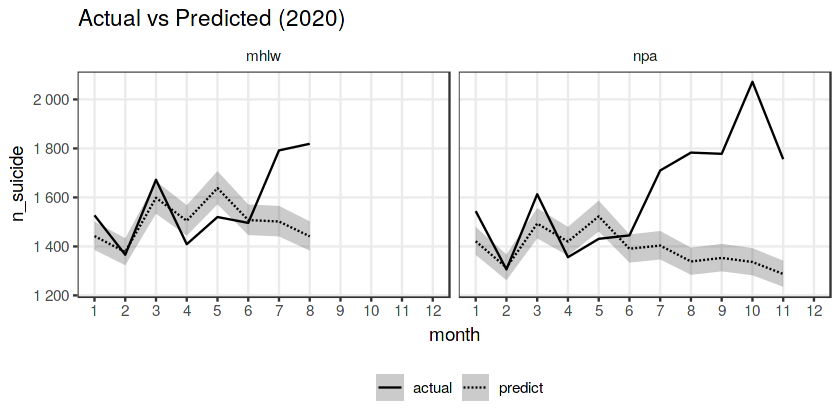

In [8]:
w <- filter(z, year == 2020)
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

figsize(7, 3.5)
ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(source)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())

ggsave("outputs/actual-v-predicted-2020.png", width=7, height=3.5)

*Remarks*
- 近年の減少トレンドからすると、１〜３月の数値はさほど予測とずれない。
- ４・５月の数字は予測をやや下回っているように見える。社会全体の危機の下での自殺減？
- ただし、標準パッケージの信頼区間の計算が甘い可能性あり→ベイズ推計などで厳密にやると良いかも。
- ７月以降は見るからに予測を大きく上回る。フェーズ変化と見てよいと思う
- ４・５月の下振れの分は７月以降の上振れよりも明らかに大きいから、タイミングのシフトとは見えない。

### 同じことを 2010-18 vs 2019 でやると

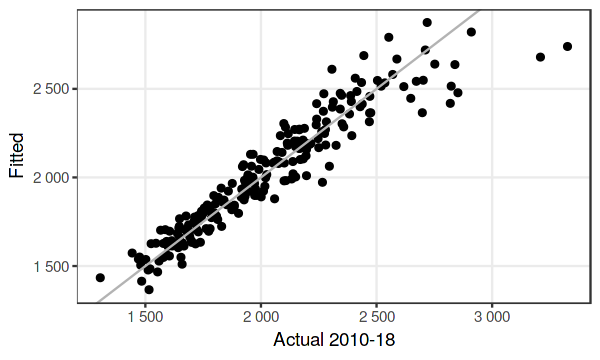

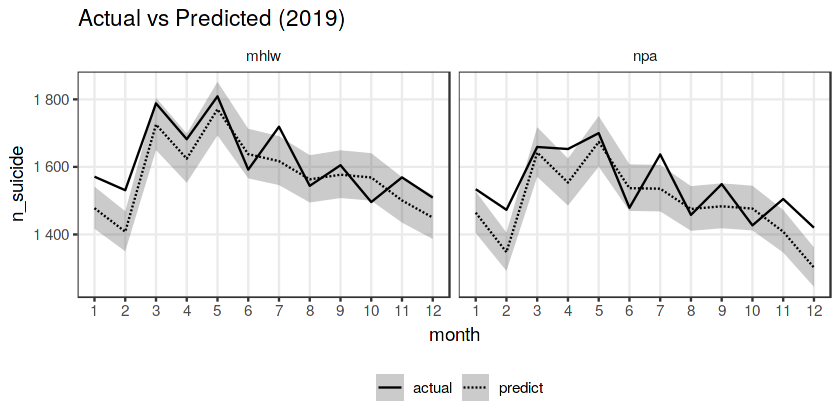

In [9]:
traindata <- filter(z, year %in% 2010:2018)
model <- lm(log(n_suicide) ~ factor(month)*source + year*source + time*source,
            data=traindata)
figsize(5, 3)
qplot(traindata$n_suicide, exp(predict(model))) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")

w <- filter(z, year==2019)
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

figsize(7, 3.5)
ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(source)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggsave("outputs/actual-v-predicted-2019.png", width=7, height=3.5)

そこそこ予測が当たる。2020年の後半はやはり特別なことが起こっていると見える。

In [10]:
outreg(model)

,.variable,.stat,Model 1
,<chr>,<chr>,<chr>
1,(Intercept),Estimate,-31292.281**
2,,Std Err,[14418.840]
5,factor(month)2,Estimate,1.305**
6,,Std Err,[0.622]
9,factor(month)3,Estimate,2.730**
10,,Std Err,[1.187]
13,factor(month)4,Estimate,4.023**
14,,Std Err,[1.808]
17,factor(month)5,Estimate,5.418**


# 上記を男女別に

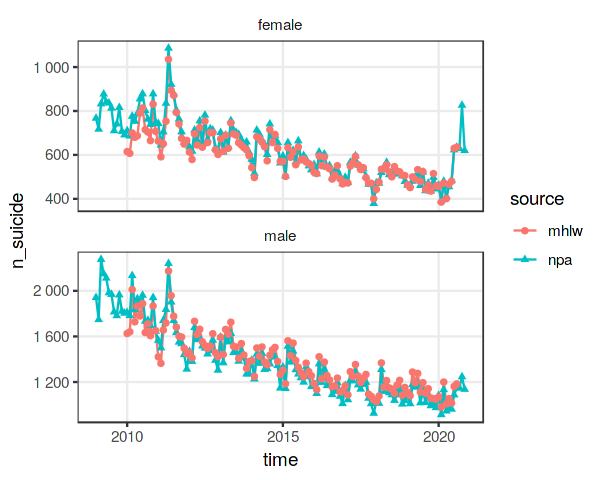

Warning message:
“Removed 30 rows containing missing values (geom_point).”

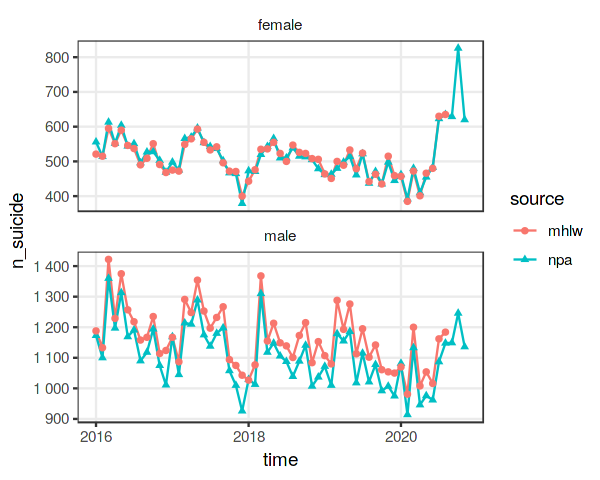

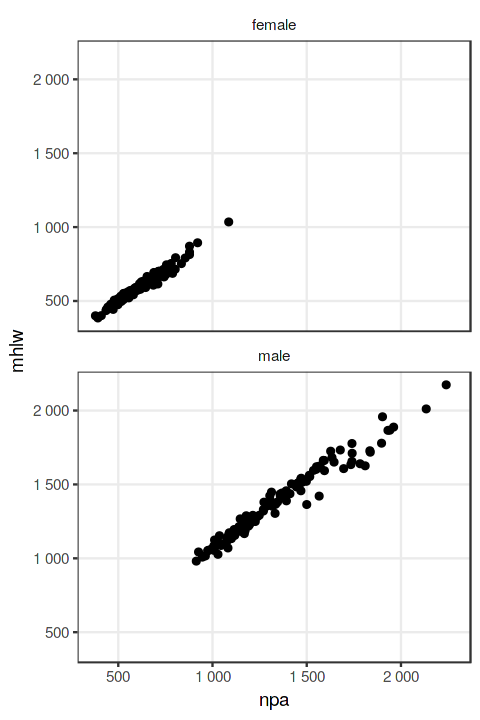

In [11]:
x <- npa("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time
  ,sex
  ,sum(n_suicide) as n_suicide
from
  a5_age
where 
  geocode=0 and sex<>'total'
  --and year > 2015
group by
  time, sex
order by
  time, sex
") %>%
  mutate(time=as.Date(paste0(time, "-01")))

y <- mhlw("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time
  ,sex
  ,sum(n_death) as n_suicide
from
  prompt
where
  substr(geoname, -1) not in ('部' , '市')
  --and year > 2015
group by
  time, sex
order by
  time, sex
") %>%
  mutate(time=as.Date(paste0(time, "-01")))

z <- rbind(mutate(x, source="npa"), mutate(y, source="mhlw"))

figsize(5, 4)
ggplot(z, aes(time, n_suicide, color=source, shape=source)) +
  geom_line() +
  geom_point() +
  facet_wrap(vars(sex), ncol=1, scales="free_y") +
  scale_y_continuous(labels=number_format())

figsize(5, 4)
filter(z, year > 2015) %>%
ggplot(aes(time, n_suicide, color=source, shape=source)) +
  geom_line() +
  geom_point() +
  facet_wrap(vars(sex), ncol=1, scales="free_y") +
  scale_y_continuous(labels=number_format())

figsize(4, 6)
pivot_wider(select(z, sex, time, n_suicide, source),
            id_cols=c(sex, time), names_from=source, values_from=n_suicide) %>%
ggplot(aes(npa, mhlw)) +
  geom_point() +
  facet_wrap(vars(sex), ncol=1) +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format())

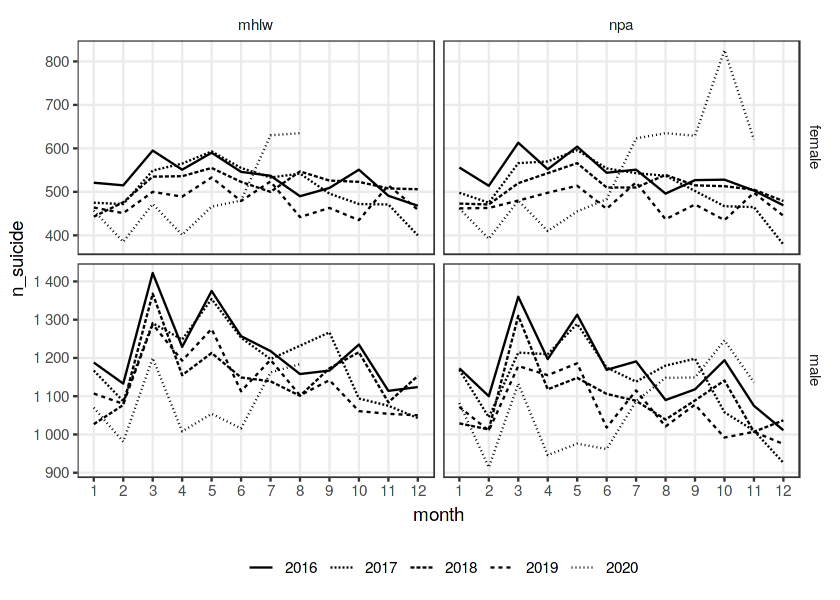

In [12]:
figsize(7, 5)
filter(z, year>2015) %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_grid(vars(sex), vars(source), scales="free_y") +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())

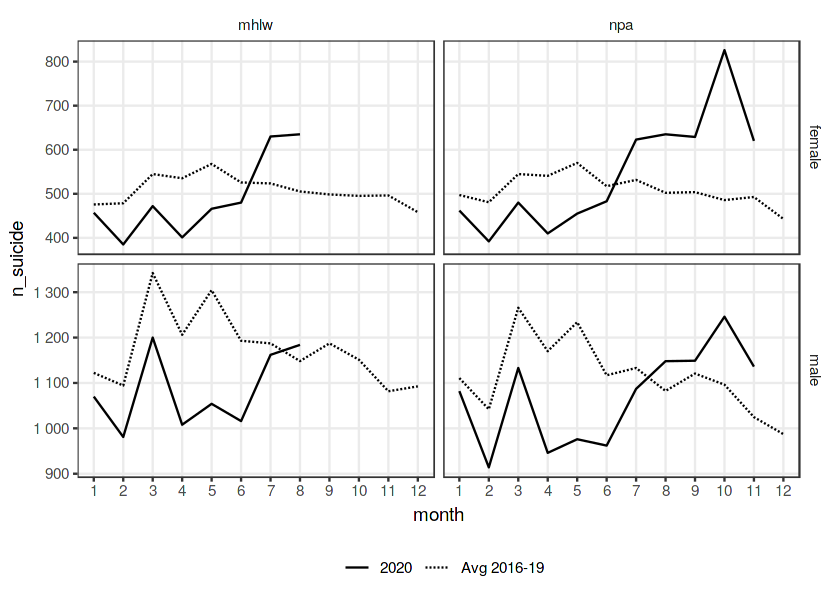

In [13]:
figsize(7, 5)
filter(z, year %in% 2016:2019) %>%
  group_by(month, source, sex) %>%
  summarize(n_suicide=mean(n_suicide)) %>%
  mutate(year="Avg 2016-19") %>%
  select(year, sex, month, n_suicide, source) %>%
  bind_rows(filter(z, year==2020) %>% mutate(year=as.character(year)) %>% select(year, sex, month, n_suicide, source)) %>%
ggplot(aes(month, n_suicide, linetype=year)) +
  facet_grid(vars(sex), vars(source), scales="free_y") +
  geom_line() +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())

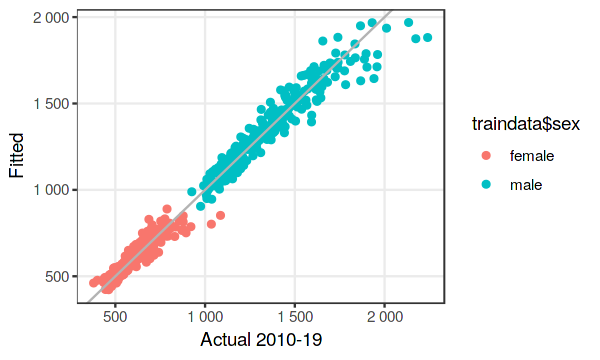

In [14]:
# 自殺者数の対数を予測する線形回帰モデル。
#  npa/mhlw, sexで係数を完全に分離（事実上別のモデルを推定している）
#  月次ダミーは年周期の季節性
#  timeは線形トレンド
#  yearは年間固定のトレンド。
traindata <- filter(z, year %in% 2010:2019)
model <- lm(log(n_suicide) ~ factor(month)*source*sex + year*source*sex + time*source*sex + source*sex,
            data=traindata)

figsize(5, 3)
qplot(traindata$n_suicide, exp(predict(model)), color=traindata$sex) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")

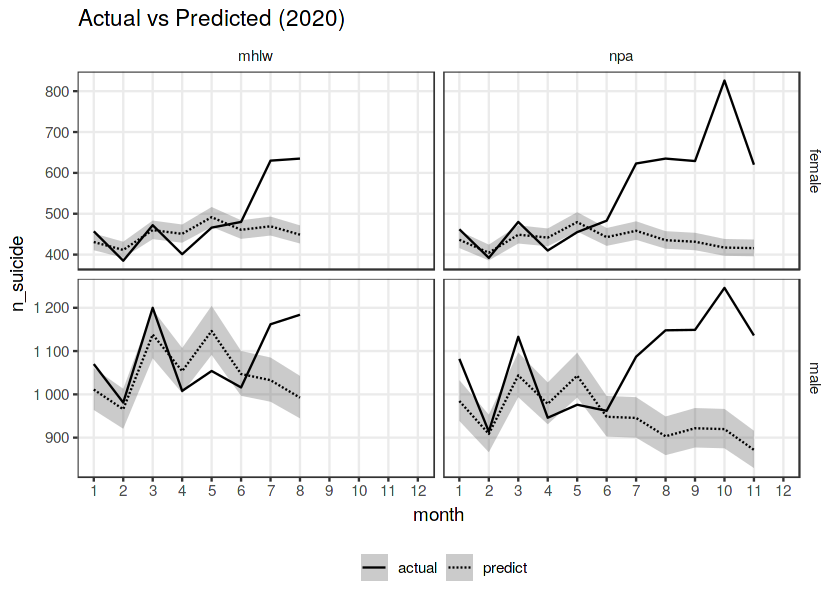

In [15]:
w <- filter(z, year==2020)
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

figsize(7, 5)
ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_grid(vars(sex), vars(source), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  #scale_y_log10(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggsave("outputs/actual-v-predicted-by-sex-2020.png", width=7, height=5)

In [16]:
outreg(model)

,.variable,.stat,Model 1
,<chr>,<chr>,<chr>
1,(Intercept),Estimate,-43241.882***
2,,Std Err,[15516.016]
5,factor(month)2,Estimate,1.822***
6,,Std Err,[0.669]
9,factor(month)3,Estimate,3.680***
10,,Std Err,[1.277]
13,factor(month)4,Estimate,5.528***
14,,Std Err,[1.945]
17,factor(month)5,Estimate,7.421***


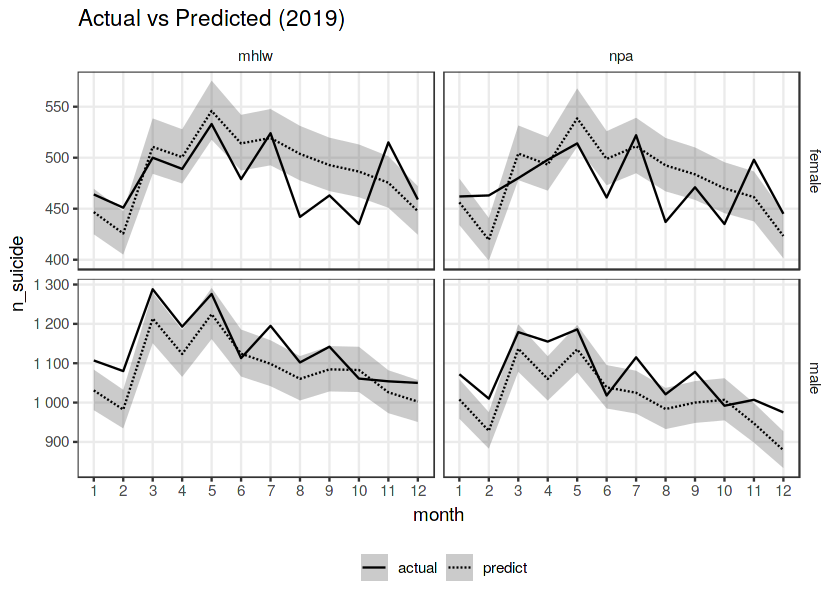

In [17]:
traindata <- filter(z, year %in% 2010:2018)
model <- lm(log(n_suicide) ~ factor(month)*source*sex + year*source*sex + time*source*sex + sex*source,
            data=traindata)

w <- filter(z, year==2019)
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

figsize(7, 5)
ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_grid(vars(sex), vars(source), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggsave("outputs/actual-v-predicted-by-sex-2019.png", width=7, height=5)

In [18]:
outreg(model)

,.variable,.stat,Model 1
,<chr>,<chr>,<chr>
1,(Intercept),Estimate,-50513.054***
2,,Std Err,[17147.518]
5,factor(month)2,Estimate,2.133***
6,,Std Err,[0.739]
9,factor(month)3,Estimate,4.284***
10,,Std Err,[1.412]
13,factor(month)4,Estimate,6.445***
14,,Std Err,[2.150]
17,factor(month)5,Estimate,8.642***


# Reason

In [19]:
x <- npa("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time || '-01' as time
  ,reason
  ,sex
  ,sum(n_suicide) as n_suicide
from
  a5_reason
where
  geocode=0
group by
  reason, time, sex
order by
  reason, time, sex
")
reasons <- c("家庭問題", "健康問題", "経済・生活問題", "勤務問題", "男女問題", "学校問題", "その他", "不詳")
x <- mutate(x, time=as.Date(time), reason=factor(reason, levels=reasons))
dim(x)
head(x)

[1] 3432    6

year,month,time,reason,sex,n_suicide
<int>,<int>,<date>,<fct>,<chr>,<dbl>
2009,1,2009-01-01,その他,female,43
2009,1,2009-01-01,その他,male,96
2009,1,2009-01-01,その他,total,139
2009,2,2009-02-01,その他,female,29
2009,2,2009-02-01,その他,male,81
2009,2,2009-02-01,その他,total,110


saved to ggtmp/1612409184.jpg


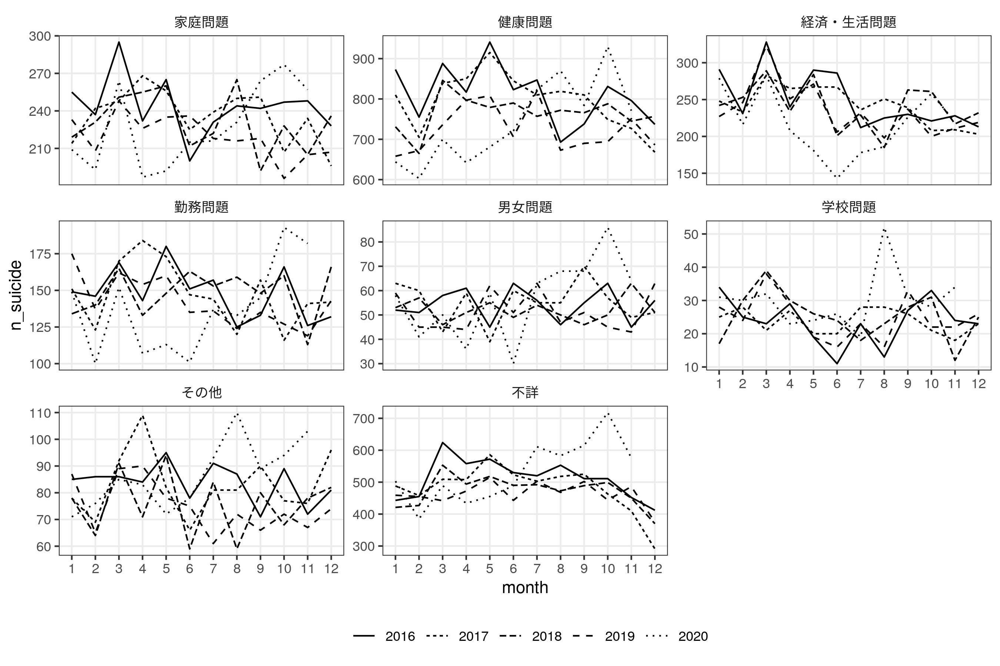

In [20]:
figsize(7, 5)
g <- filter(x, year>2015, sex=="total") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(reason), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, dispwidth="900px", width=9, height=6)

## 2020 by sex

saved to ggtmp/1612409185.jpg


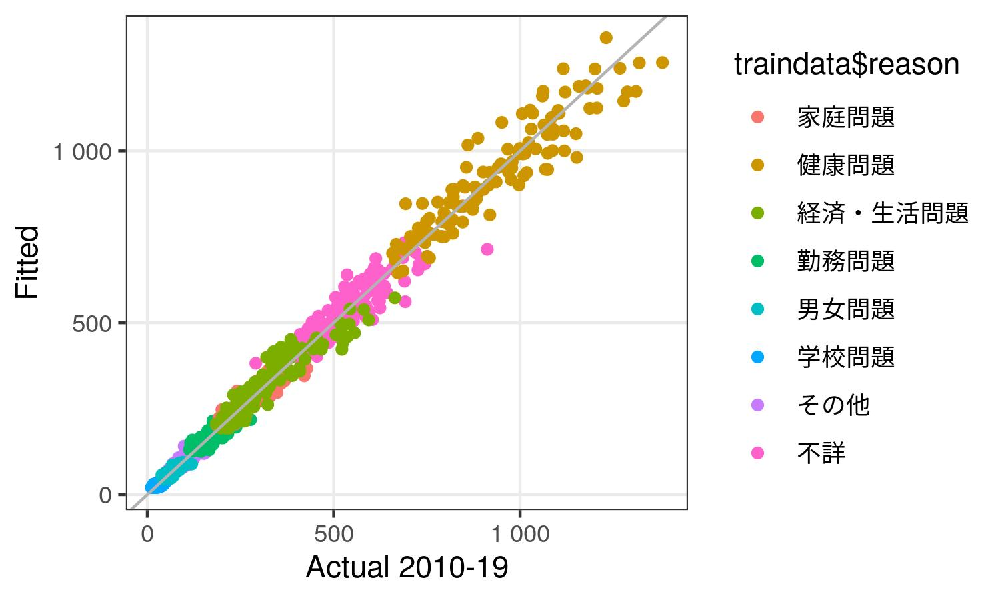

saved to ggtmp/1612409185.jpg


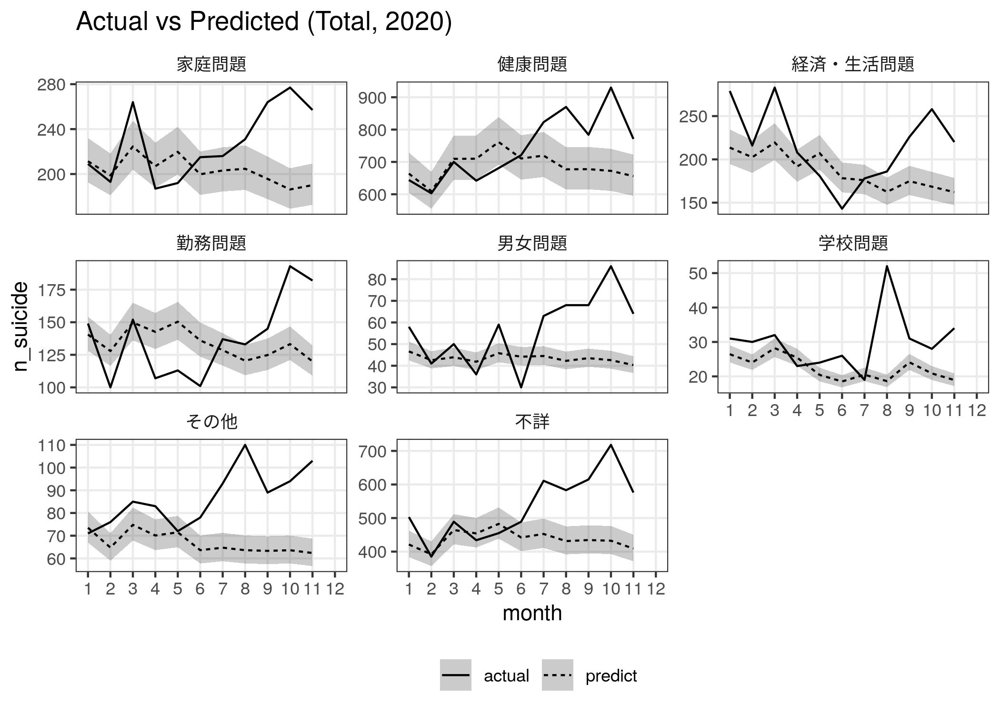

In [21]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$n_suicide, exp(predict(model)), color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-2020.png", width=7, height=5)

saved to ggtmp/1612409187.jpg


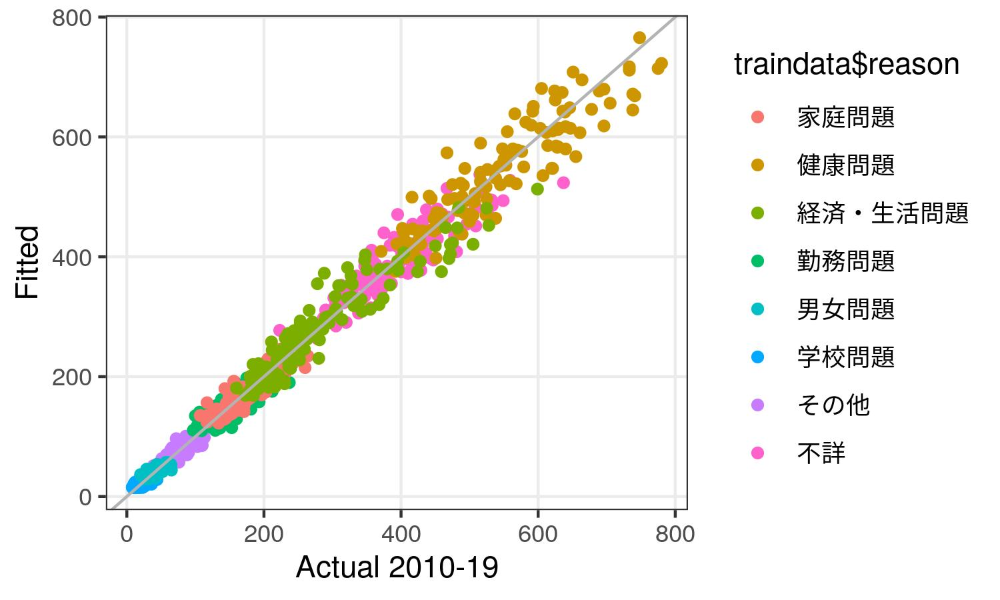

saved to ggtmp/1612409187.jpg


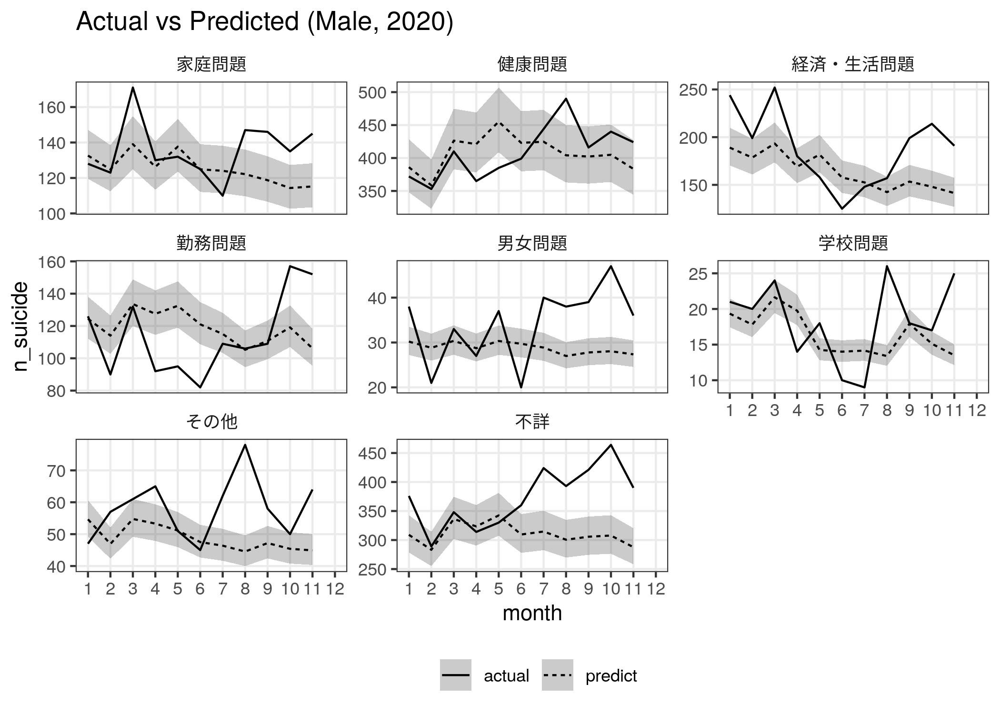

In [22]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$n_suicide, exp(predict(model)), color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-male-2020.png", width=7, height=5)

saved to ggtmp/1612409189.jpg


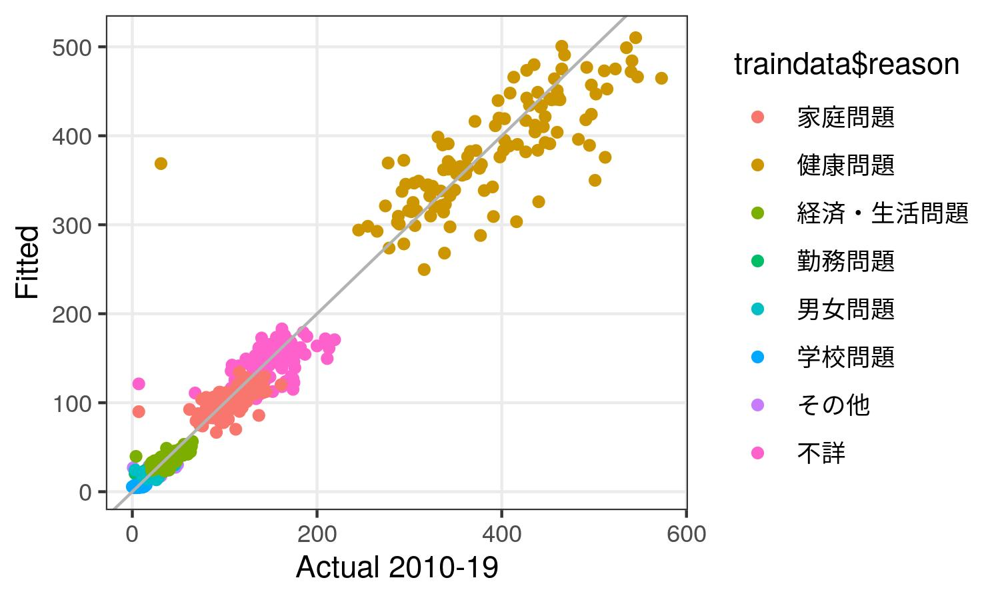

saved to ggtmp/1612409189.jpg


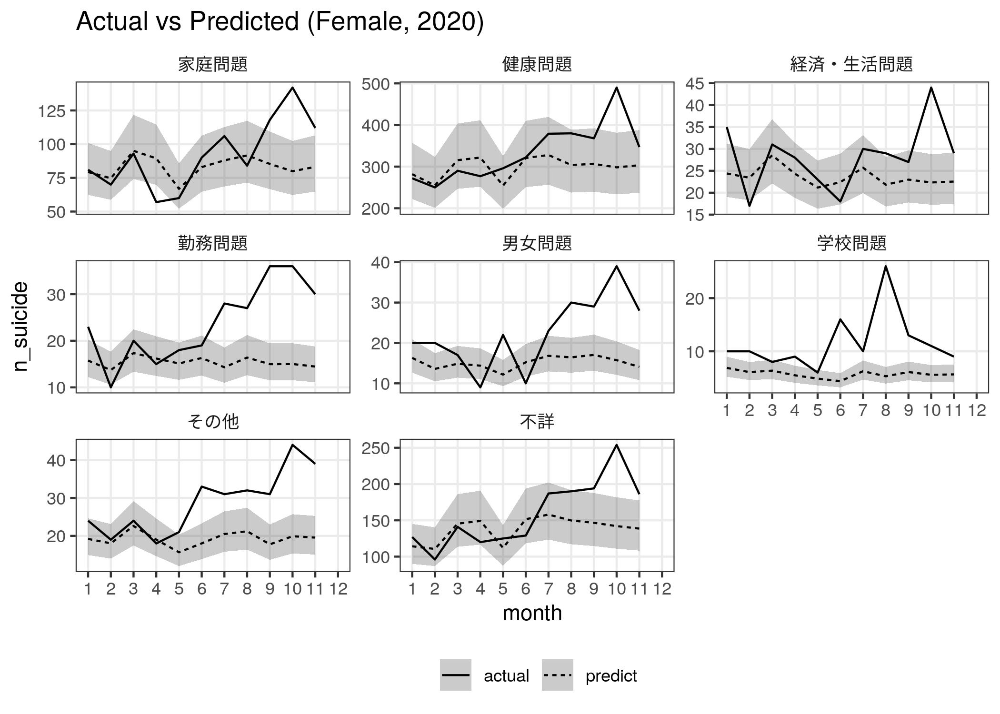

In [23]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- lm(log(1 + n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)
pred <- predict(model) %>% exp() - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-female-2020.png", width=7, height=5)

## 2019 by sex

saved to ggtmp/1612409191.jpg


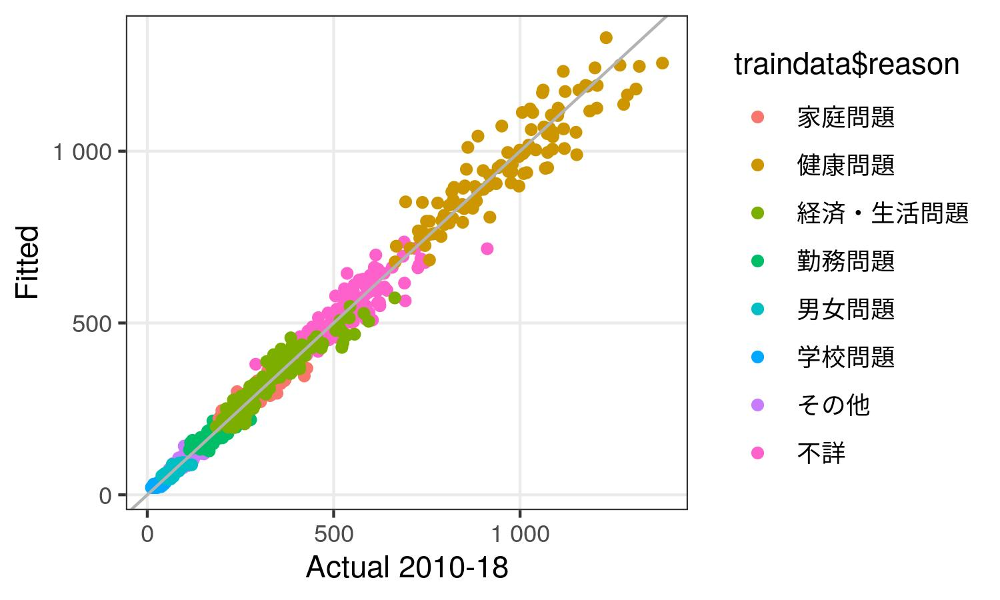

saved to ggtmp/1612409191.jpg


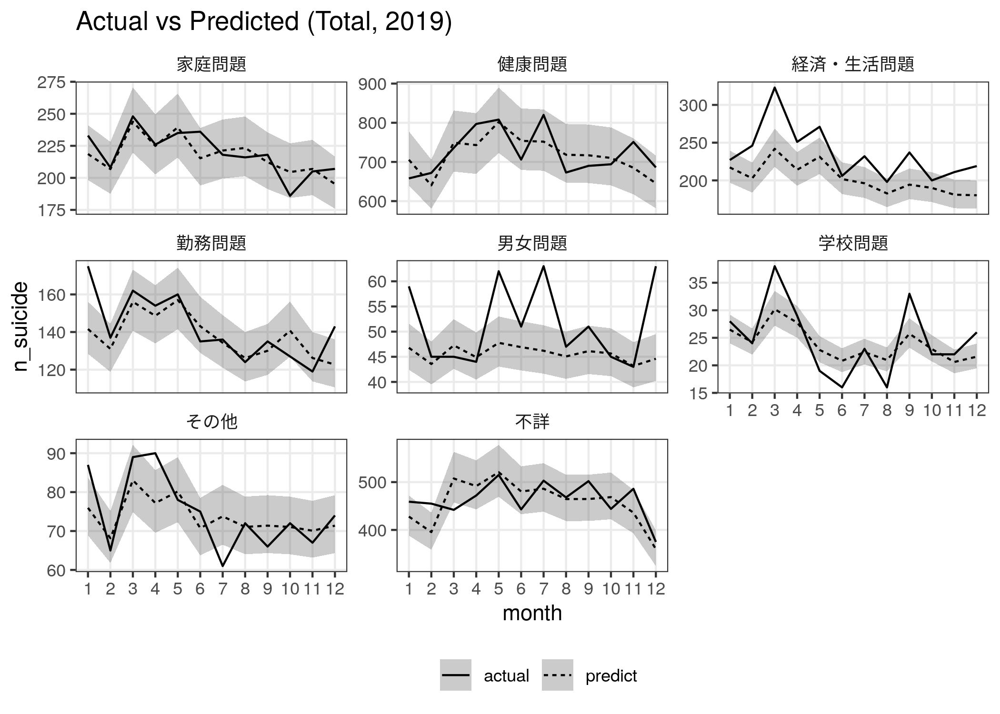

In [24]:
traindata <- filter(x, year %in% 2010:2018, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$n_suicide, exp(predict(model)), color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-2019.png", width=7, height=5)

saved to ggtmp/1612409193.jpg


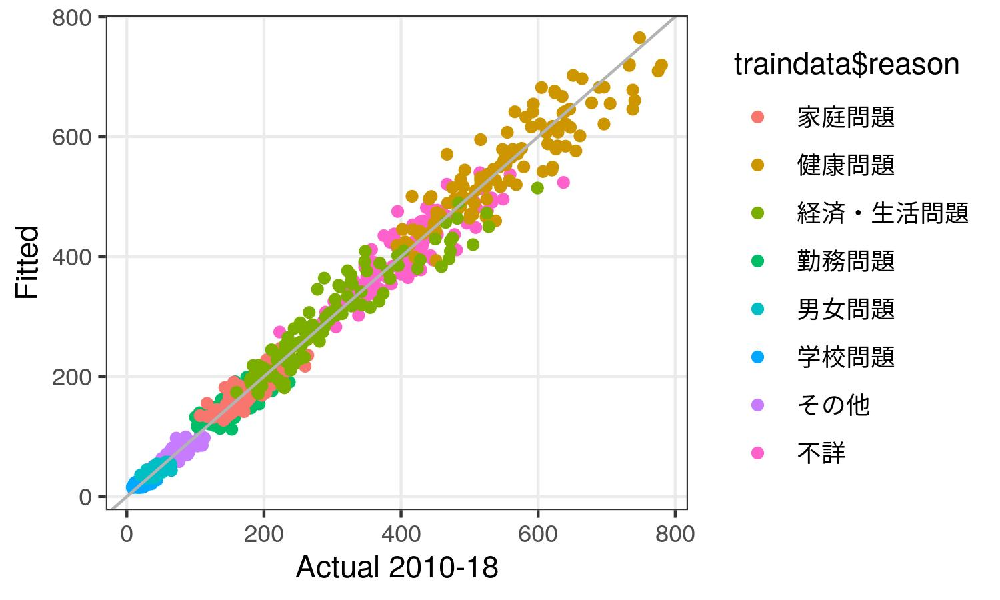

saved to ggtmp/1612409193.jpg


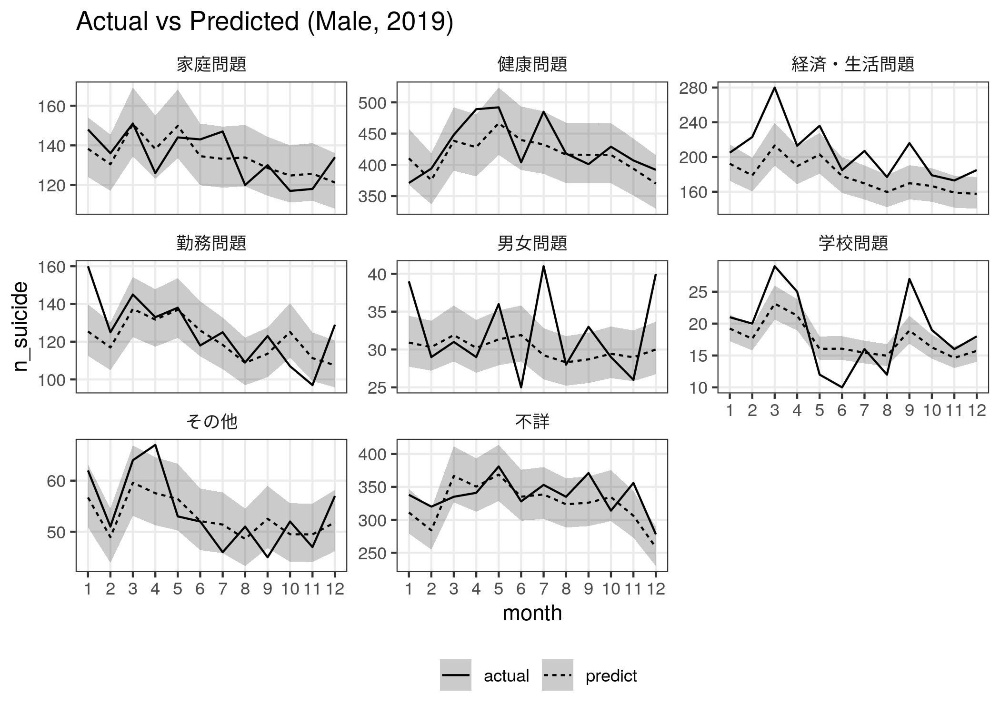

In [25]:
traindata <- filter(x, year %in% 2010:2018, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$n_suicide, exp(predict(model)), color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-male-2019.png", width=7, height=5)

saved to ggtmp/1612409195.jpg


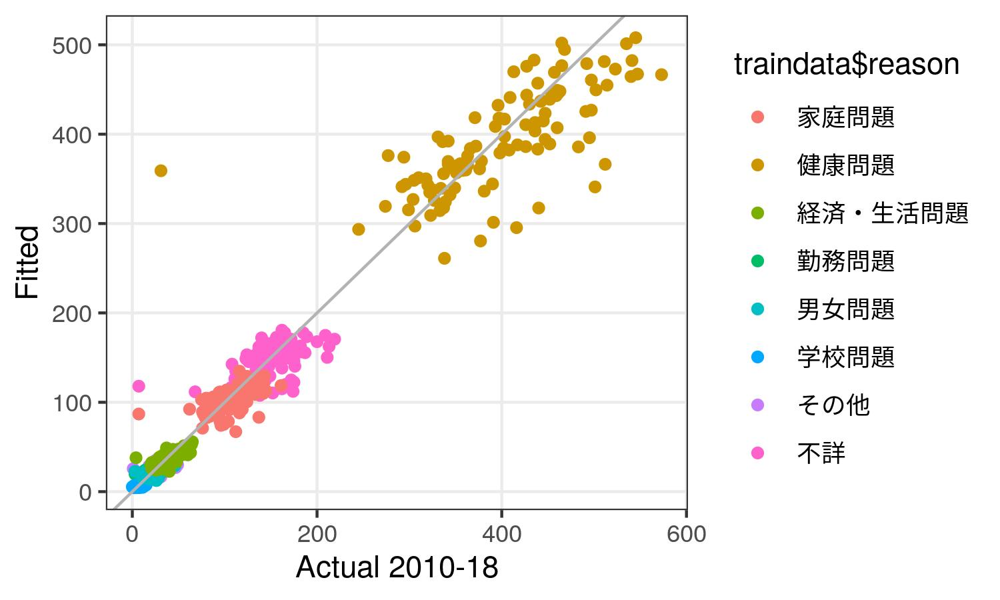

saved to ggtmp/1612409195.jpg


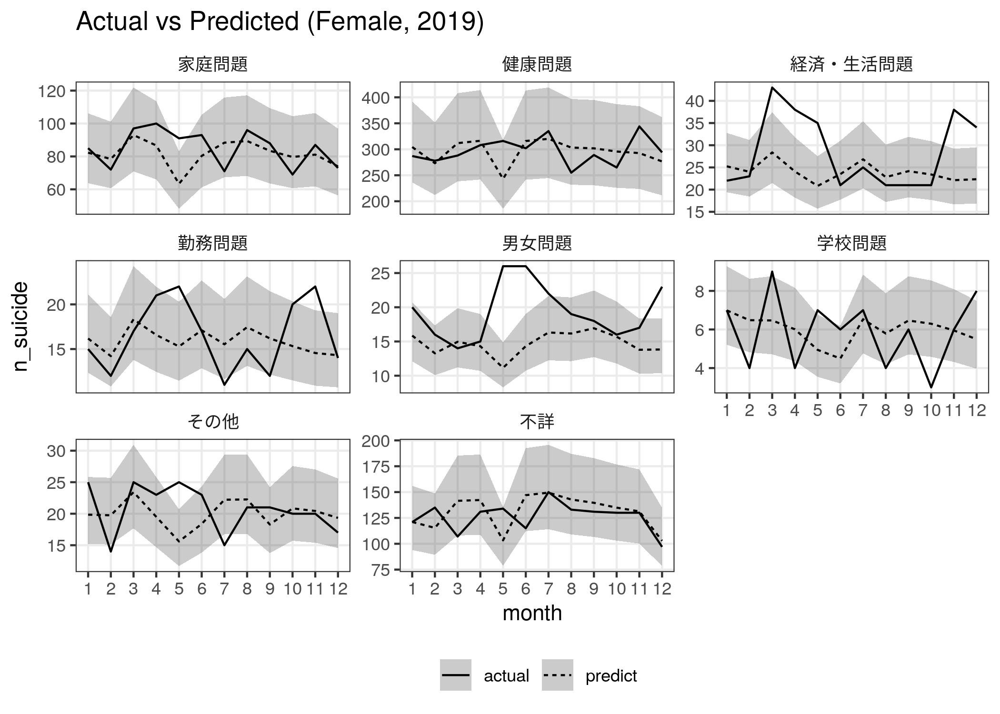

In [26]:
traindata <- filter(x, year %in% 2010:2018, sex=="female")
model <- lm(log(1 + n_suicide) ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)
pred <- predict(model) %>% exp() - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-female-2019.png", width=7, height=5)

# Reason as a fraction

In [27]:
x <- npa("
select
   cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,time || '-01' as time
  ,reason
  ,sex
  ,sum(n_suicide) as n_suicide
  ,total
  ,sum(n_suicide) / total as fraction
from
  a5_reason as a
  inner join (
    select time, sex, sum(n_suicide) as total
    from a5_age
    where geocode=0
    group by time, sex
  ) as b
  using (time, sex)
where
  geocode=0
group by
  reason, time, sex
order by
  reason, time, sex
")
reasons <- c("家庭問題", "健康問題", "経済・生活問題", "勤務問題", "男女問題", "学校問題", "その他", "不詳")
x <- mutate(x, time=as.Date(time), reason=factor(reason, levels=reasons))
dim(x)
head(x)

[1] 3432    8

year,month,time,reason,sex,n_suicide,total,fraction
<int>,<int>,<date>,<fct>,<chr>,<dbl>,<dbl>,<dbl>
2009,1,2009-01-01,その他,female,43,767,0.05606258
2009,1,2009-01-01,その他,male,96,1942,0.04943357
2009,1,2009-01-01,その他,total,139,2709,0.05131045
2009,2,2009-02-01,その他,female,29,717,0.04044630
2009,2,2009-02-01,その他,male,81,1748,0.04633867
2009,2,2009-02-01,その他,total,110,2465,0.04462475


## 2020

saved to ggtmp/1612409197.jpg


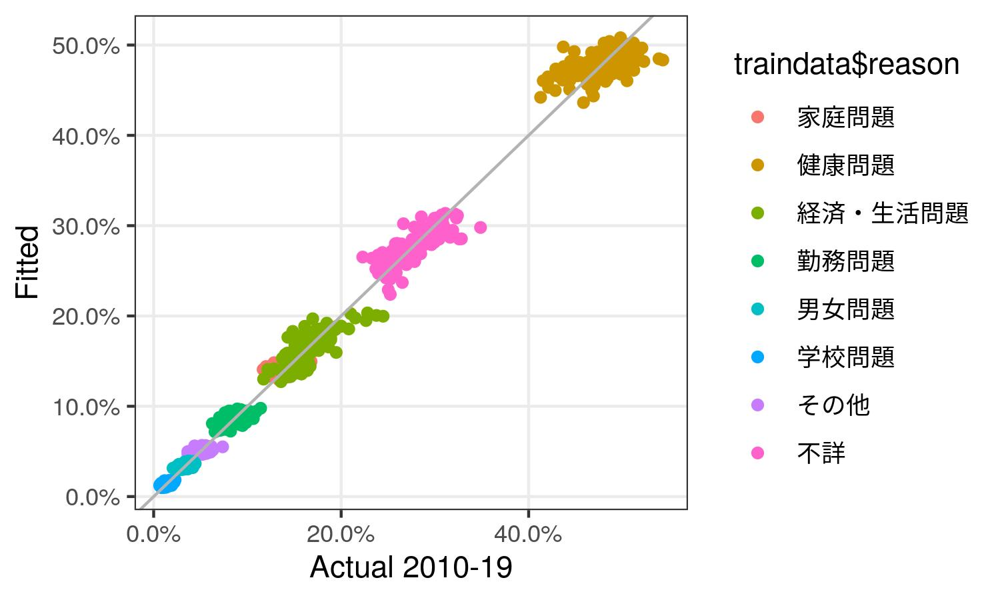

saved to ggtmp/1612409197.jpg


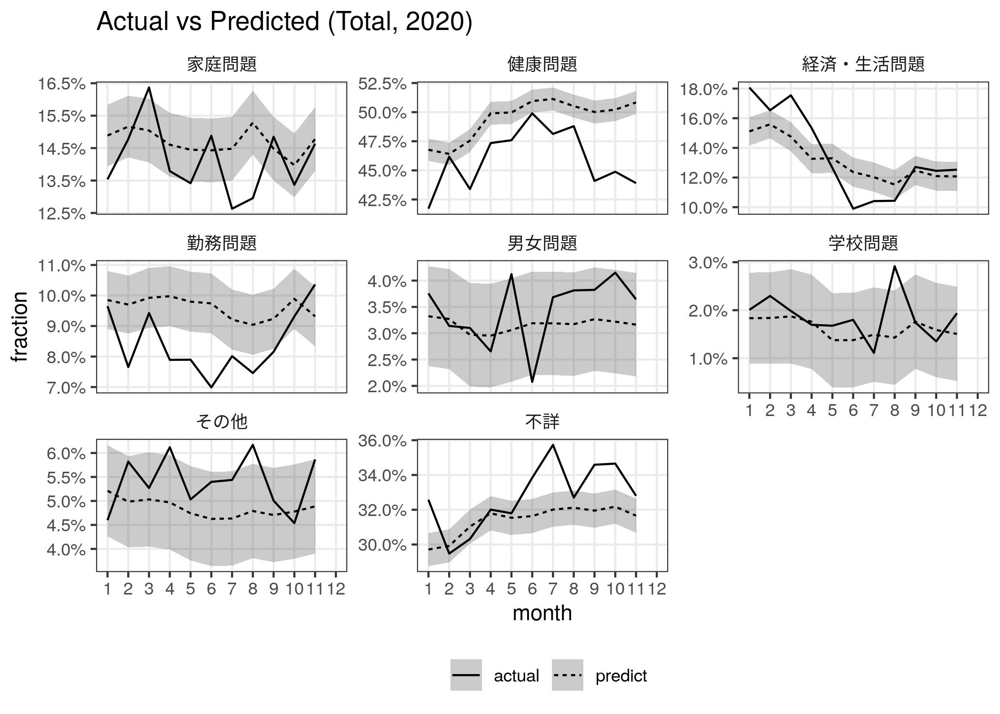

In [28]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-2020.png", width=7, height=5)

saved to ggtmp/1612409199.jpg


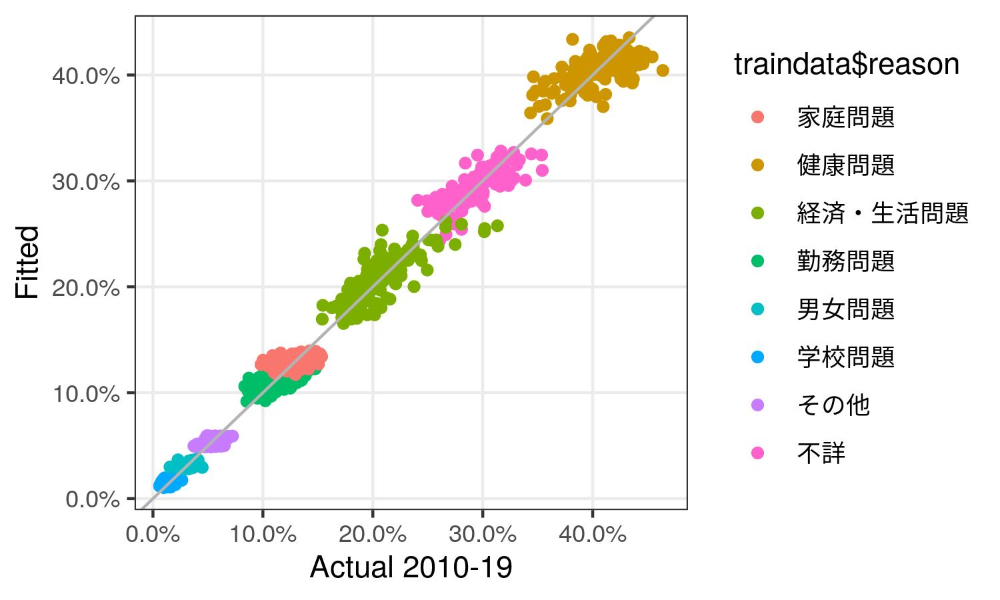

saved to ggtmp/1612409199.jpg


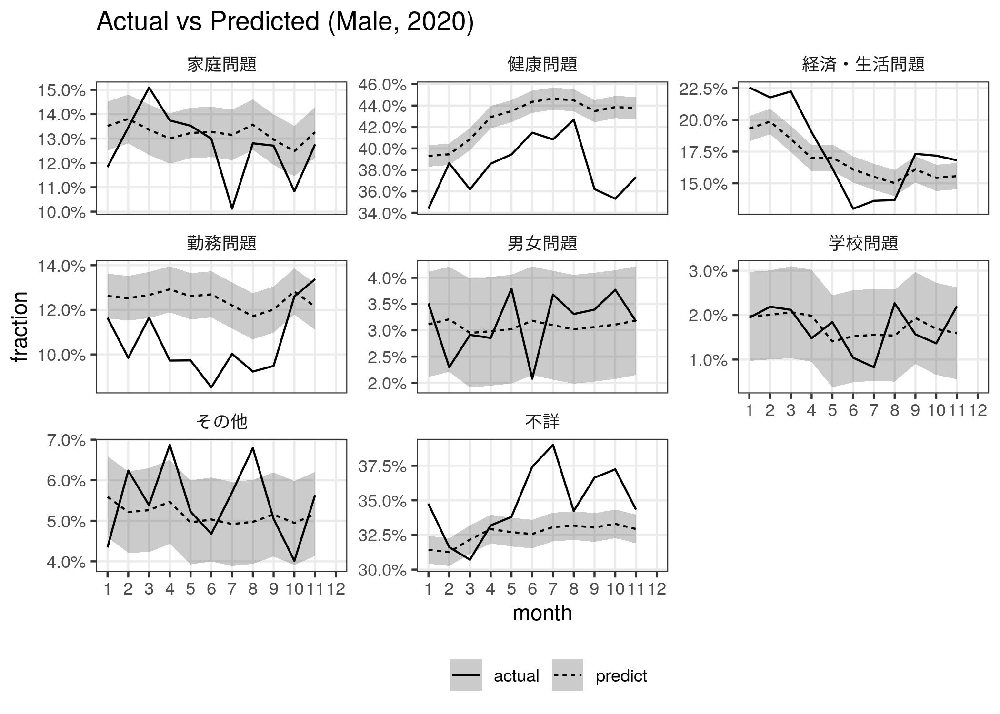

In [29]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-male-2020.png", width=7, height=5)

saved to ggtmp/1612409200.jpg


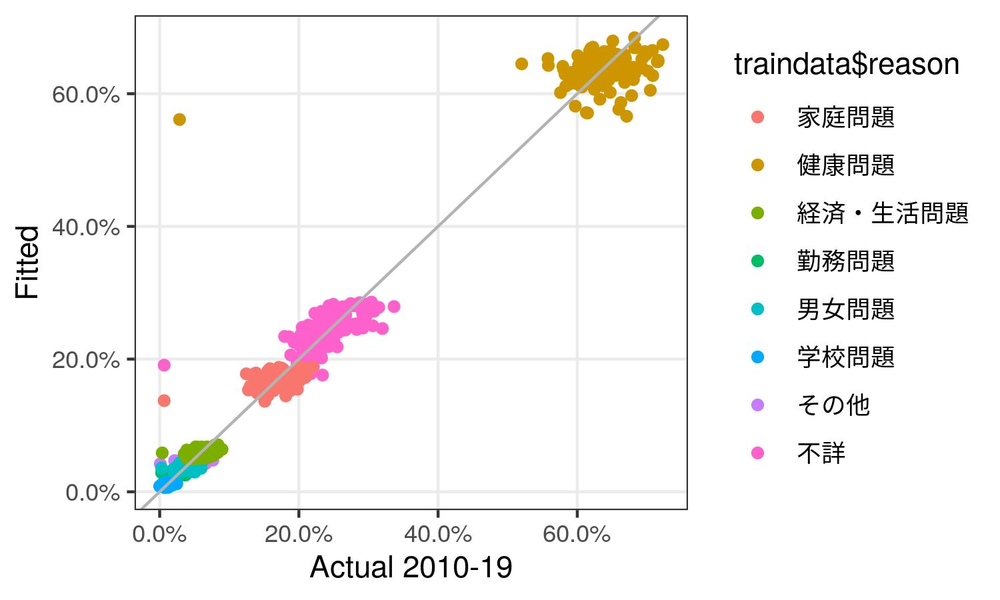

saved to ggtmp/1612409201.jpg


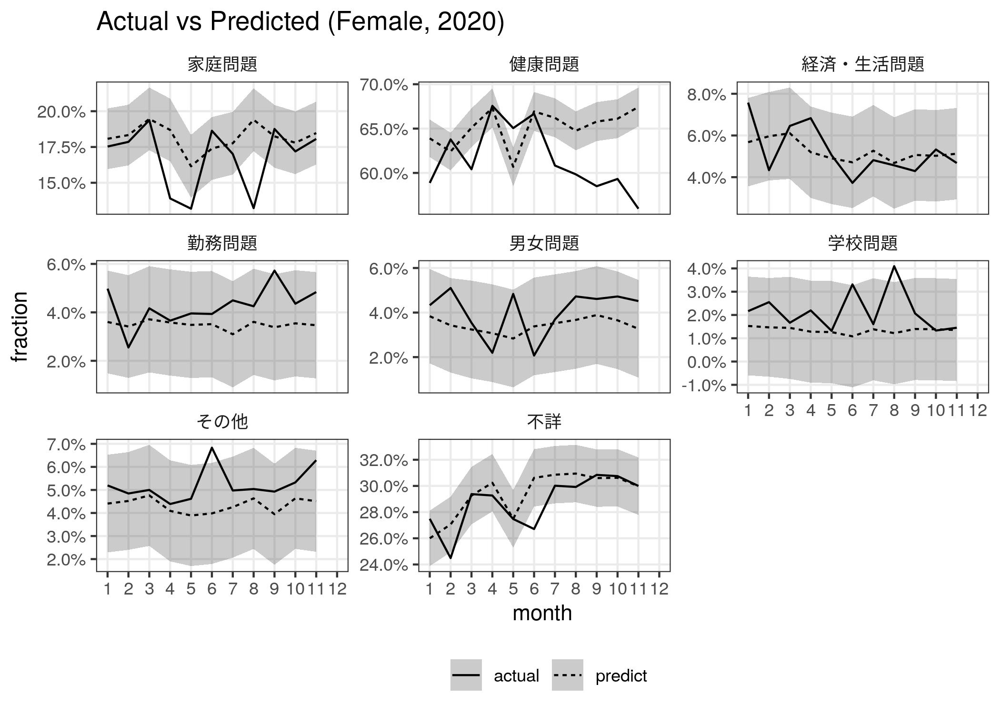

In [30]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-female-2020.png", width=7, height=5)

## 2019

saved to ggtmp/1612409202.jpg


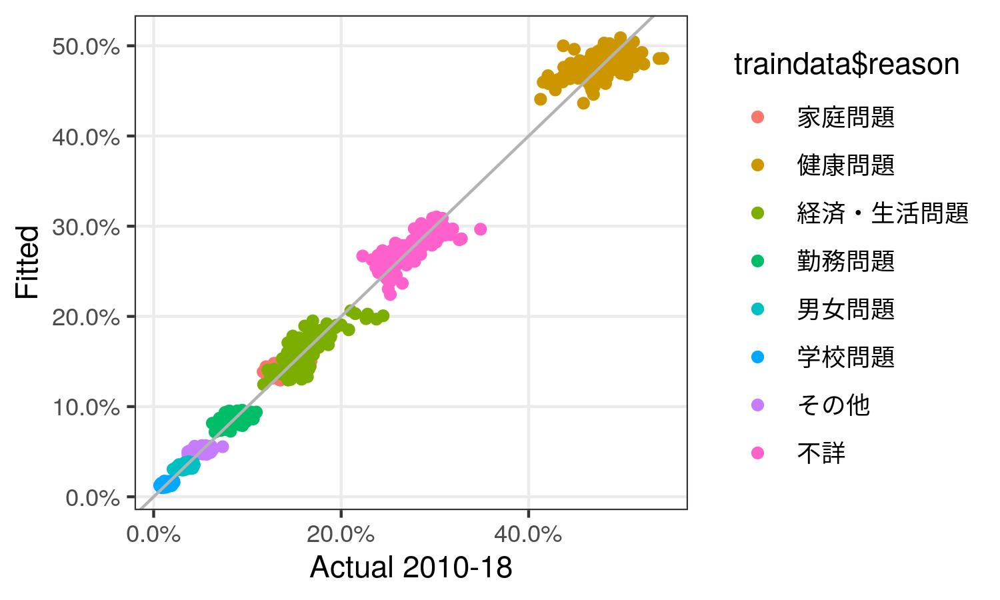

saved to ggtmp/1612409203.jpg


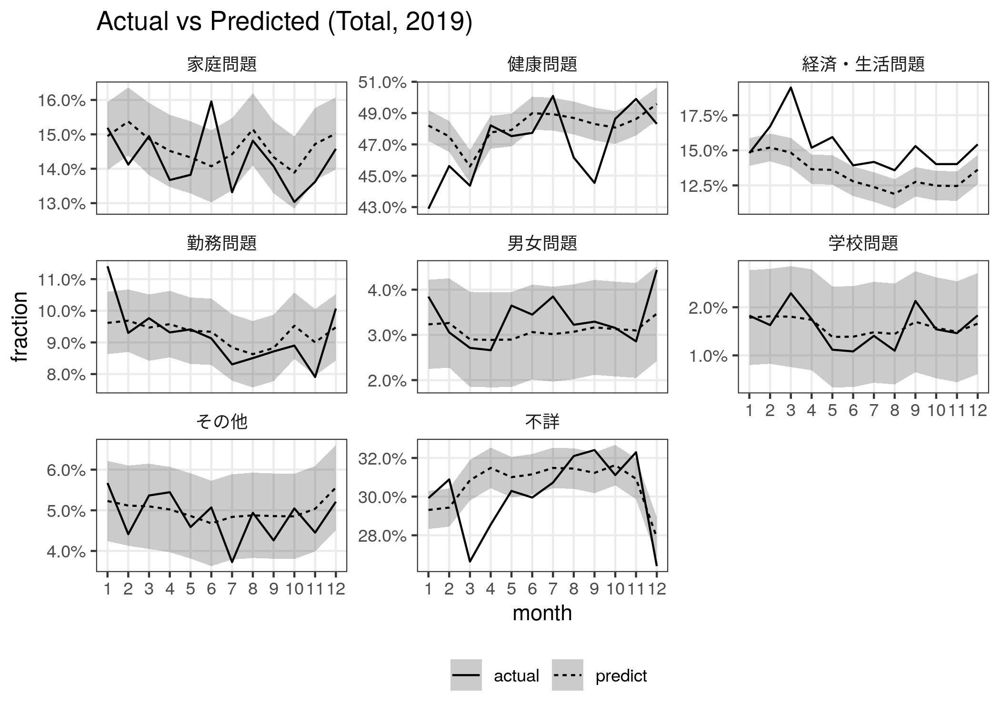

In [31]:
traindata <- filter(x, year %in% 2010:2018, sex=="total")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="total")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-2019.png", width=7, height=5)

saved to ggtmp/1612409204.jpg


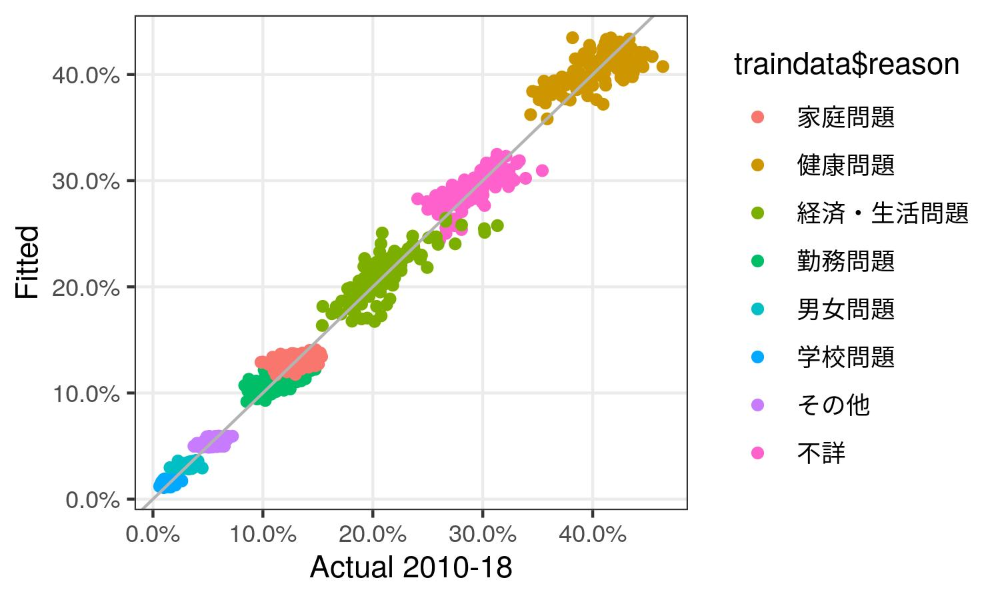

saved to ggtmp/1612409205.jpg


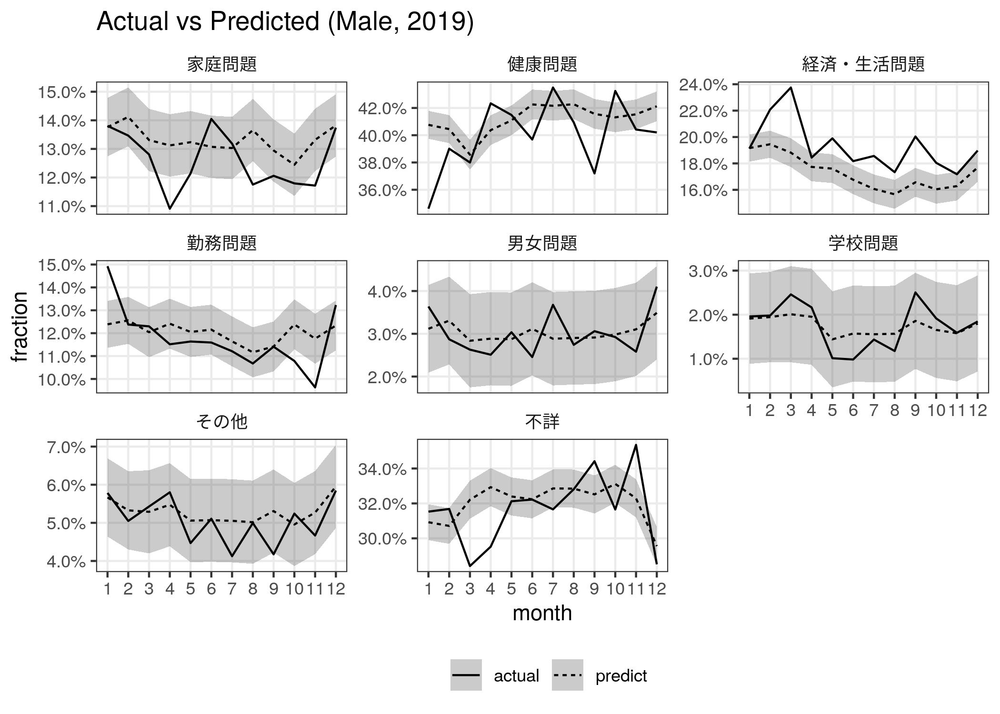

In [32]:
traindata <- filter(x, year %in% 2010:2018, sex=="male")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="male")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-male-2019.png", width=7, height=5)

saved to ggtmp/1612409207.jpg


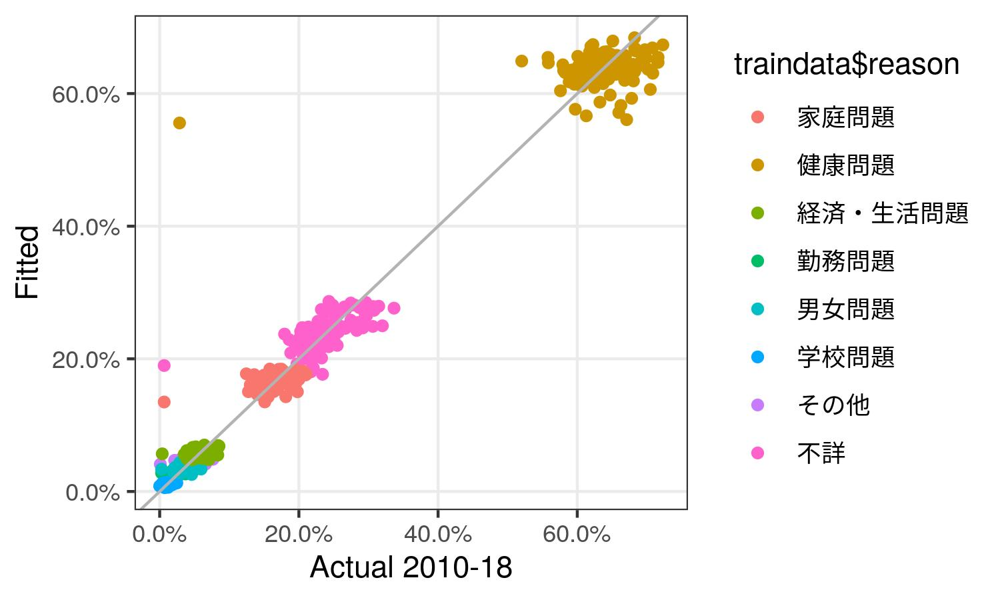

saved to ggtmp/1612409207.jpg


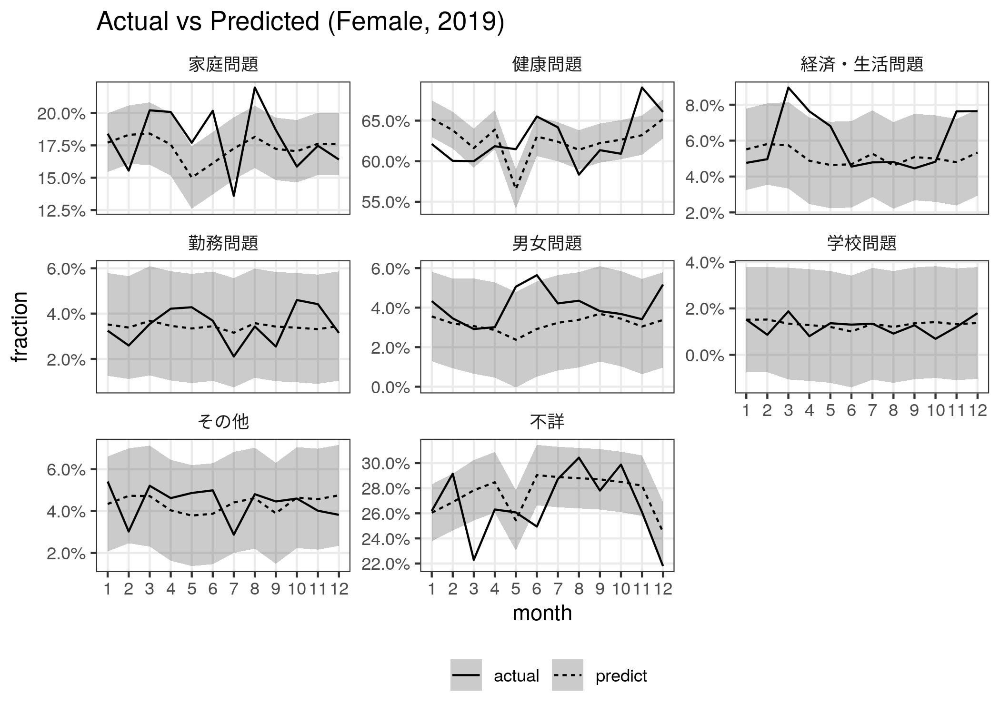

In [33]:
traindata <- filter(x, year %in% 2010:2018, sex=="female")
model <- lm(fraction ~ factor(month)*reason + year*reason + time*reason + reason,
            data=traindata)

g <- qplot(traindata$fraction, predict(model), color=traindata$reason) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=percent_format(accuracy=0.1)) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="female")
pred <- predict(model, newdata=w, interval="confidence")
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, fraction=pred[,1], type="predict"))

g <- ggplot(w, aes(month, fraction, linetype=type)) +
  facet_wrap(vars(reason), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=percent_format(accuracy=0.1)) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-reason-frac-female-2019.png", width=7, height=5)

# 職業

In [79]:
x <- npa("
select
   time || '-01' as time
  ,cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,sex
  ,case 
    when occupation = '自営業・家族従事者' then '自営業・家族従業者'
    else occupation
  end as occup
  ,sum(n_suicide) as n_suicide
from
  a5_occupation
where
  geocode=0
group by
  time, sex, occup 
order by
  time, sex, occup
") %>%
  mutate(time=as.Date(time))
levels <- c('自営業・家族従業者',
            '被雇用・勤め人',
            '学生・生徒等',
            '主婦',
            '失業者',
            'その他の無職者',
            '年金・雇用保険等生活者',
            '不詳')
x$occup <- factor(x$occup, levels=levels)
head(x)

time,year,month,sex,occup,n_suicide
<date>,<int>,<int>,<chr>,<fct>,<dbl>
2009-01-01,2009,1,female,その他の無職者,221
2009-01-01,2009,1,female,不詳,6
2009-01-01,2009,1,female,主婦,168
2009-01-01,2009,1,female,失業者,23
2009-01-01,2009,1,female,学生・生徒等,27
2009-01-01,2009,1,female,年金・雇用保険等生活者,163


saved to ggtmp/1612410106.jpg


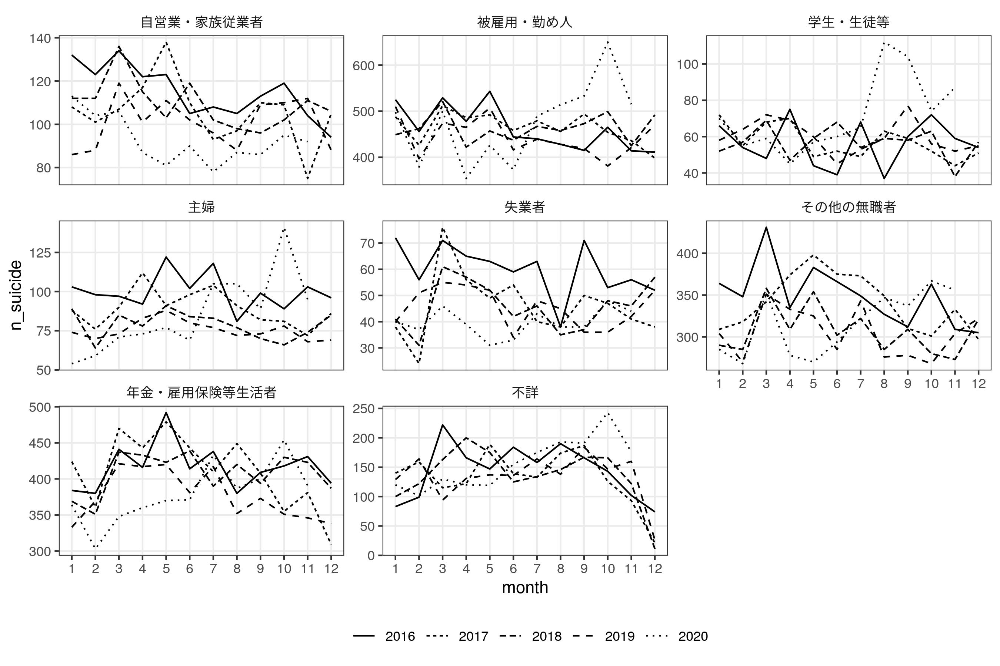

saved to ggtmp/1612410106.jpg


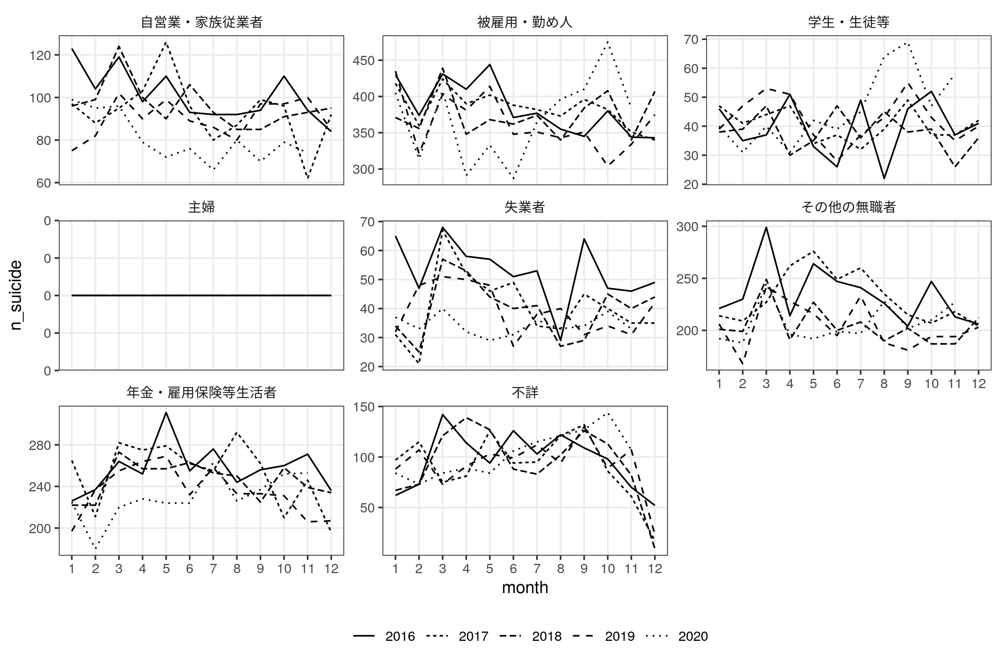

saved to ggtmp/1612410107.jpg


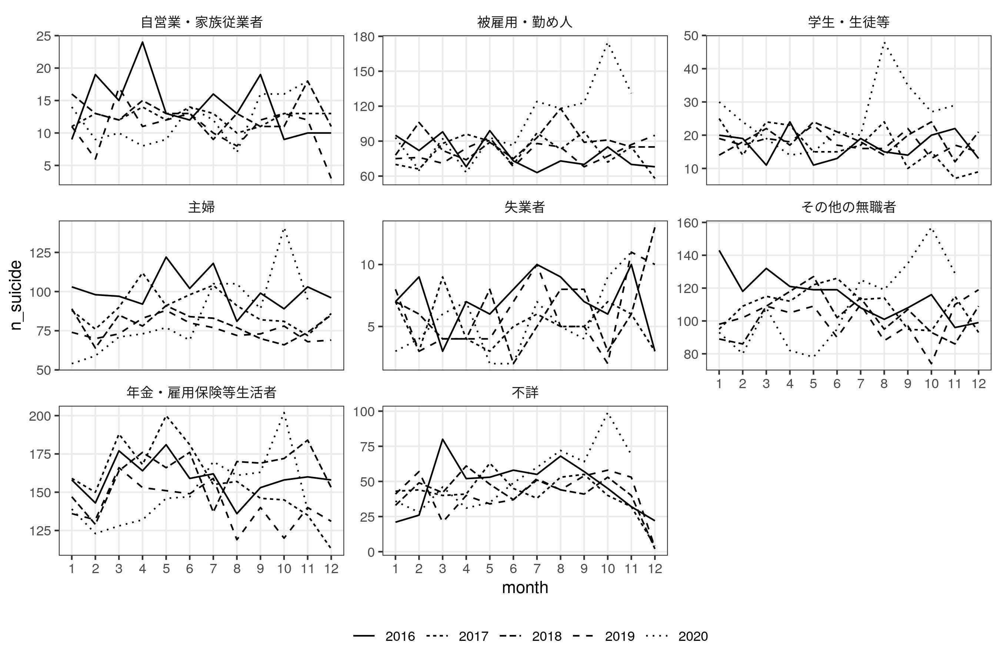

In [80]:
g <- filter(x, year>2015, sex=="total") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(occup), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)

g <- filter(x, year>2015, sex=="male") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(occup), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)


g <- filter(x, year>2015, sex=="female") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(occup), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)

saved to ggtmp/1612410362.jpg


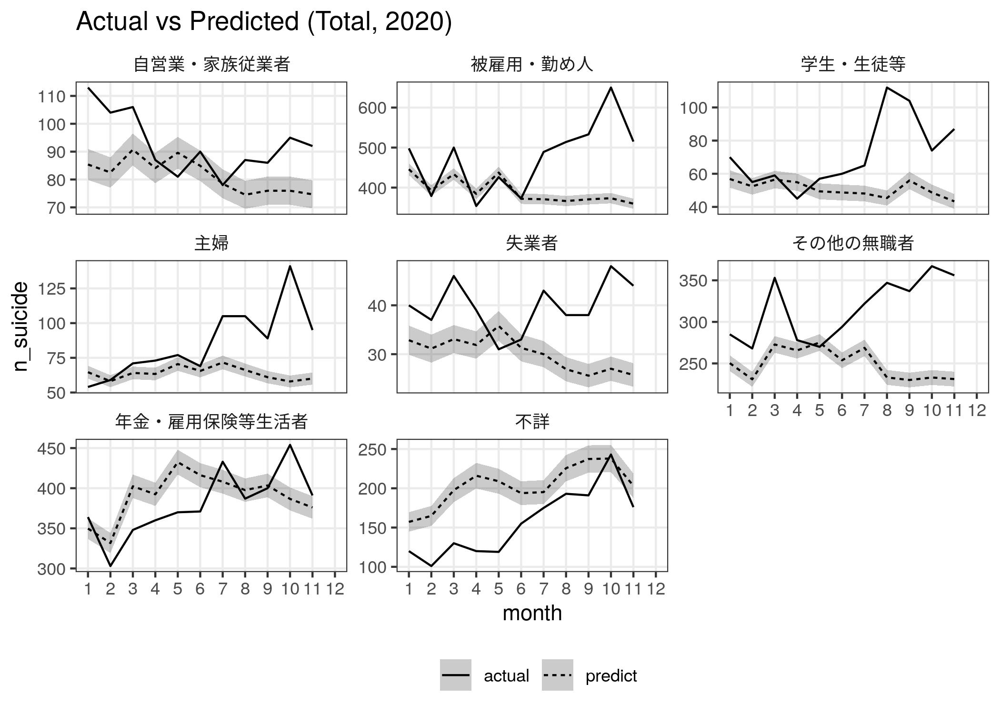

In [86]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- glm(n_suicide ~ factor(month)*occup + year*occup + time*occup + occup,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(occup), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-occup-2020.png", width=7, height=5)

saved to ggtmp/1612410253.jpg


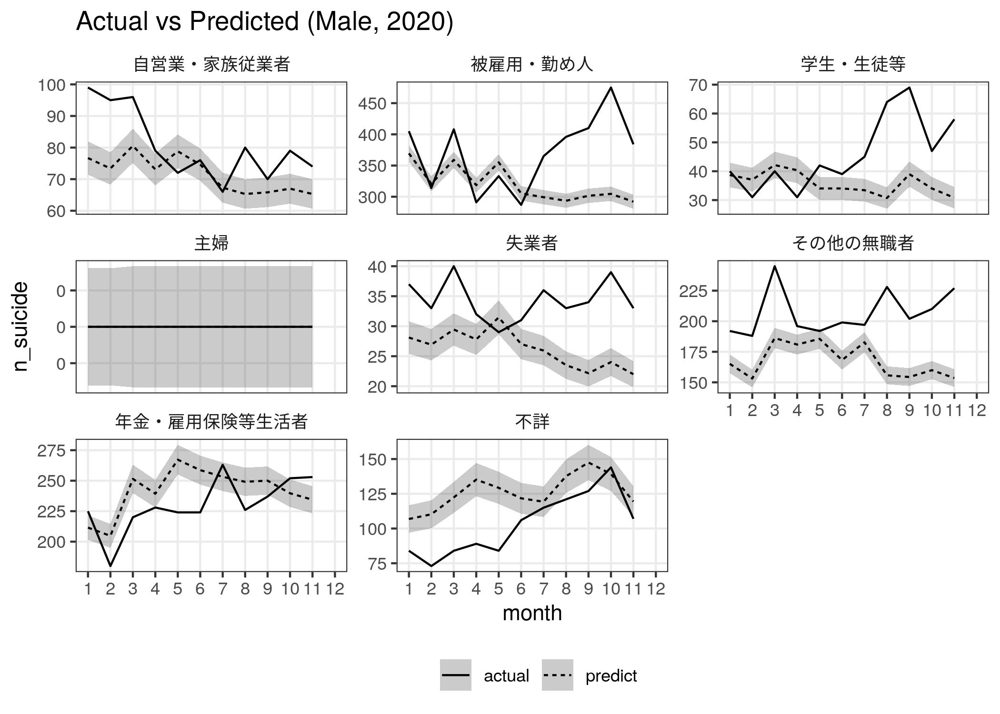

In [83]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- glm(n_suicide ~ factor(month)*occup + year*occup + time*occup + occup,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(occup), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-occup-male-2020.png", width=7, height=5)

saved to ggtmp/1612410255.jpg


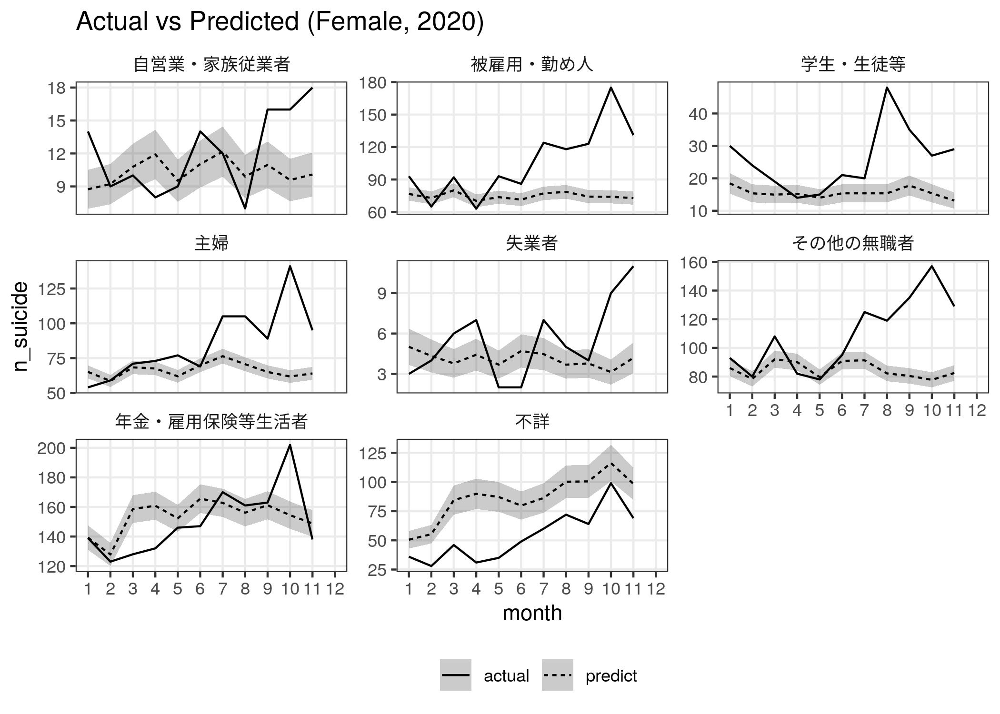

In [84]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- glm(n_suicide ~ factor(month)*occup + year*occup + time*occup + occup,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(occup), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-occup-female-2020.png", width=7, height=5)

# 手法

In [63]:
x <- npa("
select
   time || '-01' as time
  ,cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,sex
  ,means
  ,sum(n_suicide) as n_suicide
from
  a5_means
where
  geocode=0
group by
  time, sex, means 
order by
  time, sex, means
") %>%
  mutate(time=as.Date(time))
levels <- c("首つり", "服毒", "練炭等", "飛降り", "飛込み", "その他", "不詳")
x$means <- factor(x$means, levels=levels)
head(x)

time,year,month,sex,means,n_suicide
<date>,<int>,<int>,<chr>,<fct>,<dbl>
2009-01-01,2009,1,female,その他,141
2009-01-01,2009,1,female,不詳,1
2009-01-01,2009,1,female,服毒,55
2009-01-01,2009,1,female,練炭等,63
2009-01-01,2009,1,female,飛込み,23
2009-01-01,2009,1,female,飛降り,102


saved to ggtmp/1612409377.jpg


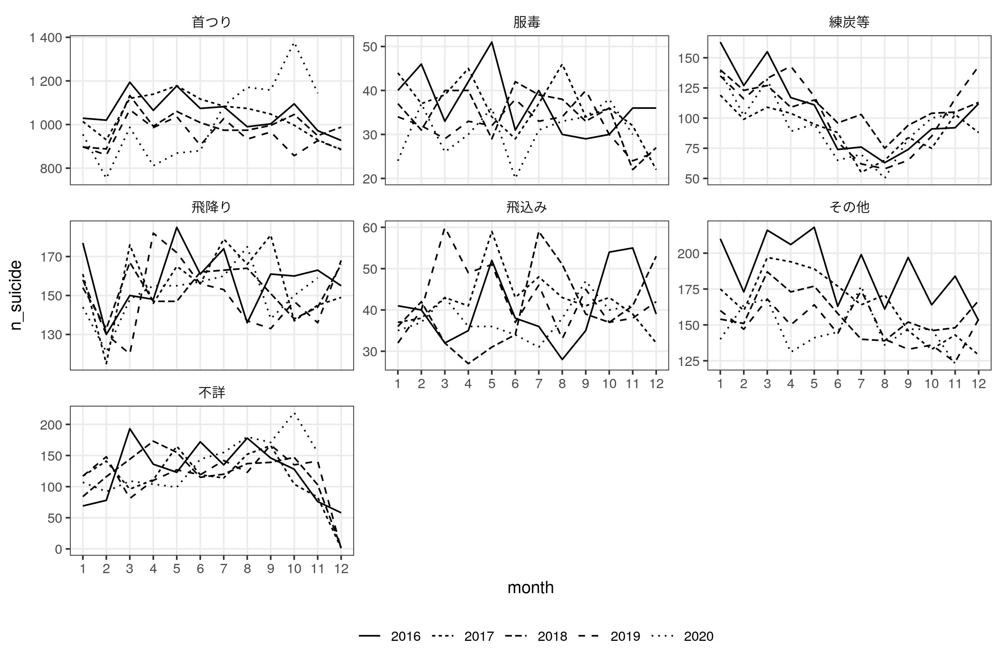

saved to ggtmp/1612409378.jpg


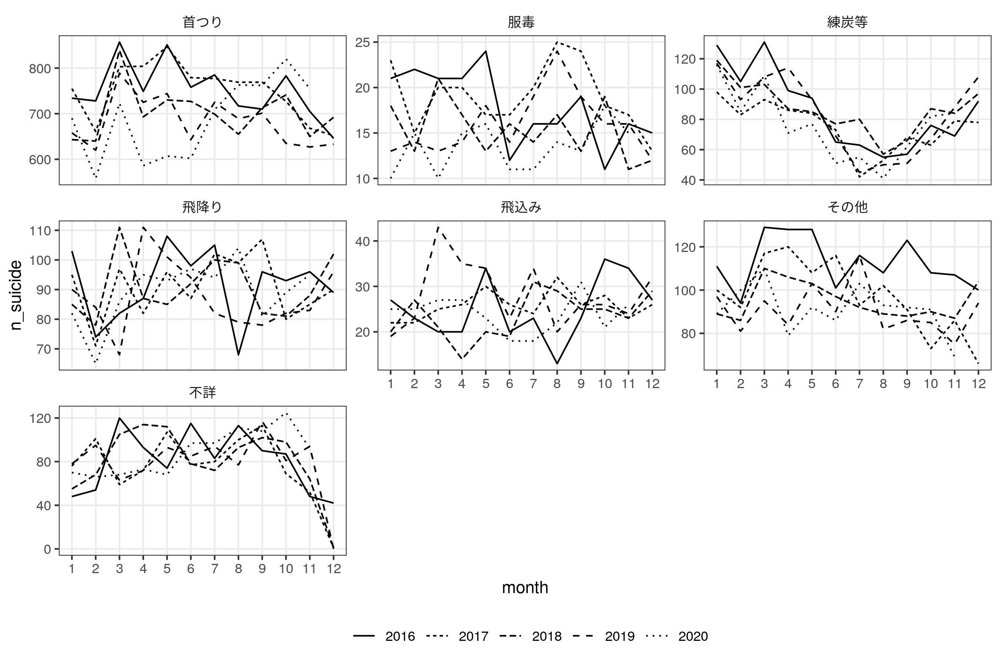

saved to ggtmp/1612409378.jpg


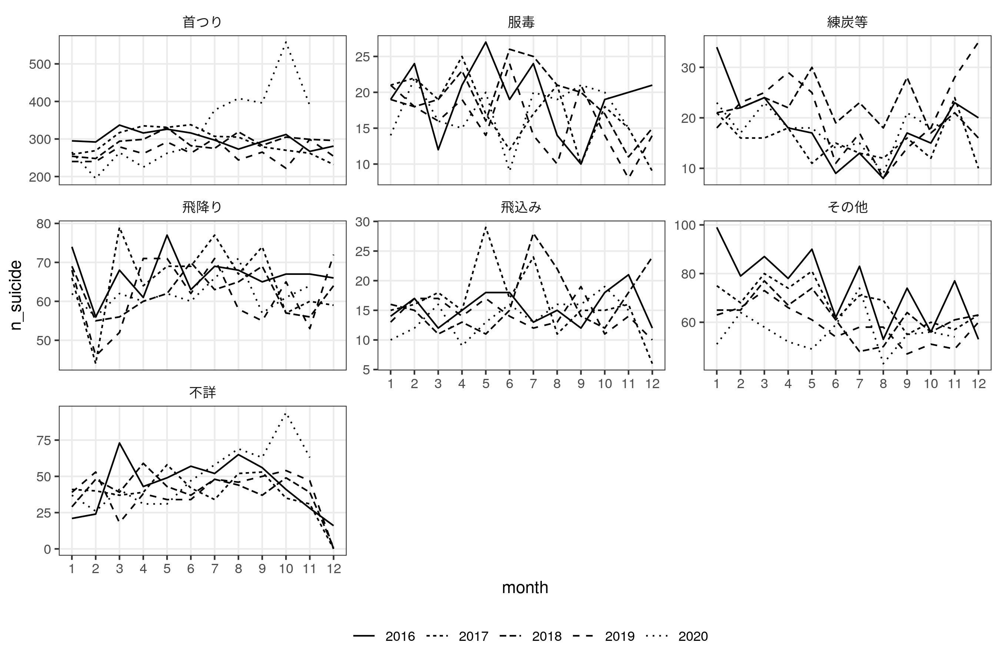

In [66]:
g <- filter(x, year>2015, sex=="total") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(means), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)

g <- filter(x, year>2015, sex=="male") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(means), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)


g <- filter(x, year>2015, sex=="female") %>%
ggplot(aes(month, n_suicide, linetype=factor(year))) +
  geom_line() +
  facet_wrap(vars(means), scales="free_y", ncol=3) +
  scale_x_continuous(breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=9, height=6)

saved to ggtmp/1612409341.jpg


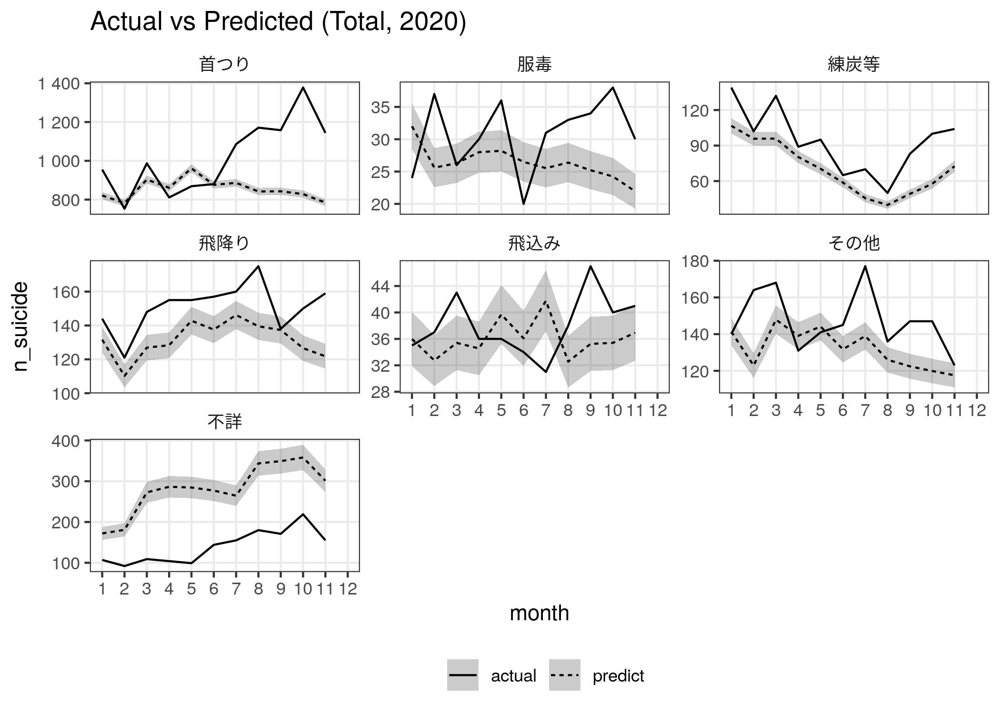

In [65]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-2020.png", width=7, height=5)

saved to ggtmp/1612409213.jpg


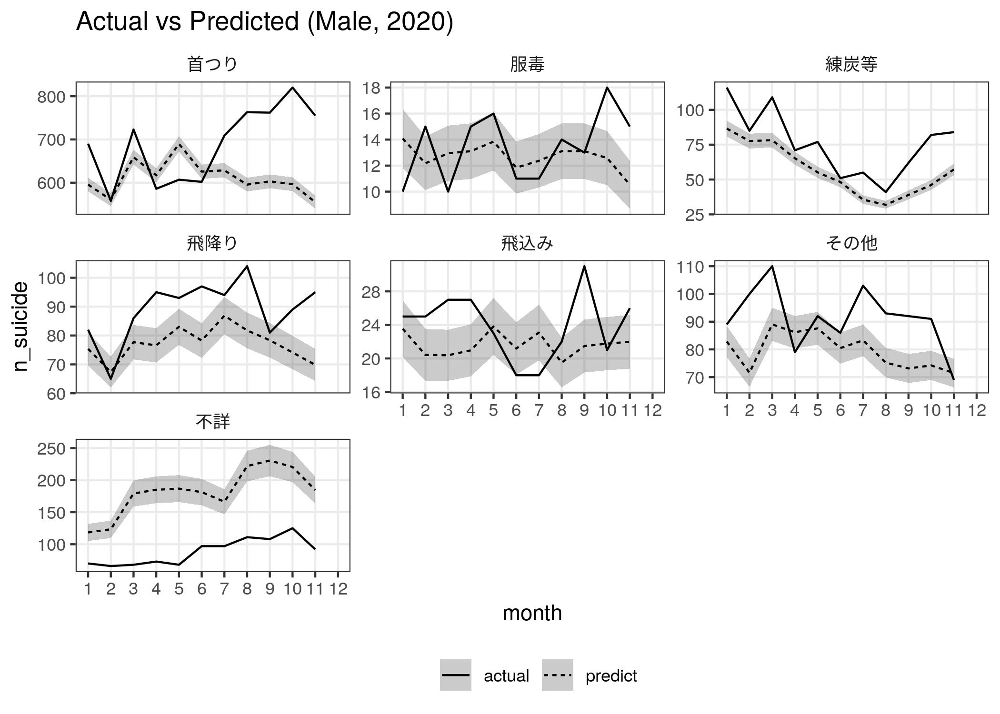

In [37]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-male-2020.png", width=7, height=5)

saved to ggtmp/1612409214.jpg


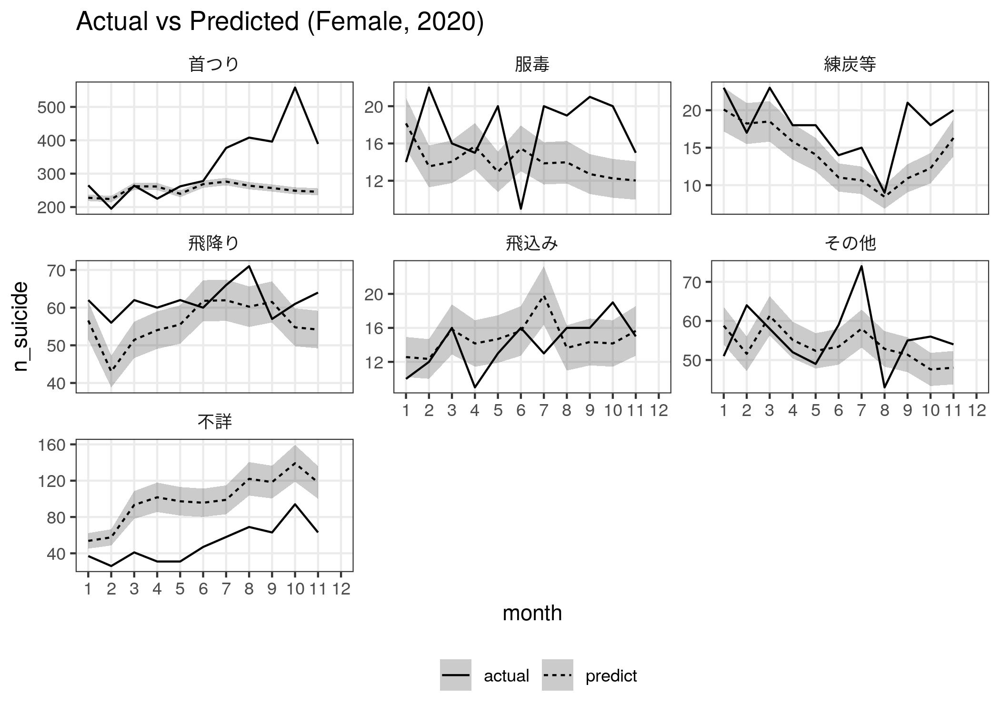

In [38]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-female-2020.png", width=7, height=5)

saved to ggtmp/1612409215.jpg


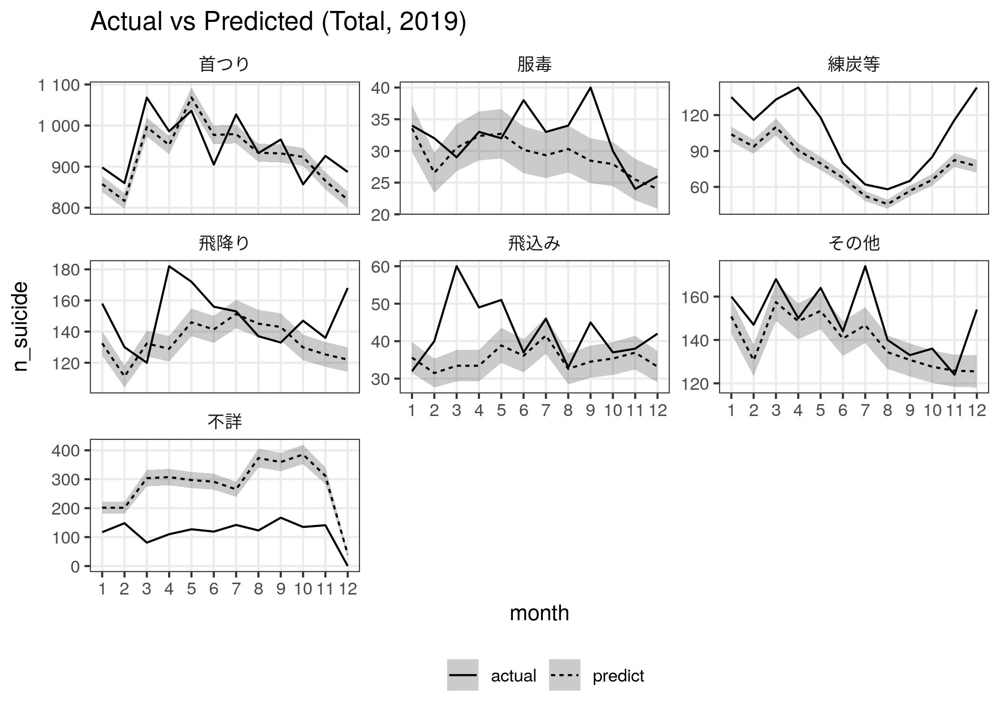

In [39]:
traindata <- filter(x, year %in% 2010:2018, sex=="total")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="total")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-2019.png", width=7, height=5)

saved to ggtmp/1612409217.jpg


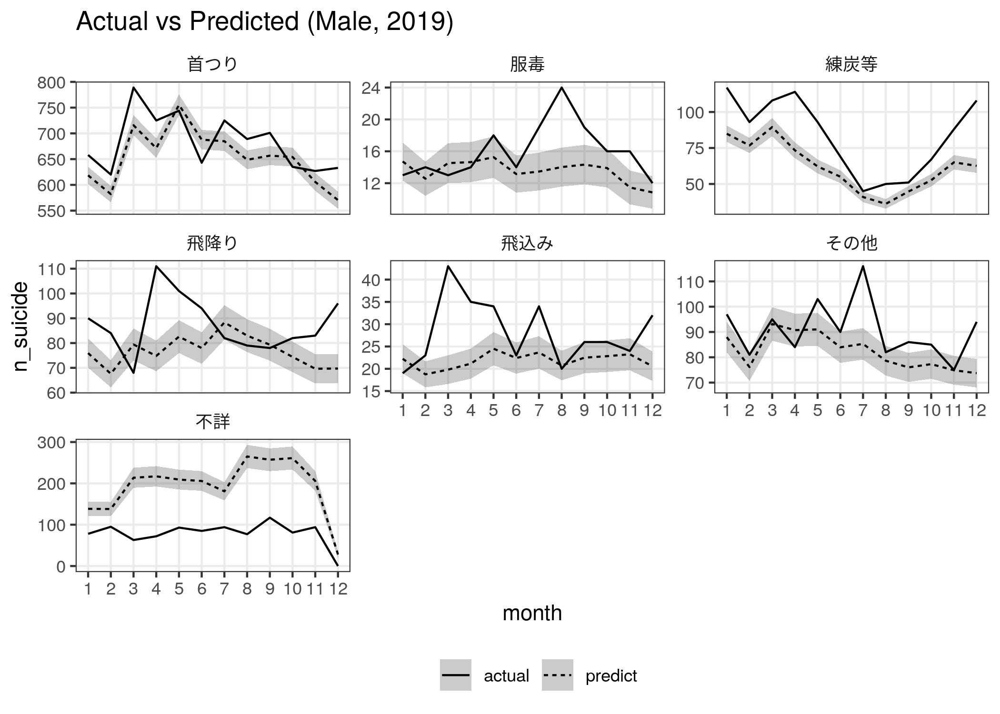

In [40]:
traindata <- filter(x, year %in% 2010:2018, sex=="male")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="male")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-male-2019.png", width=7, height=5)

saved to ggtmp/1612409218.jpg


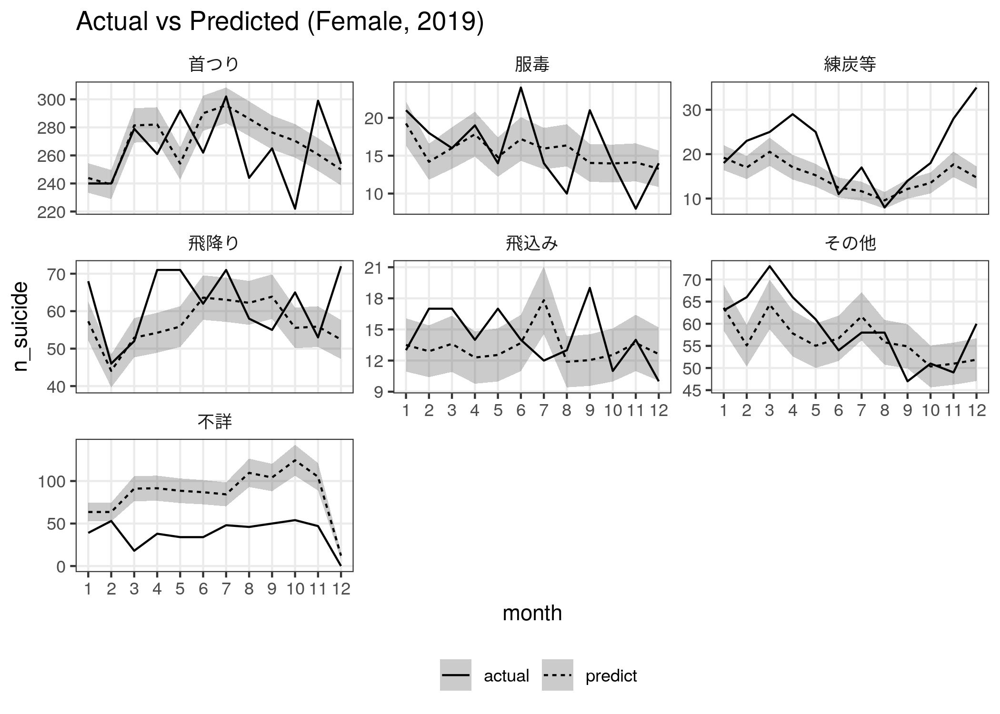

In [41]:
traindata <- filter(x, year %in% 2010:2018, sex=="female")
model <- glm(n_suicide ~ factor(month)*means + year*means + time*means + means,
             data=traindata, family="poisson")
pred <- predict(model, type="response", se.fit=TRUE)
g <- qplot(traindata$n_suicide, pred$fit, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
#ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="female")
pred <- predict(model, newdata=w, type="response", se.fit=TRUE) %>% 
  as.data.frame() %>%
  mutate(lwr = fit - 2*se.fit, upr = fit + 2*se.fit)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred$fit, type="predict"))
g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(means), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-means-female-2019.png", width=7, height=5)

# Age group

In [42]:
x <- npa("
select
   time || '-01' as time
  ,cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,age
  ,sex
  ,sum(n_suicide) as n_suicide
from
  a5_age
where
  geocode=0
  and age <> '不詳'
group by
  time, age, sex 
order by
  time, age, sex
") %>%
  mutate(time=as.Date(time))
ages <- c('20歳未満', '20-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80歳以上')
x$age <- factor(x$age, levels=ages)

saved to ggtmp/1612409219.jpg


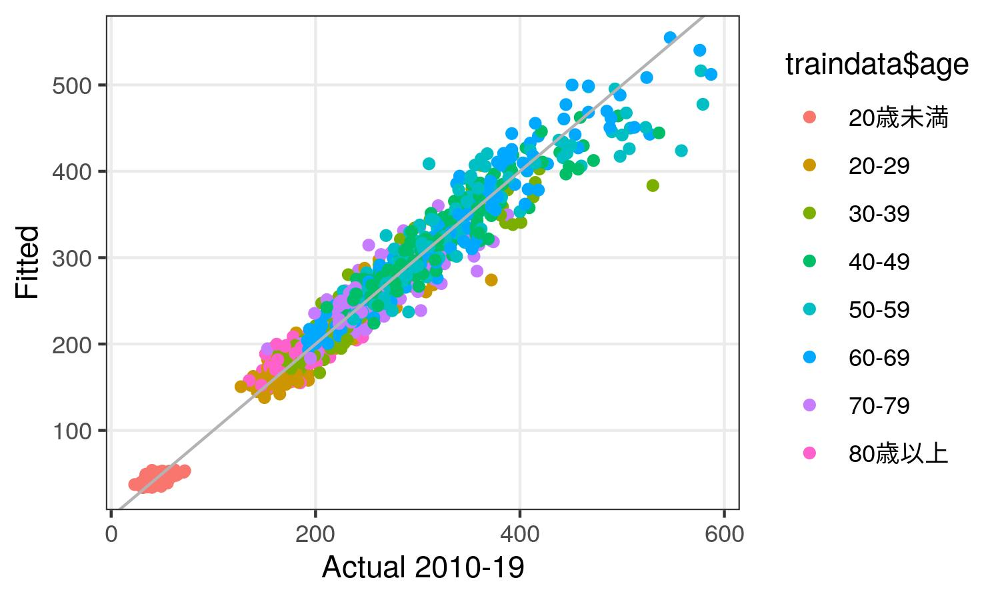

saved to ggtmp/1612409220.jpg


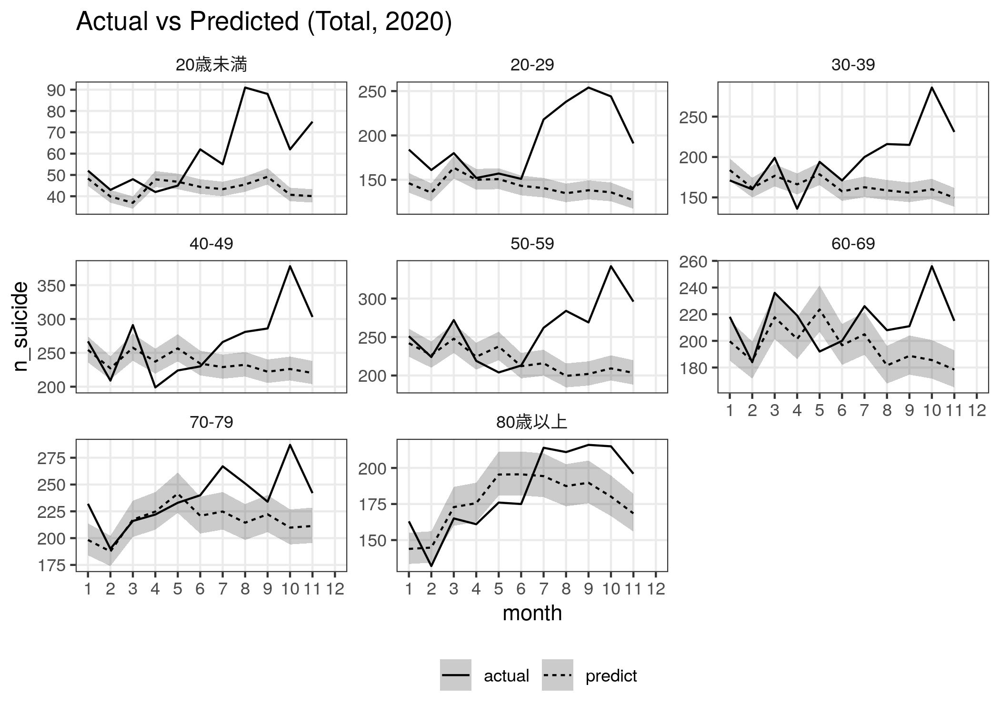

In [43]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-2020.png", width=7, height=5)

saved to ggtmp/1612409222.jpg


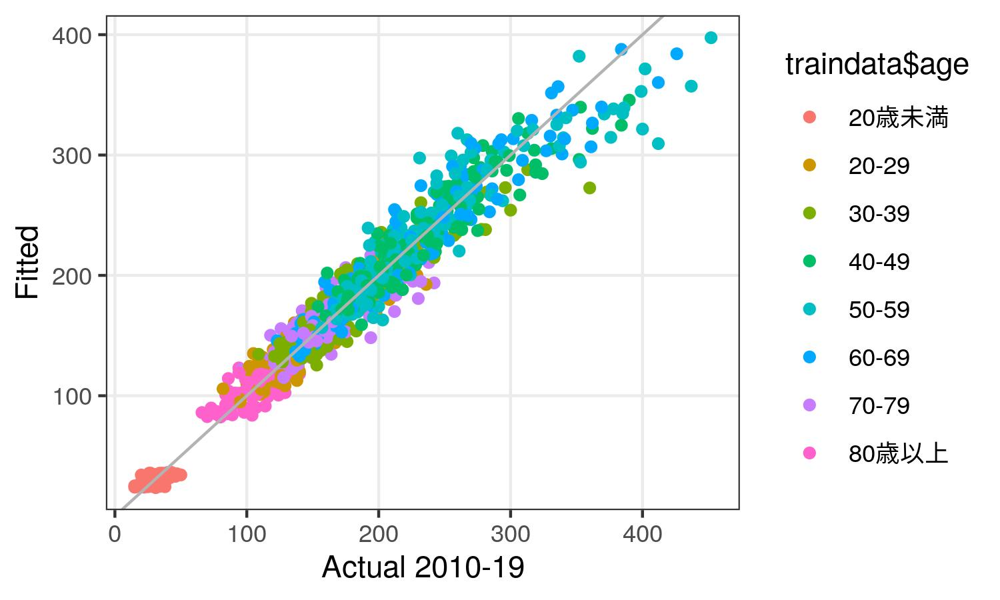

saved to ggtmp/1612409222.jpg


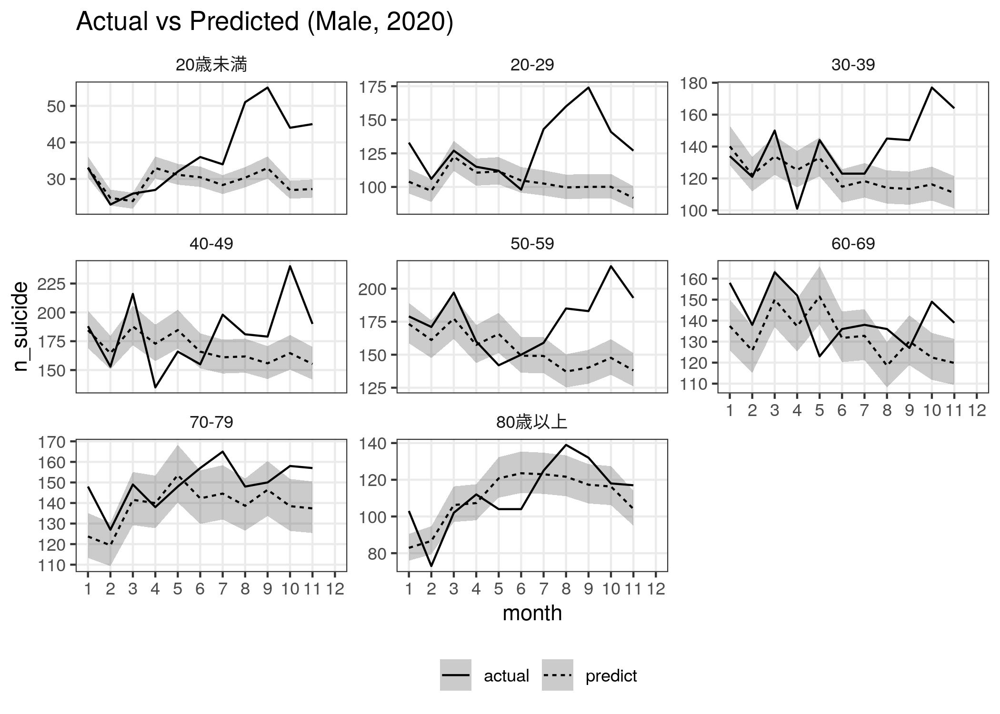

In [44]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-male-2020.png", width=7, height=5)

saved to ggtmp/1612409225.jpg


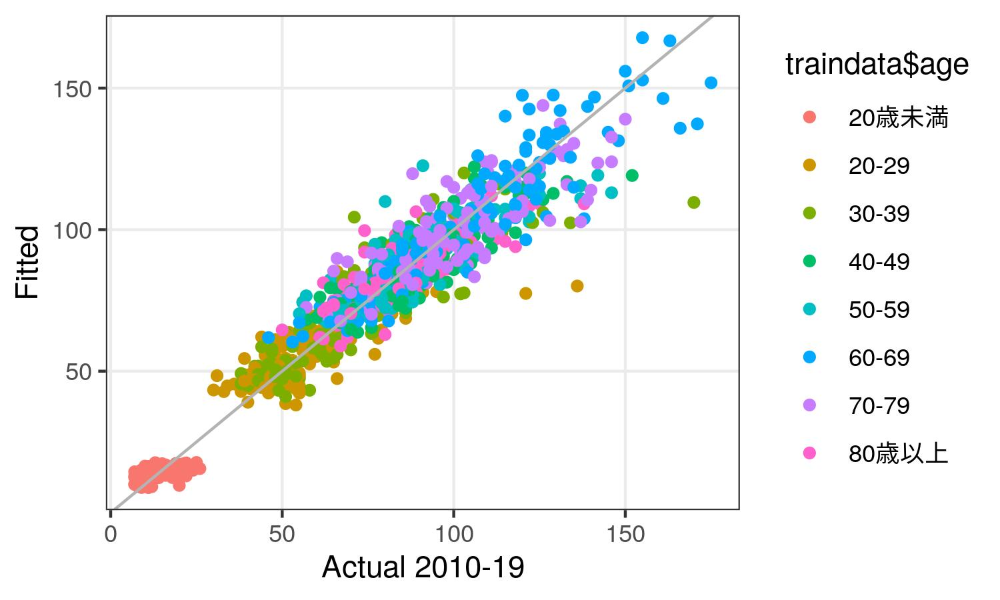

saved to ggtmp/1612409225.jpg


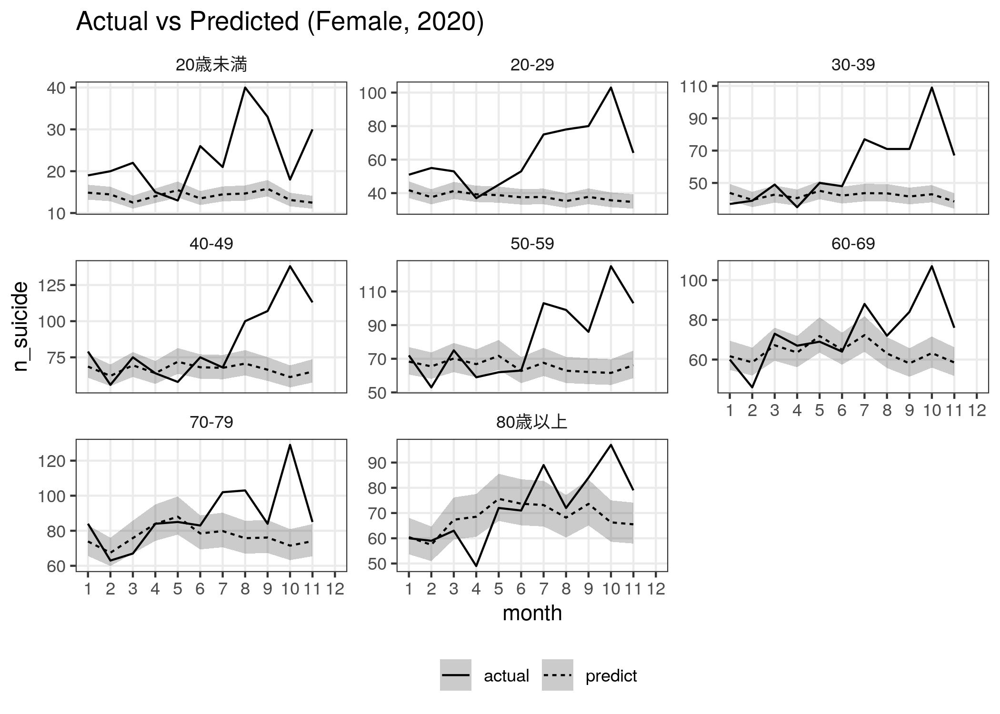

In [45]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-female-2020.png", width=7, height=5)

## 2019

saved to ggtmp/1612409227.jpg


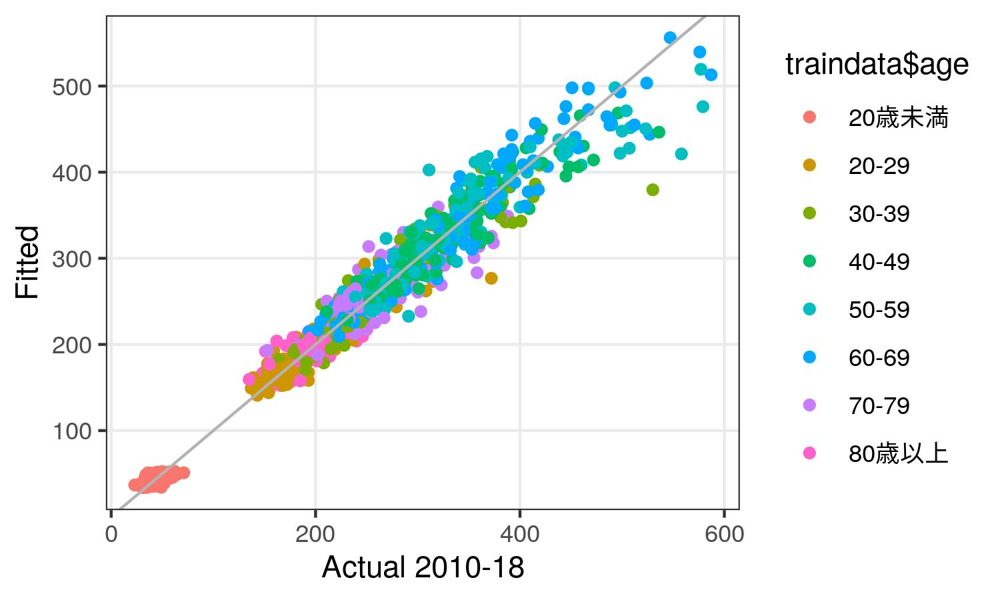

saved to ggtmp/1612409228.jpg


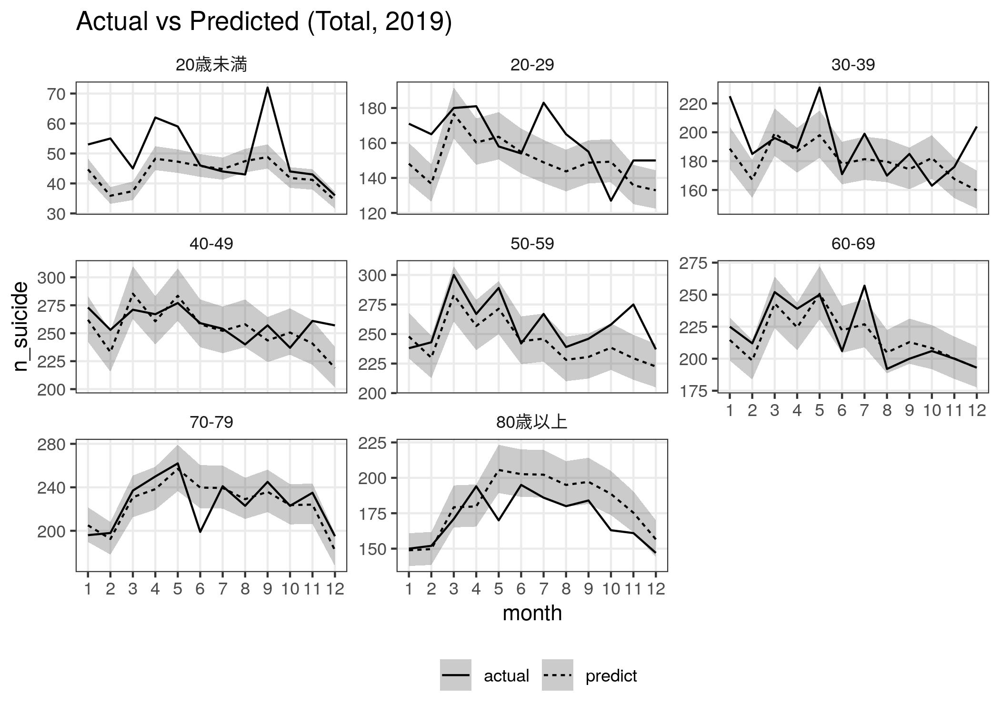

In [46]:
traindata <- filter(x, year %in% 2010:2018, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-2019.png", width=7, height=5)

saved to ggtmp/1612409230.jpg


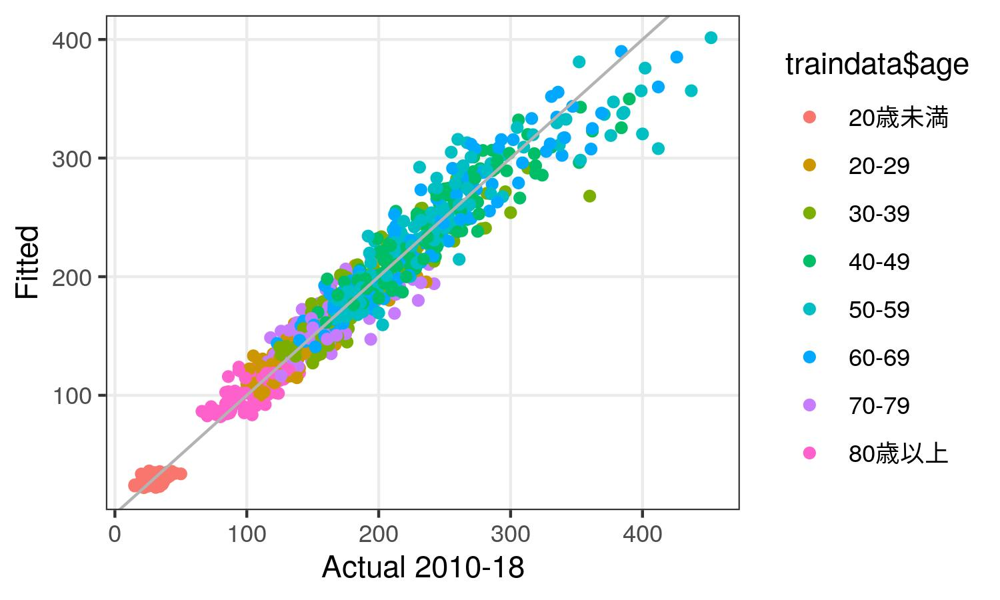

saved to ggtmp/1612409230.jpg


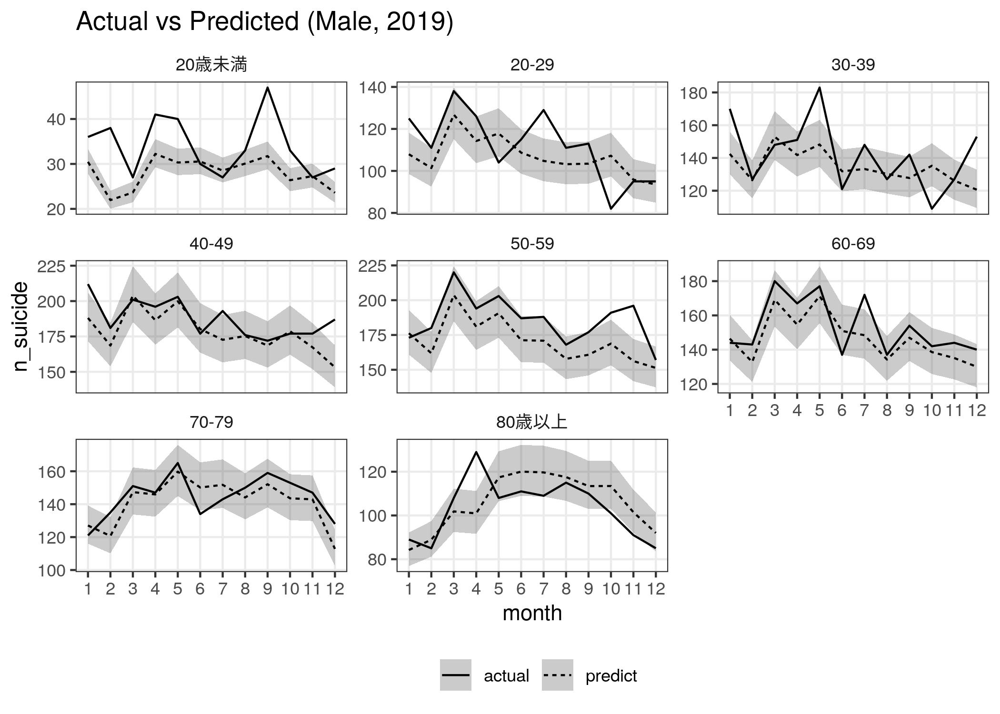

In [47]:
traindata <- filter(x, year %in% 2010:2018, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-male-2019.png", width=7, height=5)

saved to ggtmp/1612409232.jpg


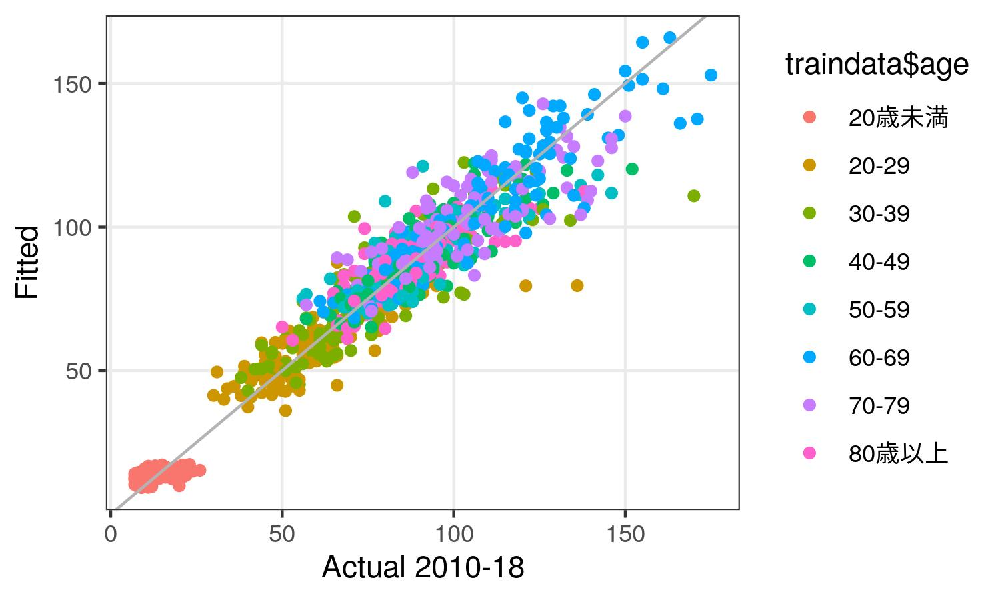

saved to ggtmp/1612409232.jpg


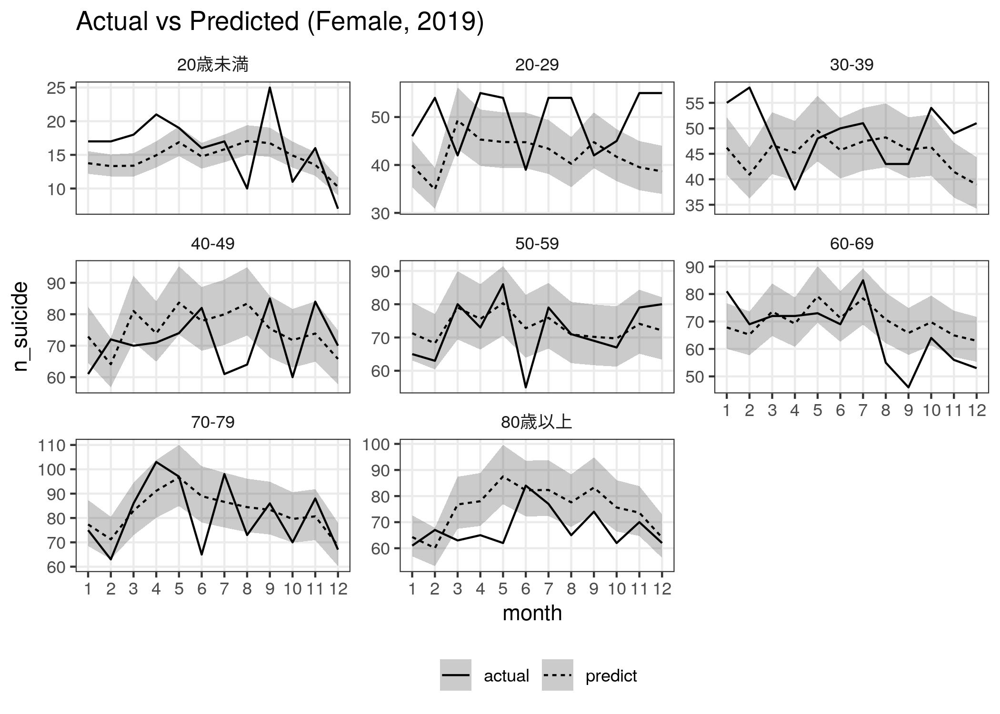

In [48]:
traindata <- filter(x, year %in% 2010:2018, sex=="female")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-female-2019.png", width=7, height=5)

## Fix axis scale

saved to ggtmp/1612409234.jpg


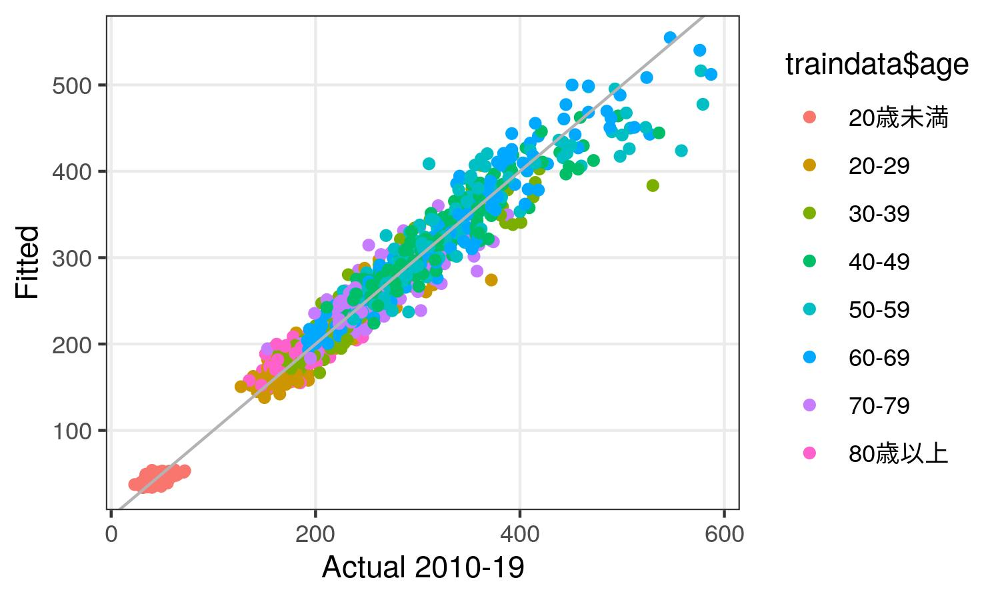

saved to ggtmp/1612409234.jpg


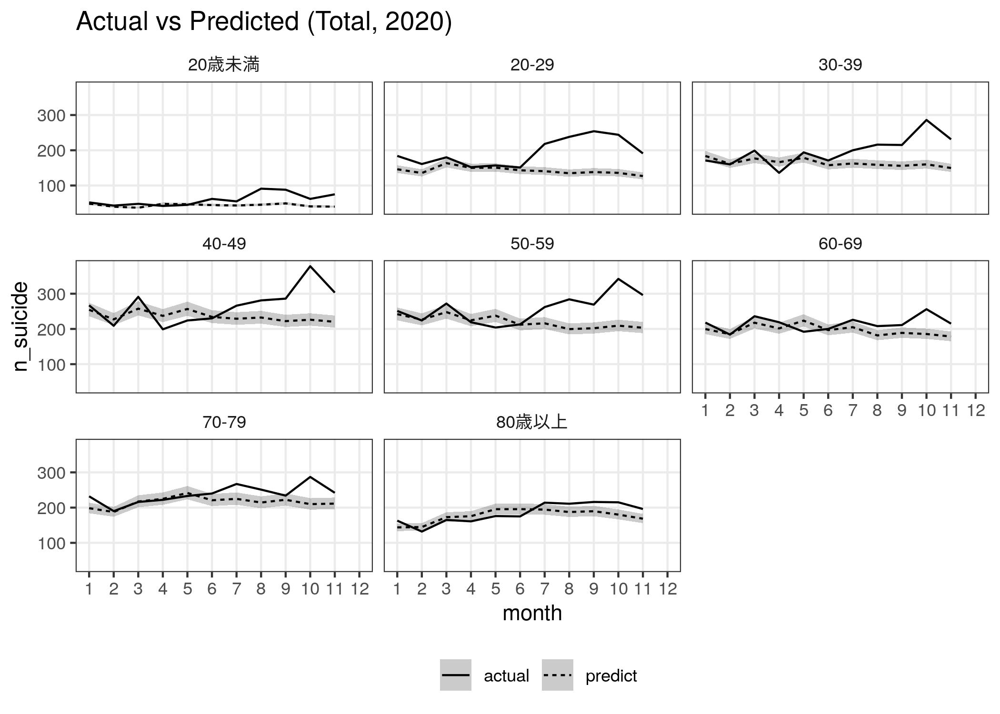

In [49]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-2020-fixscale.png", width=7, height=5)

saved to ggtmp/1612409236.jpg


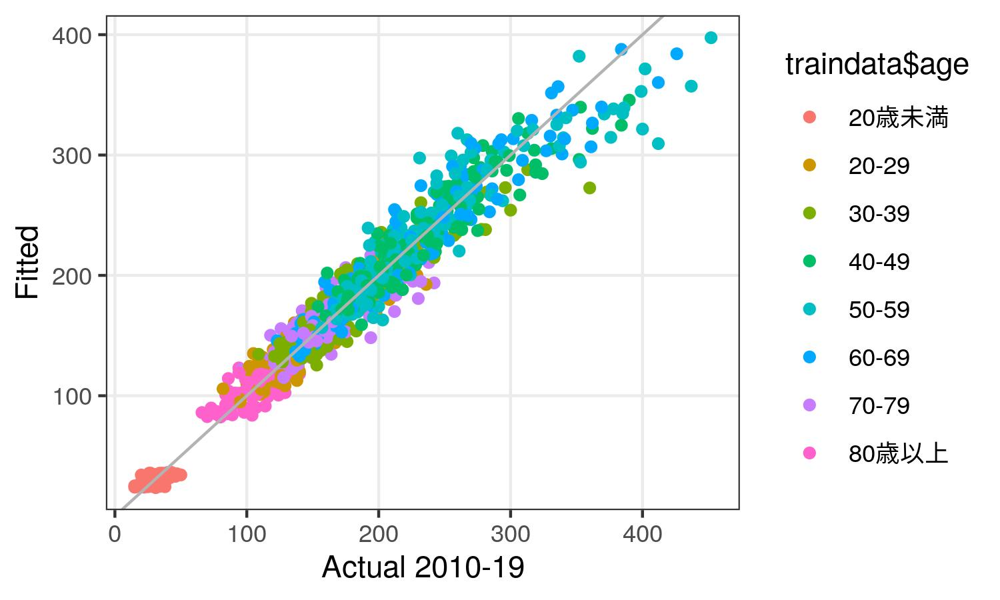

saved to ggtmp/1612409236.jpg


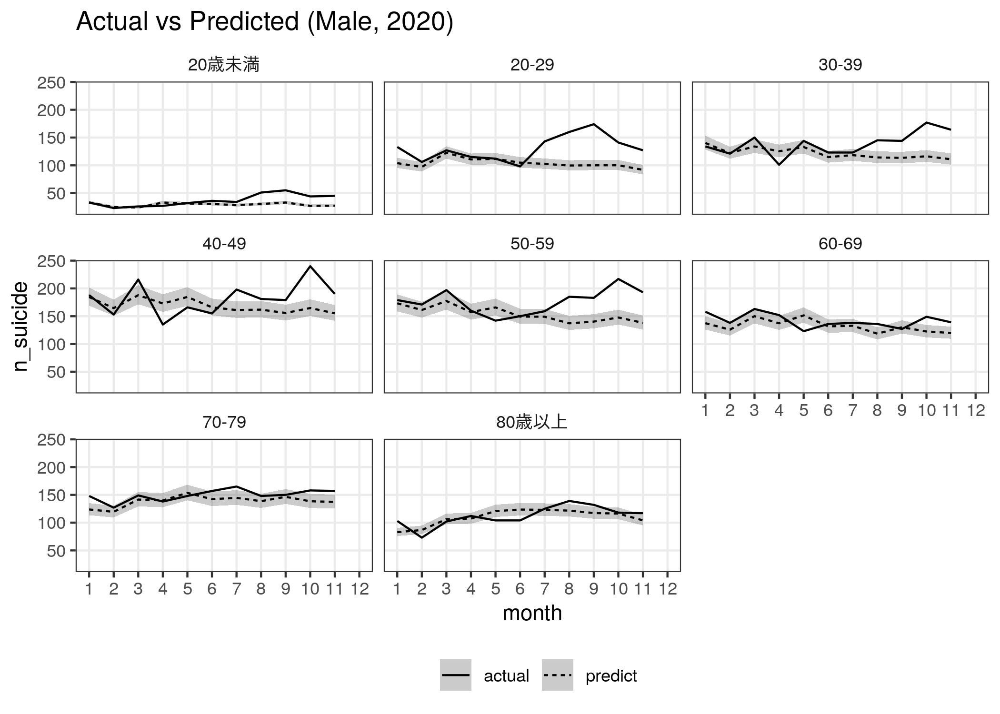

In [50]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-male-2020-fixscale.png", width=7, height=5)

saved to ggtmp/1612409237.jpg


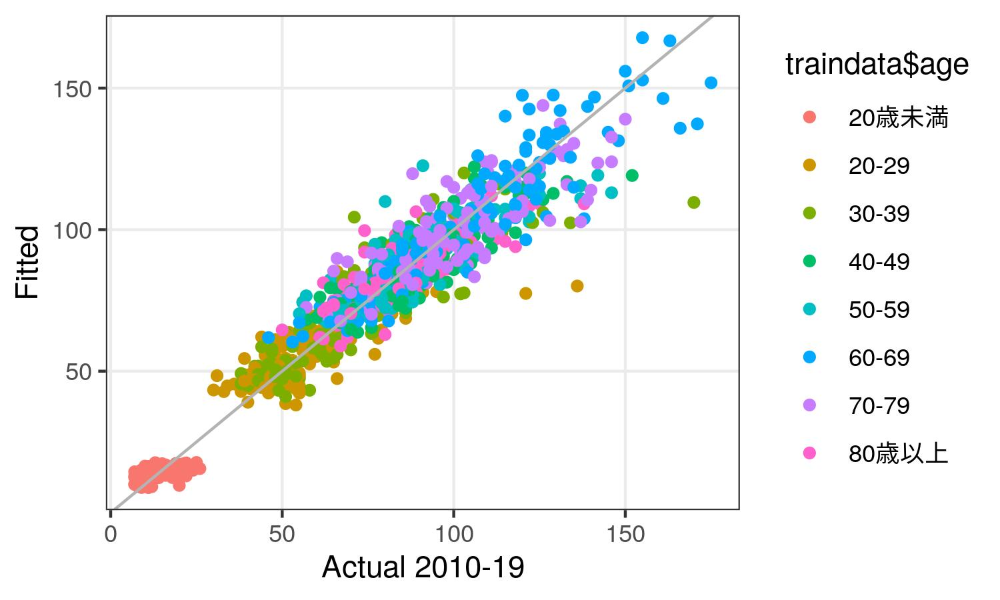

saved to ggtmp/1612409238.jpg


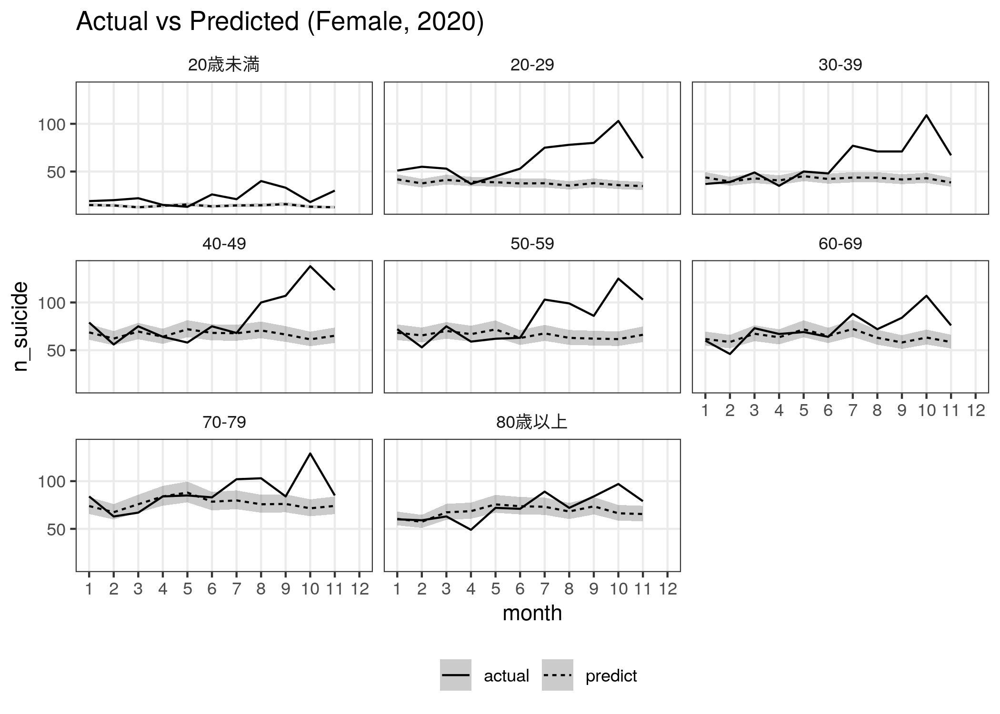

In [51]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-female-2020-fixscale.png", width=7, height=5)

saved to ggtmp/1612409239.jpg


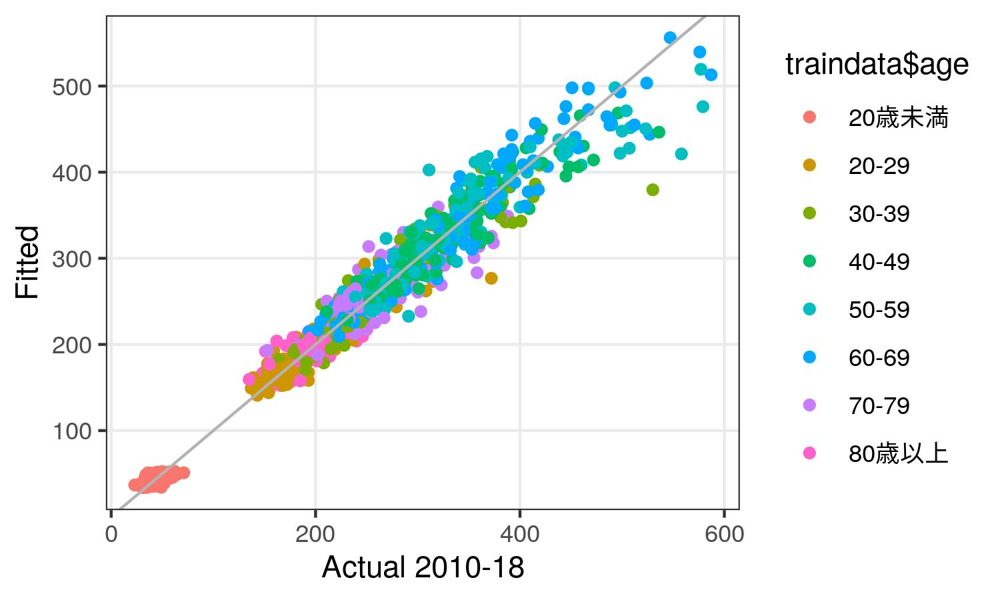

saved to ggtmp/1612409239.jpg


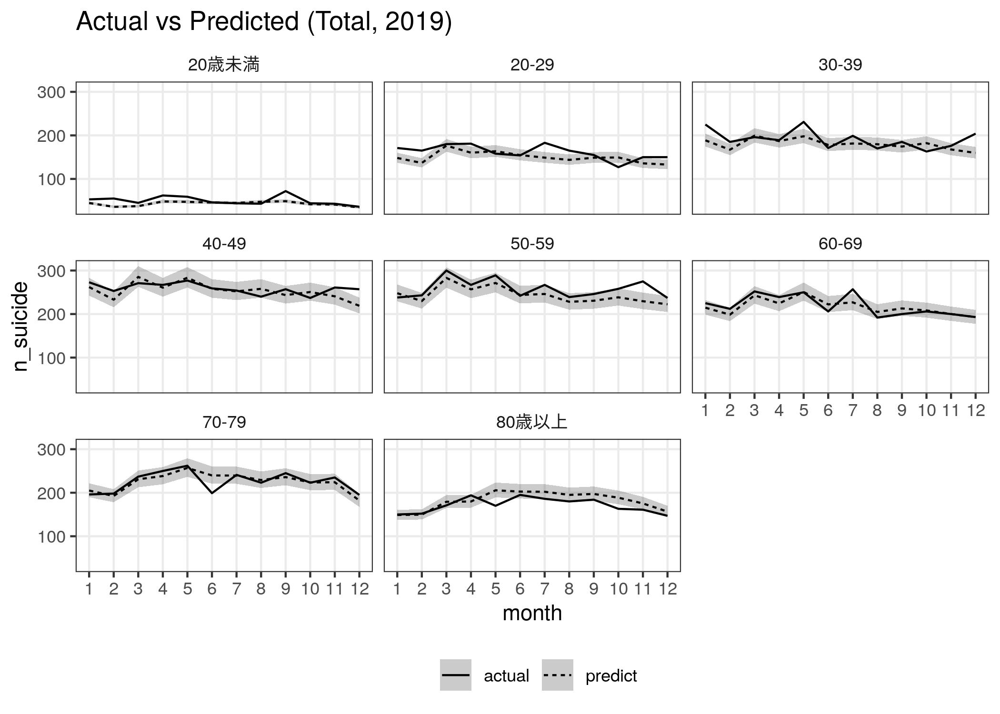

In [52]:
traindata <- filter(x, year %in% 2010:2018, sex=="total")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-2019-fixscale.png", width=7, height=5)

saved to ggtmp/1612409240.jpg


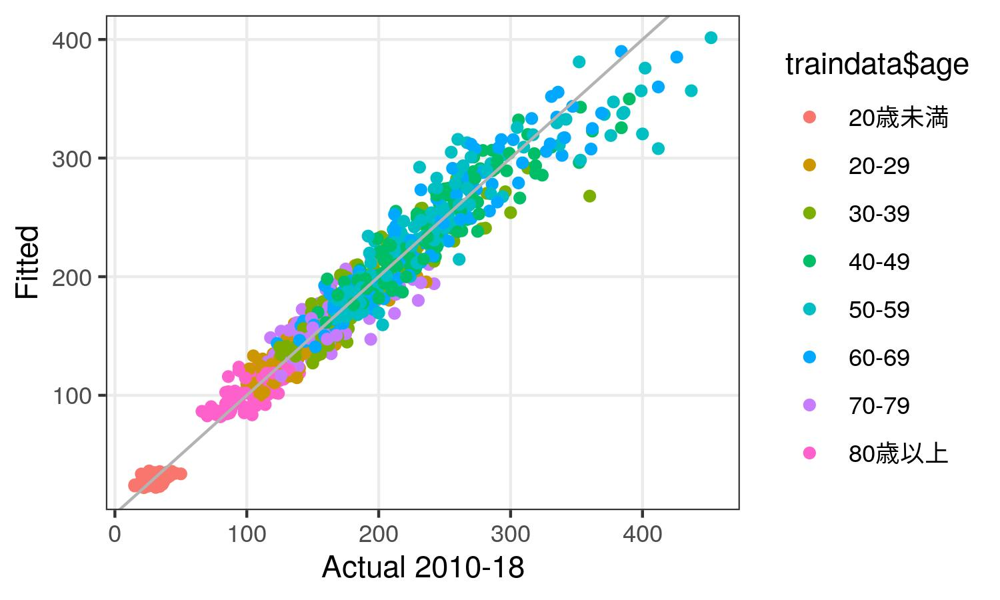

saved to ggtmp/1612409241.jpg


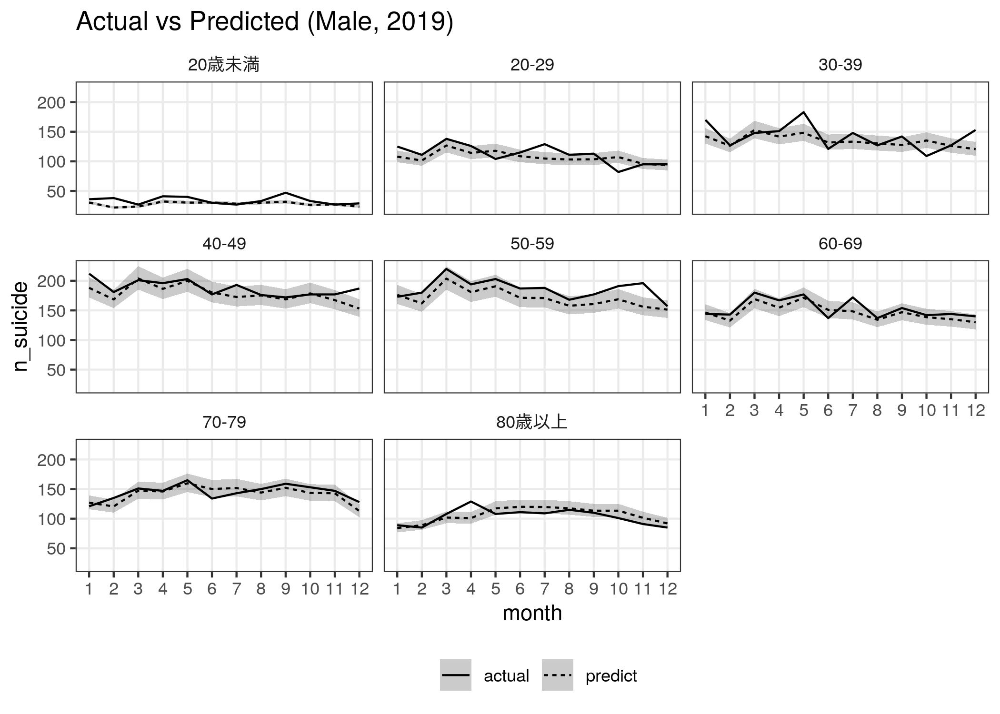

In [53]:
traindata <- filter(x, year %in% 2010:2018, sex=="male")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-male-2019-fixscale.png", width=7, height=5)

saved to ggtmp/1612409242.jpg


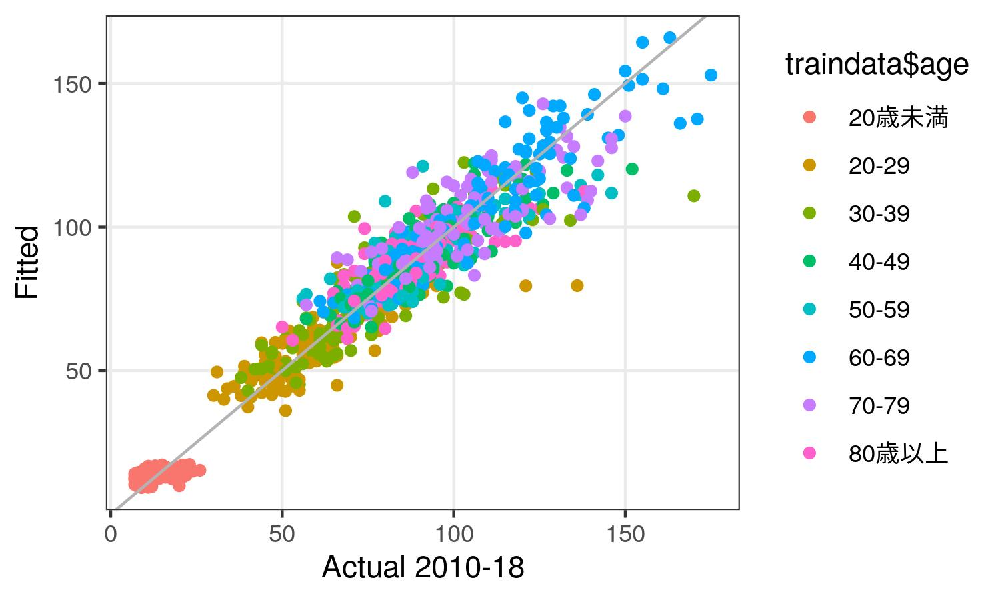

saved to ggtmp/1612409242.jpg


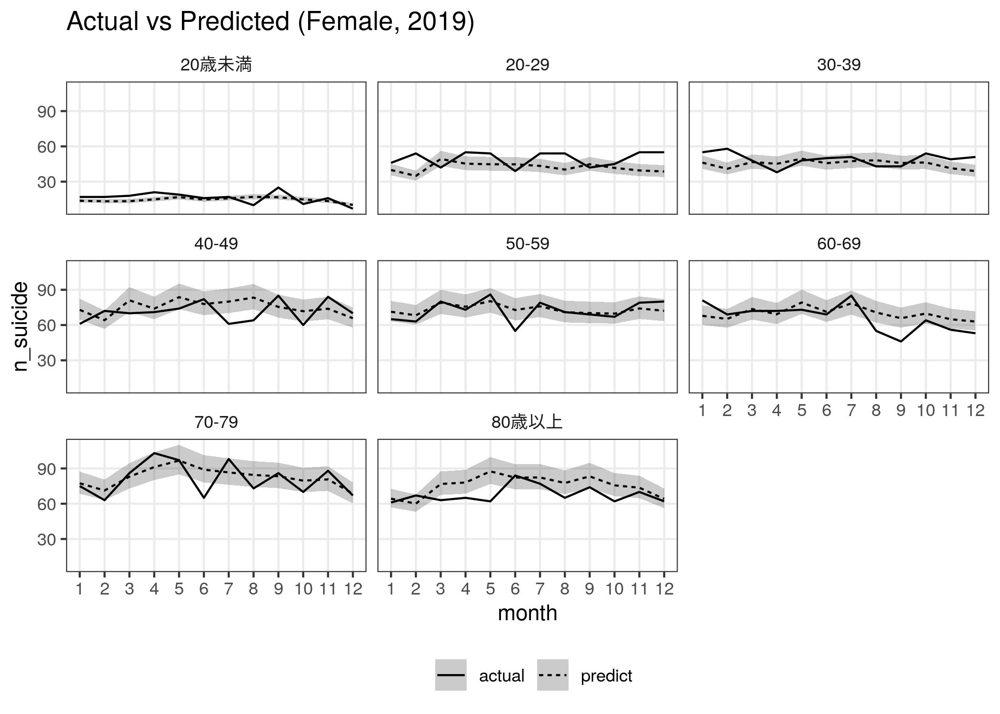

In [54]:
traindata <- filter(x, year %in% 2010:2018, sex=="female")
model <- lm(log(n_suicide) ~ factor(month)*age + year*age + time*age + age,
            data=traindata)
pred <- predict(model) %>% exp()
g <- qplot(traindata$n_suicide, pred, color=traindata$age) +
  xlab("Actual 2010-18") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2019, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp()
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(age)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2019)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 900, width=7, height=5)
ggsave("outputs/actual-v-predicted-by-age-female-2019-fixscale.png", width=7, height=5)

# Prefecture

In [55]:
x <- npa("
select
   time || '-01' as time
  ,cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,sex
  ,geocode
  ,geoname2 as geoname
  ,sum(n_suicide) as n_suicide
from
  a5_age
where
  geocode <> 0
group by
  geocode, geoname2, time, sex
") %>%
  mutate(time=as.Date(time))
prefs <- select(x, geocode, geoname) %>% distinct() %>% arrange(geocode) %>% `[[`("geoname")
x$geoname <- factor(x$geoname, levels=prefs)

y <- mhlw("
select
   time || '-01' as time
  ,cast(substr(time, 1, 4) as int) as year
  ,cast(substr(time, -2) as int) as month
  ,sex
  ,geoname
  ,sum(n_death) as n_suicide
from
  prompt
where substr(geoname, -1) not in ('市', '部', '国', '詳')
group by
  time, sex, geoname
order by
  geoname, time, sex
") %>%
  mutate(time=as.Date(time))
y$geoname <- factor(y$geoname, levels=prefs)

head(x)
head(y)

time,year,month,sex,geocode,geoname,n_suicide
<date>,<int>,<int>,<chr>,<int>,<fct>,<dbl>
2009-01-01,2009,1,female,1,北海道,35
2009-01-01,2009,1,male,1,北海道,76
2009-01-01,2009,1,total,1,北海道,111
2009-02-01,2009,2,female,1,北海道,40
2009-02-01,2009,2,male,1,北海道,84
2009-02-01,2009,2,total,1,北海道,124


time,year,month,sex,geoname,n_suicide
<date>,<int>,<int>,<chr>,<fct>,<dbl>
2010-01-01,2010,1,female,三重県,4
2010-01-01,2010,1,male,三重県,17
2010-02-01,2010,2,female,三重県,15
2010-02-01,2010,2,male,三重県,14
2010-03-01,2010,3,female,三重県,9
2010-03-01,2010,3,male,三重県,22


saved to ggtmp/1612409246.jpg


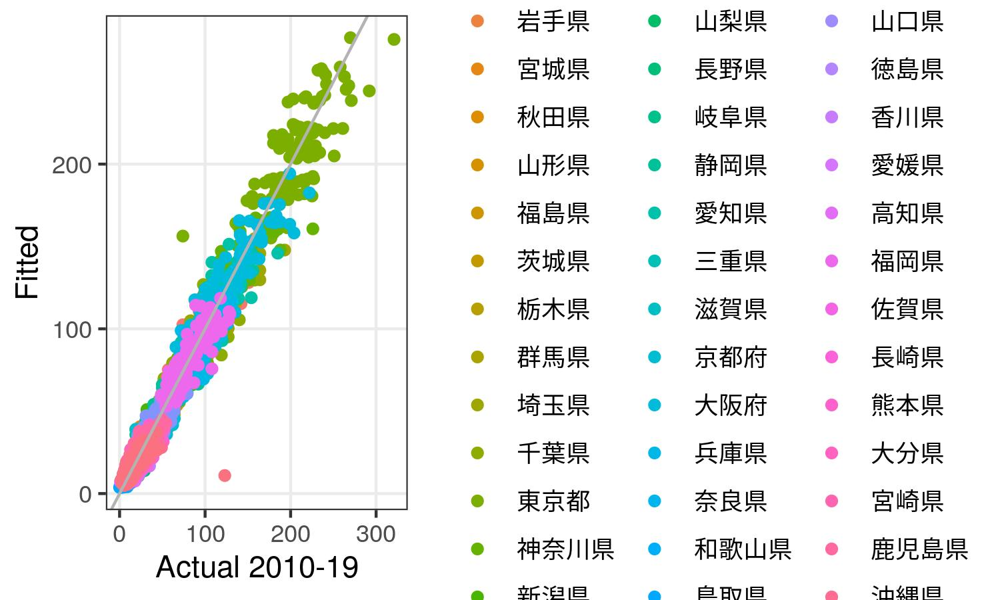

saved to ggtmp/1612409247.jpg


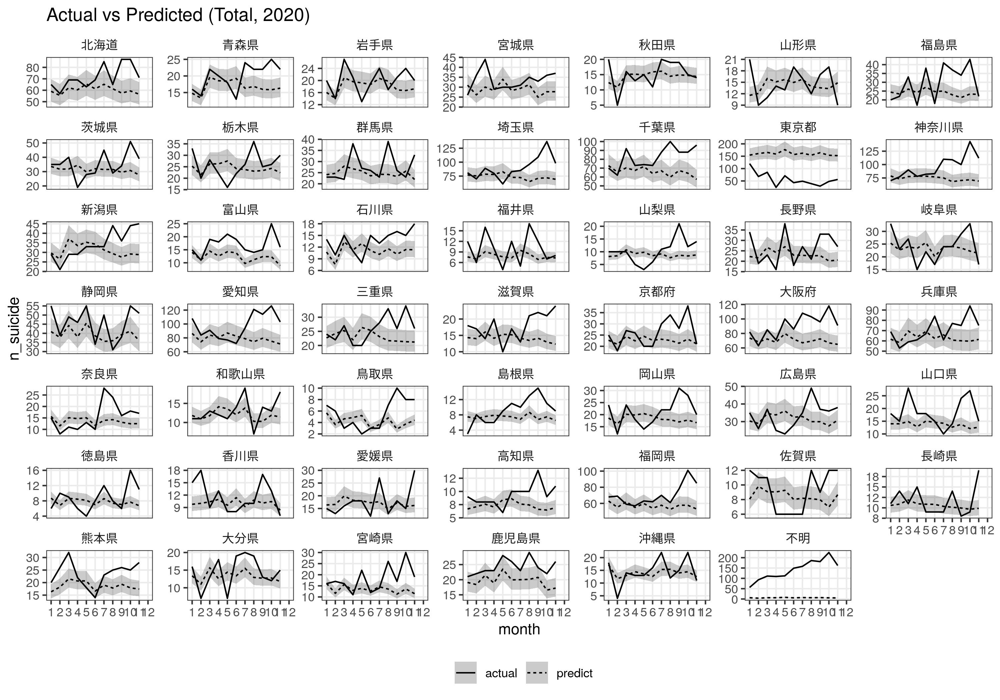

saved to ggtmp/1612409252.jpg


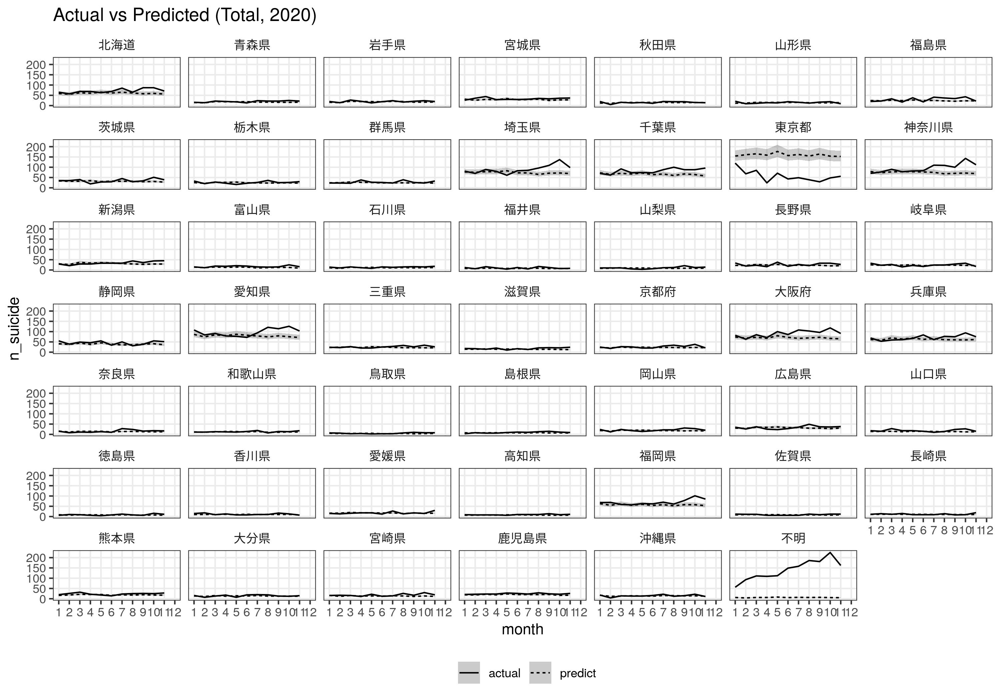

In [56]:
traindata <- filter(x, year %in% 2010:2019, sex=="total")
model <- lm(log(n_suicide+1) ~ factor(month)*geoname + year*geoname + time*geoname + geoname,
            data=traindata)
pred <- (predict(model) %>% exp()) - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$geoname) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="total")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-2020.png", width=10, height=7)


g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Total, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-2020-fixscale.png", width=10, height=7)

saved to ggtmp/1612409258.jpg


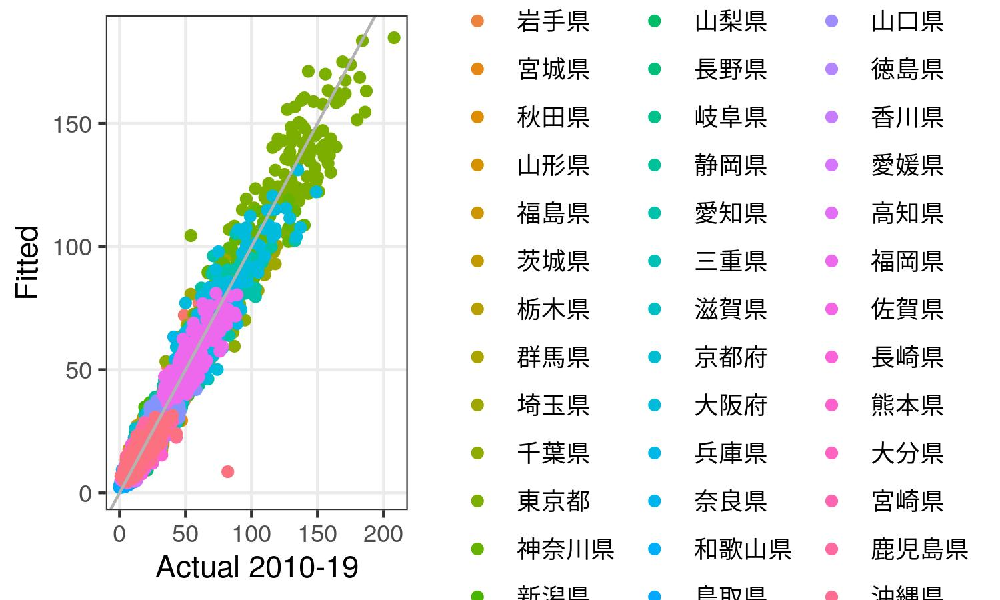

saved to ggtmp/1612409259.jpg


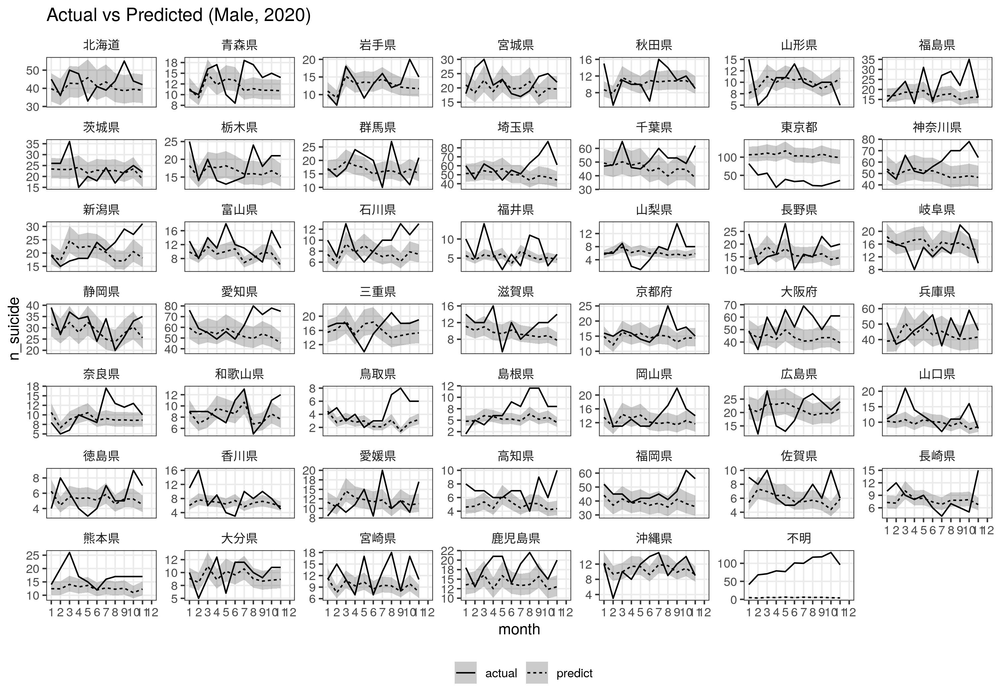

saved to ggtmp/1612409265.jpg


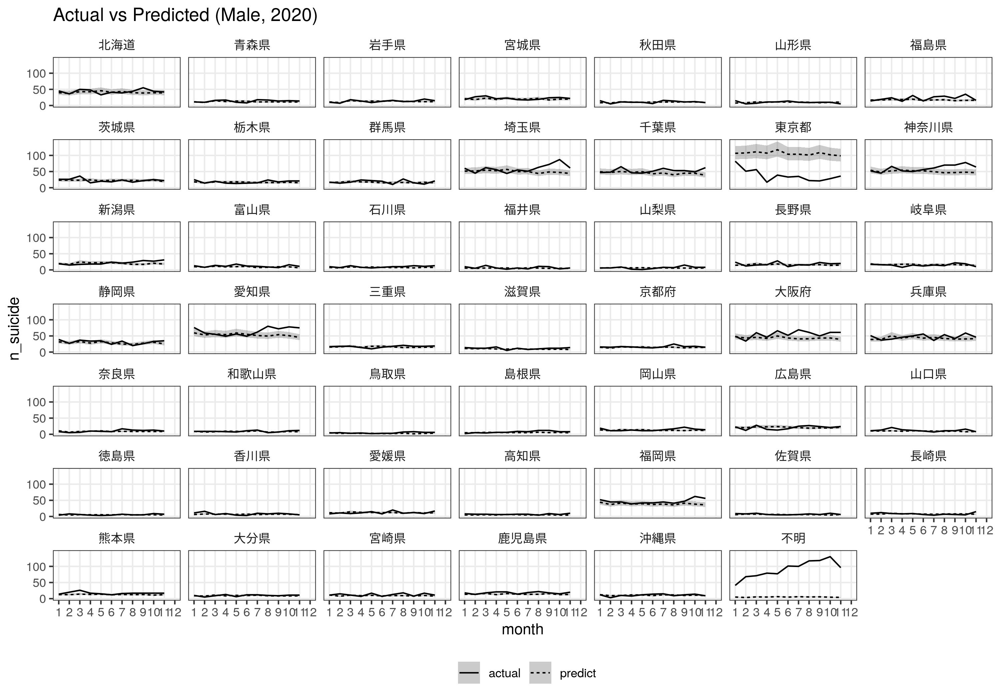

In [57]:
traindata <- filter(x, year %in% 2010:2019, sex=="male")
model <- lm(log(n_suicide+1) ~ factor(month)*geoname + year*geoname + time*geoname + geoname,
            data=traindata)
pred <- (predict(model) %>% exp()) - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$geoname) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-male-2020.png", width=10, height=7)


g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-male-2020-fixscale.png", width=10, height=7)

saved to ggtmp/1612409271.jpg


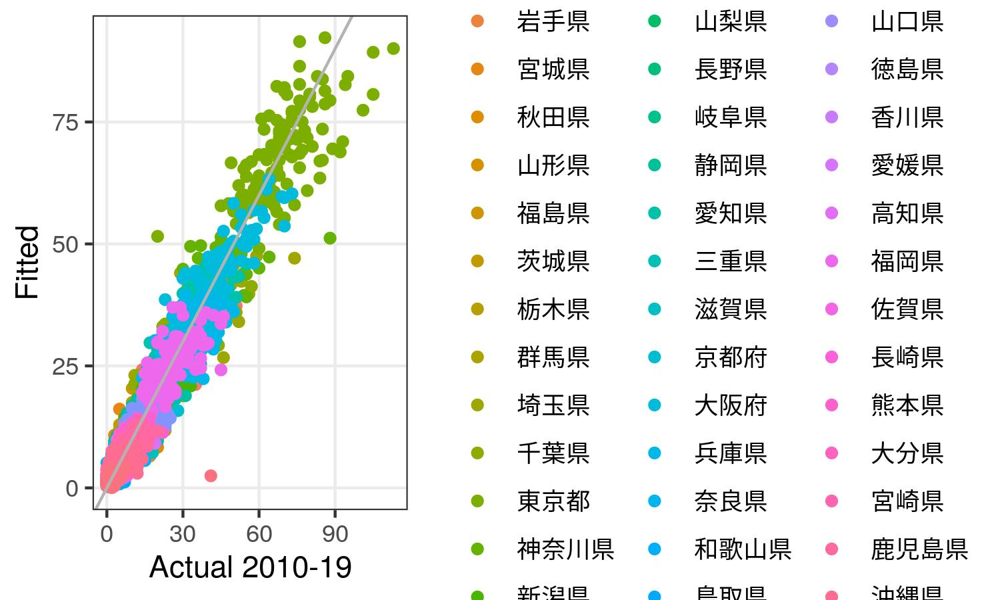

saved to ggtmp/1612409273.jpg


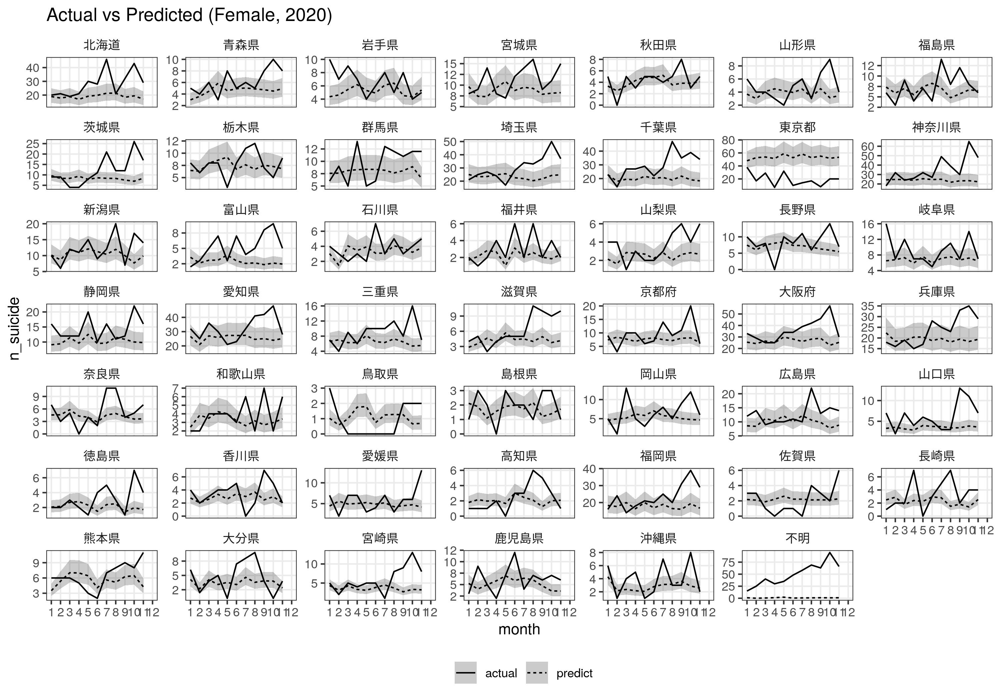

saved to ggtmp/1612409278.jpg


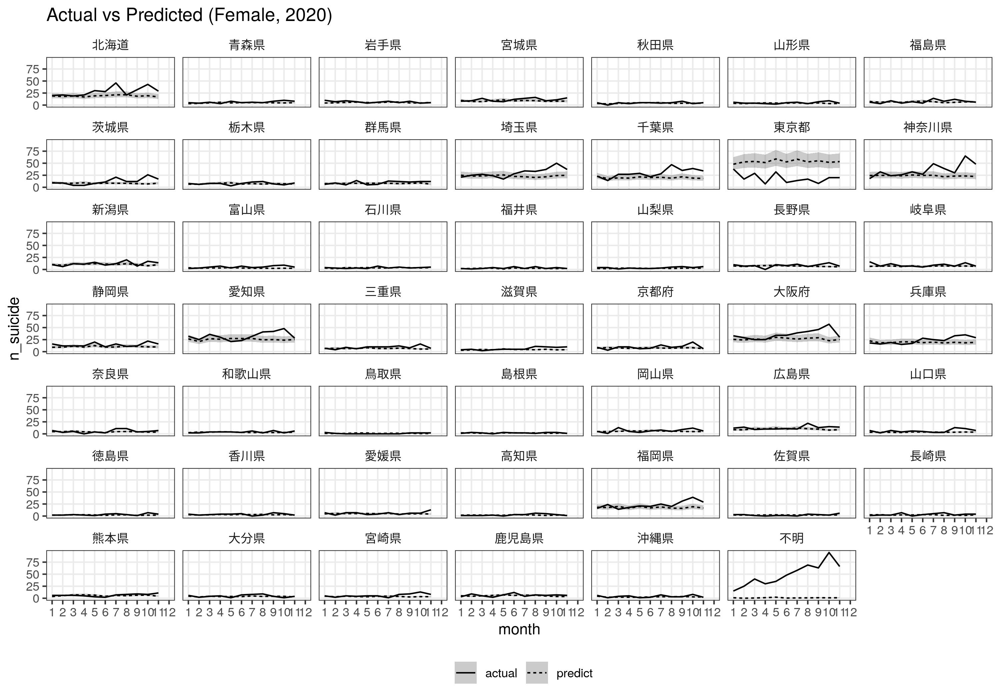

In [58]:
traindata <- filter(x, year %in% 2010:2019, sex=="female")
model <- lm(log(n_suicide+1) ~ factor(month)*geoname + year*geoname + time*geoname + geoname,
            data=traindata)
pred <- (predict(model) %>% exp()) - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$geoname) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(x, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-female-2020.png", width=10, height=7)


g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Female, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-female-2020-fixscale.png", width=10, height=7)

## MHLW data

saved to ggtmp/1612409283.jpg


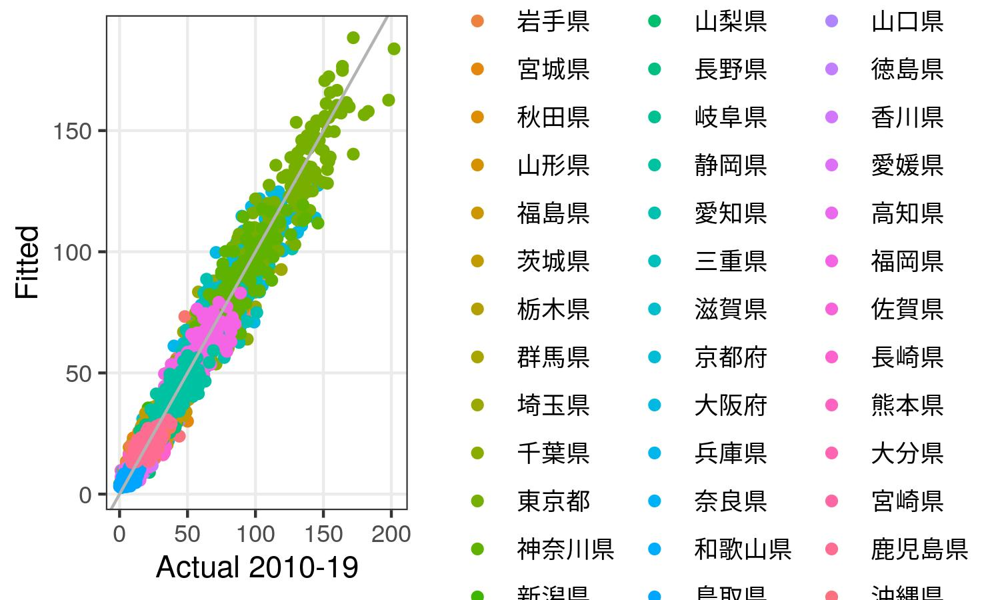

saved to ggtmp/1612409284.jpg


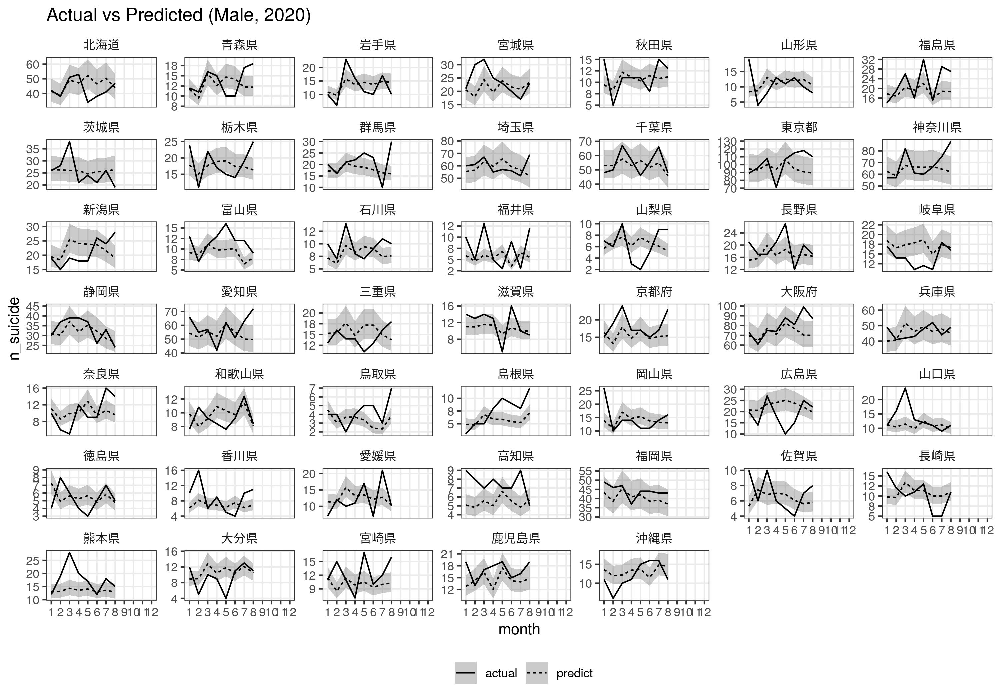

saved to ggtmp/1612409290.jpg


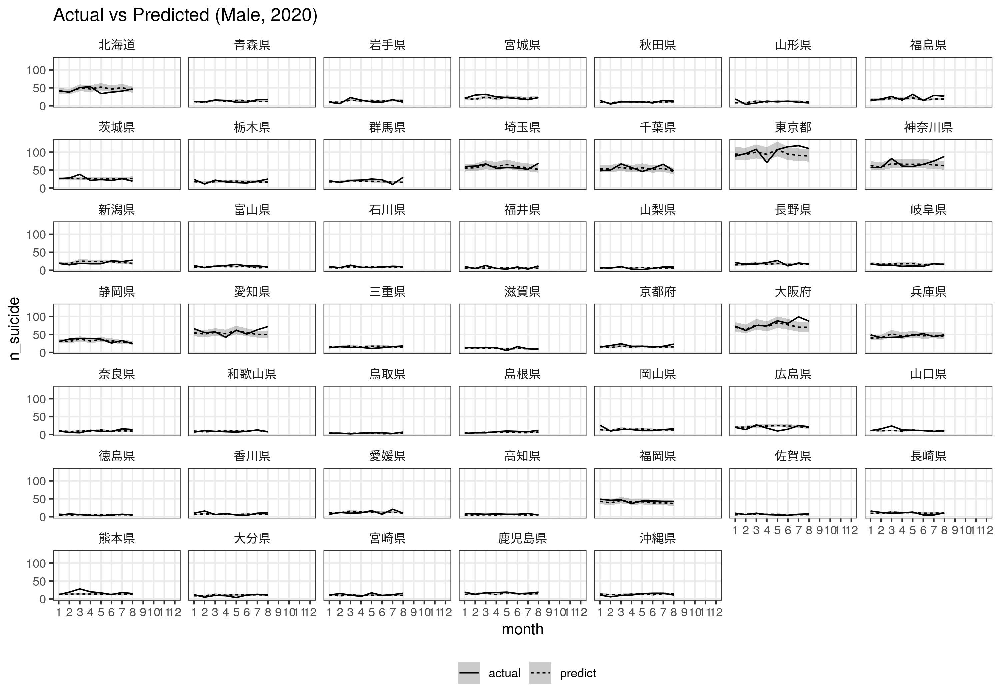

In [59]:
traindata <- filter(y, year %in% 2010:2019, sex=="male")
model <- lm(log(n_suicide+1) ~ factor(month)*geoname + year*geoname + time*geoname + geoname,
            data=traindata)
pred <- (predict(model) %>% exp()) - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$geoname) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(y, year==2020, sex=="male")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-male-mhlw-2020.png", width=7, height=5)


g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-male-mhlw-2020-fixscale.png", width=10, height=7)

saved to ggtmp/1612409296.jpg


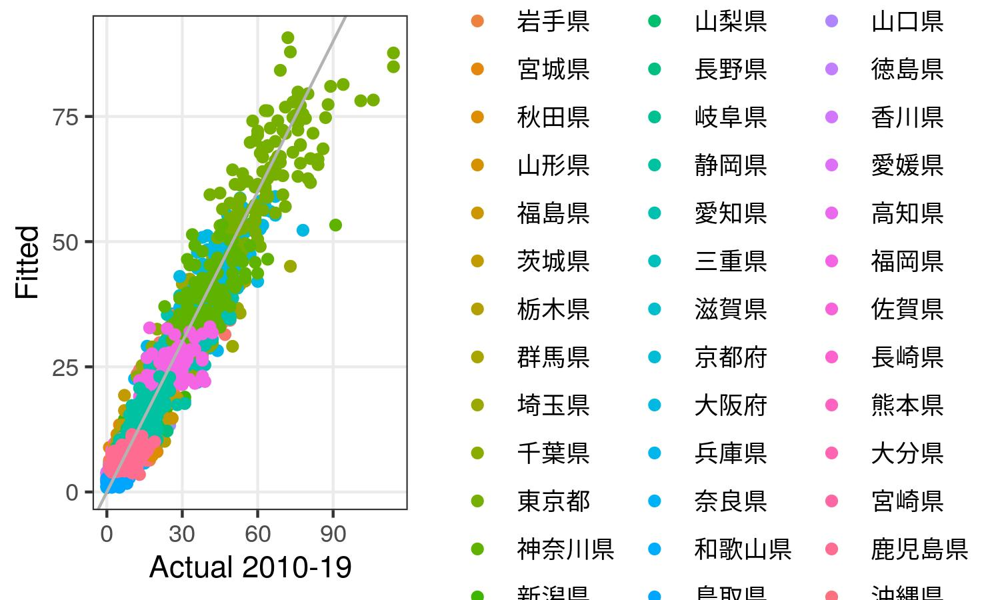

saved to ggtmp/1612409298.jpg


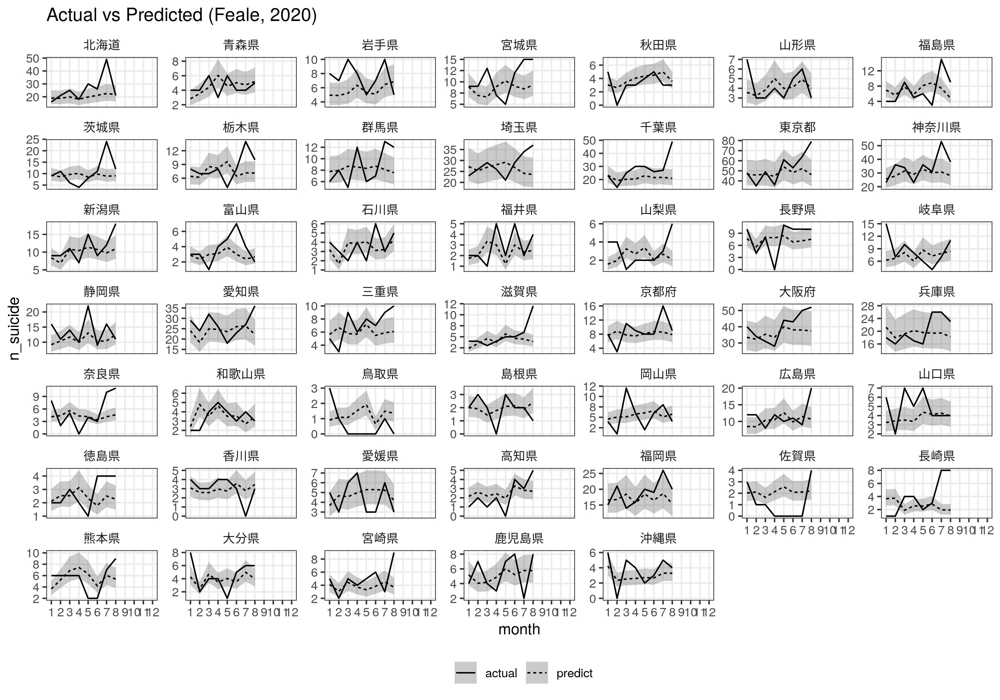

saved to ggtmp/1612409304.jpg


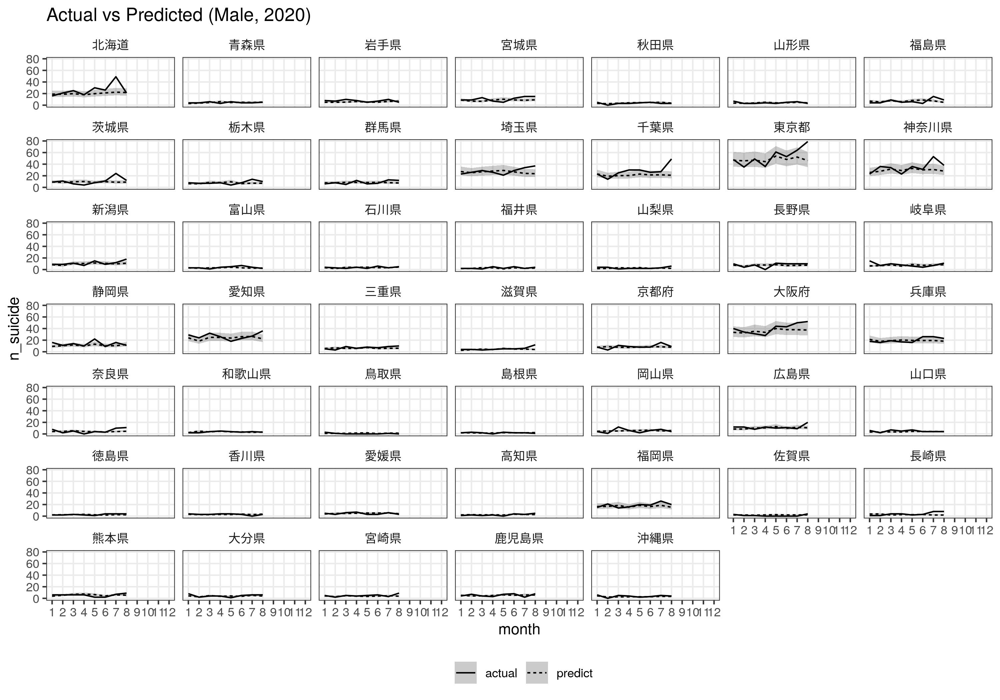

In [60]:
traindata <- filter(y, year %in% 2010:2019, sex=="female")
model <- lm(log(n_suicide+1) ~ factor(month)*geoname + year*geoname + time*geoname + geoname,
            data=traindata)
pred <- (predict(model) %>% exp()) - 1
g <- qplot(traindata$n_suicide, pred, color=traindata$geoname) +
  xlab("Actual 2010-19") + ylab("Fitted") +
  scale_x_continuous(labels=number_format()) +
  scale_y_continuous(labels=number_format()) +
  geom_abline(slope=1, intercept=0, color="gray70")
ggshow(g, 600, width=5, height=3)

w <- filter(y, year==2020, sex=="female")
pred <- predict(model, newdata=w, interval="confidence") %>% exp() %>% `-`(1)
ci <- cbind(w, pred)
w <- rbind(mutate(w, type="actual"), mutate(w, n_suicide=pred[,1], type="predict"))

g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname), scales="free_y") +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Feale, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-female-mhlw-2020.png", width=10, height=7)


g <- ggplot(w, aes(month, n_suicide, linetype=type)) +
  facet_wrap(vars(geoname)) +
  geom_ribbon(aes(ymin=lwr, ymax=upr, linetype=NULL), data=ci, alpha=0.25) +
  geom_line() +
  ggtitle("Actual vs Predicted (Male, 2020)") +
  scale_x_continuous(limits=c(1, 12), breaks=1:12) +
  scale_y_continuous(labels=number_format()) +
  theme(legend.position="bottom", legend.title=element_blank())
ggshow(g, 1200, width=10, height=7)
ggsave("outputs/actual-v-predicted-by-pref-female-mhlw-2020-fixscale.png", width=10, height=7)

In [61]:
head(x)
head(y)

time,year,month,sex,geocode,geoname,n_suicide
<date>,<int>,<int>,<chr>,<int>,<fct>,<dbl>
2009-01-01,2009,1,female,1,北海道,35
2009-01-01,2009,1,male,1,北海道,76
2009-01-01,2009,1,total,1,北海道,111
2009-02-01,2009,2,female,1,北海道,40
2009-02-01,2009,2,male,1,北海道,84
2009-02-01,2009,2,total,1,北海道,124


time,year,month,sex,geoname,n_suicide
<date>,<int>,<int>,<chr>,<fct>,<dbl>
2010-01-01,2010,1,female,三重県,4
2010-01-01,2010,1,male,三重県,17
2010-02-01,2010,2,female,三重県,15
2010-02-01,2010,2,male,三重県,14
2010-03-01,2010,3,female,三重県,9
2010-03-01,2010,3,male,三重県,22


Joining, by = c("time", "year", "month", "geoname", "sex")


time,year,month,geoname,sex,n_suicide,n_suicide_mhlw
<date>,<int>,<int>,<fct>,<chr>,<dbl>,<dbl>
2010-01-01,2010,1,北海道,female,30,24
2010-01-01,2010,1,北海道,male,75,65
2010-02-01,2010,2,北海道,female,35,32
2010-02-01,2010,2,北海道,male,72,65
2010-03-01,2010,3,北海道,female,42,36
2010-03-01,2010,3,北海道,male,100,98


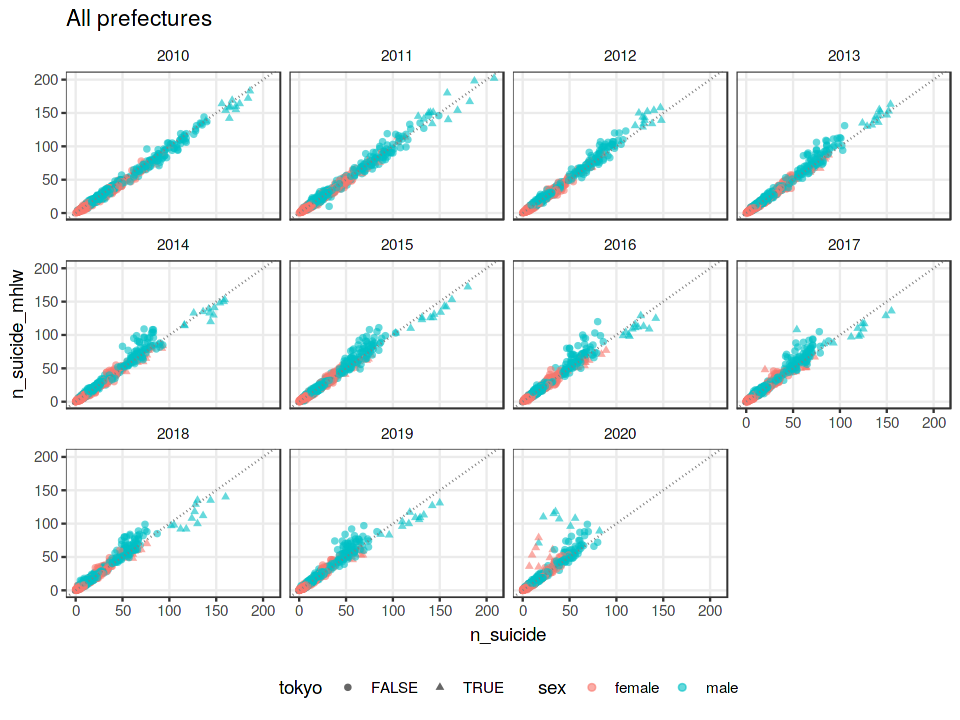

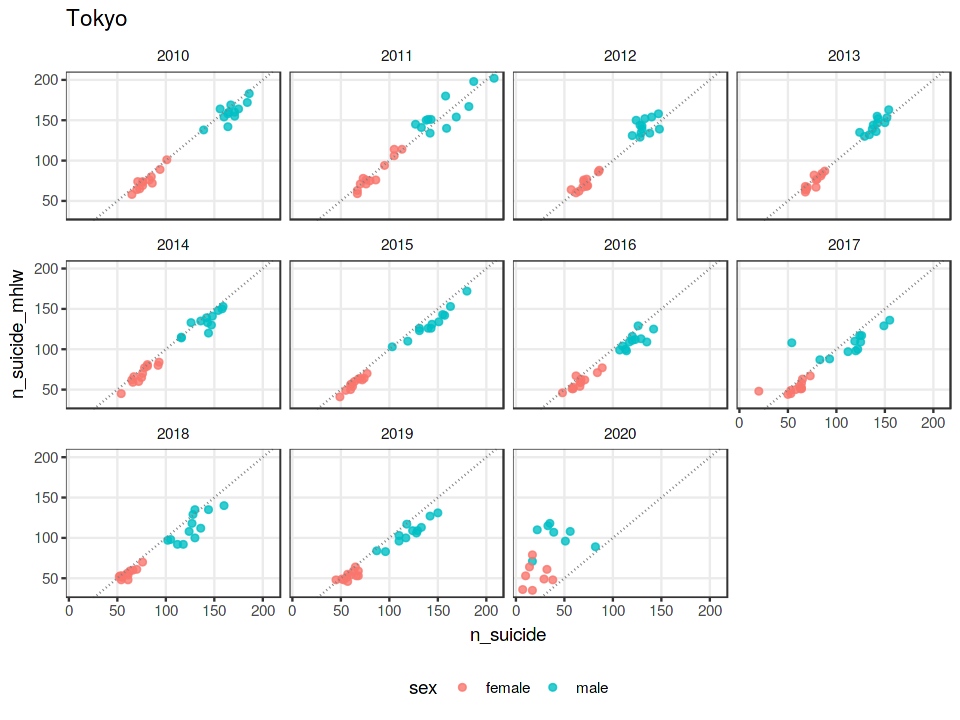

In [62]:
z <- select(x, time, year, month, geoname, sex, n_suicide) %>%
  inner_join(select(y, time, year, month, sex, geoname, n_suicide) %>% rename(n_suicide_mhlw=n_suicide))
head(z)

figsize(8, 6)
mutate(z, tokyo=geoname=="東京都") %>%
ggplot(aes(n_suicide, n_suicide_mhlw, shape=tokyo, color=sex)) +
  geom_point(alpha=0.6) +
  facet_wrap(vars(year)) +
  ggtitle("All prefectures") +
  geom_abline(slope=1, intercept=0, color="gray50", linetype="dotted") +
  theme(legend.position="bottom")
ggsave("outputs/npa-v-mhlw-pref.png", width=8, height=6)

filter(z, geoname=="東京都") %>%
ggplot(aes(n_suicide, n_suicide_mhlw, color=sex)) +
  geom_point(alpha=0.8) +
  facet_wrap(vars(year)) +
  ggtitle("Tokyo") +
  geom_abline(slope=1, intercept=0, color="gray50", linetype="dotted") +
  theme(legend.position="bottom")
ggsave("outputs/npa-v-mhlw-tokyo.png", width=8, height=6)